<a href="https://colab.research.google.com/github/sina973/Autoencoder-with-GAN/blob/main/Cifar10_Autoencoder_Recurrent.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import matplotlib.pyplot as plt # plotting library
import numpy as np # this module is useful to work with numerical arrays
import pandas as pd
import random
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader,random_split
from torch import nn
import torch.nn.functional as F
import torch.optim as optim

# convert data to torch.FloatTensor
transform = transforms.ToTensor()

# load the training and test datasets
train_data = torchvision.datasets.CIFAR10(root='data', train=True, download=True, transform=transform)
test_data = torchvision.datasets.CIFAR10(root='data', train=False, download=True, transform=transform)


# Create training and test dataloaders
num_workers = 0
# how many samples per batch to load
batch_size = 15000
batch_size_test = 5000
# prepare data loaders
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size, num_workers=num_workers, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size_test, num_workers=num_workers, shuffle=True)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting data/cifar-10-python.tar.gz to data
Files already downloaded and verified


In [ ]:
class AutoEncoder(nn.Module):

    def __init__(self, encoded_space_dim, recursive_steps):
        super().__init__()
        self.recursive_steps = recursive_steps
        ########################### ENCODER ############################################
        ### Convolutional section
        self.encoder_cnn = nn.Sequential(                       ## Input dimension is 3 * 32 * 32
            nn.Conv2d(3, 8, 5, stride=1, padding=2),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 8 * 32 * 32
            nn.Conv2d(8, 8, 3, stride=1, padding=1),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 8 * 32 * 32
            nn.Conv2d(8, 16, 4, stride=2, padding=1),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 16 * 16 * 16
            nn.BatchNorm2d(16),
            # nn.ReLU(True),
            nn.Conv2d(16, 16, 3, stride=1, padding=1),           ## The output dimension of this layer will be 16 * 16 * 16
            nn.ReLU(True),
            nn.Conv2d(16, 32, 4, stride=2, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True),
            nn.Conv2d(32, 32, 3, stride=1, padding=1),          ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True),
            # nn.Conv2d(32, 32, 3, stride=1, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            # nn.ReLU(True),
            # nn.Conv2d(32, 32, 3, stride=1, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            # nn.ReLU(True),
            nn.Conv2d(32, 32, 3, stride=1, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True)
            # nn.Conv2d(64, 64, 5, stride=1, padding=2),          ## The output dimension of this layer will be 64 * 4 * 4
            # nn.ReLU(True),
            # # nn.MaxPool2d(2, stride=2),                          ## The output dimension of this layer will be 32 * 8 * 8 -----> Temporary inactive
            # nn.Conv2d(64, 64, 5, stride=1, padding=2),
            # nn.ReLU(True),                                      ## The output dimension of this layer will be 64 * 4 * 4
            # nn.MaxPool2d(2, stride=2)
        )

        ########################### DECODER ############################################

        self.decoder_conv = nn.Sequential(
            # nn.ConvTranspose2d(64, 32, 3,
            # stride=2, padding = 1, output_padding=1),
            # nn.BatchNorm2d(32),                                 ## The output dimension of this layer will be 32 * 8 * 8
            # nn.ReLU(True),
            nn.ConvTranspose2d(32, 32, 3, stride=1,
            padding=1, output_padding=0),
            nn.BatchNorm2d(32),                                 ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True),
            nn.ConvTranspose2d(32, 16, 3, stride=2,
            padding=1, output_padding=1),                       ## The output dimension of this layer will be 16 * 16 * 16
            # nn.BatchNorm2d(16),
            nn.ReLU(True),
            nn.ConvTranspose2d(16, 16, 3, stride=1,
            padding=1, output_padding=0),
            # nn.ReLU(True),                     ## The output dimension of this layer will be 16 * 16 * 16
            # nn.ConvTranspose2d(16, 16, 3, stride=1,
            # padding=1, output_padding=0),
            nn.ReLU(True),                     ## The output dimension of this layer will be 16 * 16 * 16
            nn.ConvTranspose2d(16, 8, 3,
            stride=2, padding = 1, output_padding=1),
            # nn.BatchNorm2d(8),                                 ## The output dimension of this layer will be 8 * 32 * 32
            nn.ReLU(True),
            nn.ConvTranspose2d(8, 8, 3, stride=1,
            padding=1, output_padding=0),
            # nn.BatchNorm2d(16),
            # nn.ReLU(True),                              ## The output dimension of this layer will be 8 * 32 * 32
            # nn.ConvTranspose2d(8, 8, 3, stride=1,
            # padding=1, output_padding=0),
            # nn.BatchNorm2d(16),                                 ## The output dimension of this layer will be 8 * 32 * 32
            nn.ReLU(True),
            nn.ConvTranspose2d(8, 3, 3, stride=1,
            padding=1, output_padding=0),                       ## The output dimension of this layer will be 3 * 32 * 32
            nn.BatchNorm2d(3),
            nn.ReLU(True),
            nn.ConvTranspose2d(3, 3, 3, stride=1,               ## The output dimension of this layer will be 3 * 32 * 32
            padding=1, output_padding=0)
            # nn.MaxPool2d(2, stride=2)
        )

    def forward(self, x, recursive_steps):
        for i in range(recursive_steps):
            x = self.encoder_cnn(x)
            x = self.decoder_conv(x)
            x = torch.sigmoid(x)
        return x

In [ ]:
### Define the loss function
# loss_fn = torch.nn.MSELoss()
loss_fn = torch.nn.BCELoss()

### Define an optimizer (both for the encoder and the decoder!)
lr= 0.005

### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
d = 16

#model = Autoencoder(encoded_space_dim=encoded_space_dim)
autoencoder_1 = AutoEncoder(encoded_space_dim=d, recursive_steps=2)


params_to_optimize_1 = [{'params': autoencoder_1.parameters()}]


optimizer_1 = torch.optim.Adam(params_to_optimize_1, lr=lr, weight_decay=1e-05)



# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Move both the encoder and the decoder to the selected device
autoencoder_1.to(device)

Selected device: cuda


AutoEncoder(
  (encoder_cnn): Sequential(
    (0): Conv2d(3, 8, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): Conv2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): Conv2d(8, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (5): ReLU(inplace=True)
    (6): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): ReLU(inplace=True)
    (11): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (12): ReLU(inplace=True)
    (13): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (14): ReLU(inplace=True)
  )
  (decoder_conv): Sequential(
    (0): ConvTranspose2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1

In [ ]:
import random

### Training function
def train_epoch(autoencoder_1 , device, dataloader, loss_fn, optimizer,noise_factor=0.3):
    # Set train mode for both the encoder and the decoder
    autoencoder_1.train()
    train_loss = []
    # autoEncoders[i].load_state_dict(autoEncoders[0].state_dict()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    count = int(((random.random()*30) // 10) + 1)
    loss = 0
    for image_batch, _ in dataloader: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        count += 1
        temp_rec_step = 0
        if (count % 3) == 0:
           temp_rec_step = 3
        else:
          temp_rec_step = (count % 3)

        reconstructed_data = autoencoder_1(image_batch, temp_rec_step)
        # temp_img = reconstructed_data

        # Evaluate loss
        loss = loss_fn(reconstructed_data, image_batch)
        # Backward pass
        optimizer.zero_grad()
        # loss.requires_grad=True
        loss.backward()  # retain_graph=True)
        optimizer.step()
        # Print batch loss
        # print('\t partial train loss (single batch): %f' % (loss.data))

        train_loss.append(loss.detach().cpu().numpy())

    return np.mean(train_loss)

In [ ]:
### Testing function
import numpy as np
test_array = np.zeros((256,3,32,32))
test_reconstructed_array = np.zeros((256,3,32,32))

def test_epoch(autoencoder_1, device, dataloader, loss_fn):
    # Set evaluation mode for encoder and decoder
    autoencoder_1.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        conc_out = []
        conc_label = []
        for image_batch, _ in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            # Encode data
            decoded_data = autoencoder_1(image_batch,1)
            conc_out.append(decoded_data.cpu())
            conc_label.append(image_batch.cpu())
            # print(image_batch.detach().cpu().numpy())
            # print(image_batch.detach().cpu().numpy().shape)
            np.append(test_array, image_batch.detach().cpu().numpy(), axis=0)
            np.append(test_reconstructed_array, decoded_data.detach().cpu().numpy(), axis=0)
        # Create a single tensor with all the values in the lists
        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)
        # Evaluate global loss
        val_loss = loss_fn(conc_out, conc_label)
    return val_loss.data

In [ ]:
def plot_ae_outputs(autoencoder_1,n=20):
    img = []
    rec_img = []
    autoencoder_1.eval()
    for i in range(n):
      img.append(test_data[i][0].unsqueeze(0).to(device))
      with torch.no_grad():
         rec_img.append(autoencoder_1(img[i],1))
      img[i] = img[i].cpu().squeeze().numpy()
      rec_img[i] = rec_img[i].cpu().squeeze().numpy()
    # plot the first ten input images and then reconstructed images
    fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(24,4))
    for idx in np.arange(20):
          ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
          plt.imshow(np.transpose(img[idx], (1, 2, 0)))
          ax.set_title("Original")

    # plot the first ten input images and then reconstructed images
    fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(24,4))
    for idx in np.arange(20):
          ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
          plt.imshow(np.transpose(rec_img[idx], (1, 2, 0)))
          ax.set_title("Recunstructed")
    plt.show()

In [ ]:
def plot_ae_outputs2(encoder,decoder,n=5):
    plt.figure(figsize=(10,4.5))
    for i in range(n):
      ax = plt.subplot(2,n,i+1)
      img = test_dataset[i][0].unsqueeze(0).to(device)
      encoder.eval()
      decoder.eval()
      with torch.no_grad():
         rec_img  = decoder(encoder(img))
      plt.imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
        ax.set_title('Original images')
      ax = plt.subplot(2, n, i + 1 + n)
      plt.imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
         ax.set_title('Reconstructed images')
    plt.show()


 EPOCH 1/150 	 train loss 0.702613353729248 	 val loss 0.6934185028076172


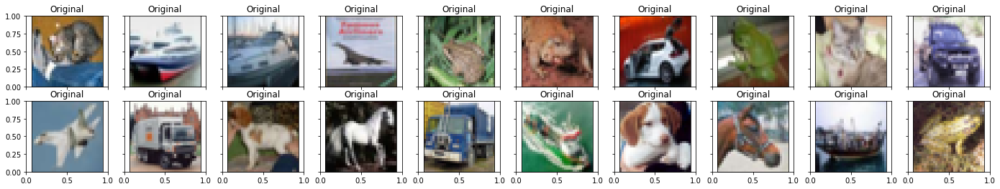

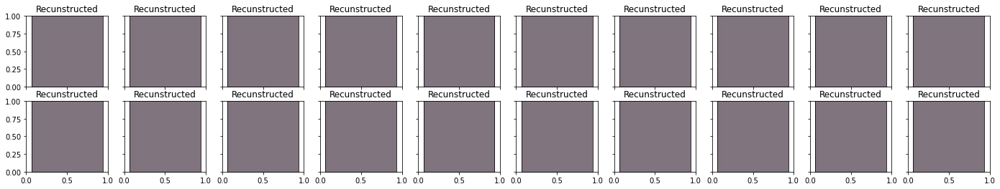


 EPOCH 2/150 	 train loss 0.6927193999290466 	 val loss 0.6923498511314392


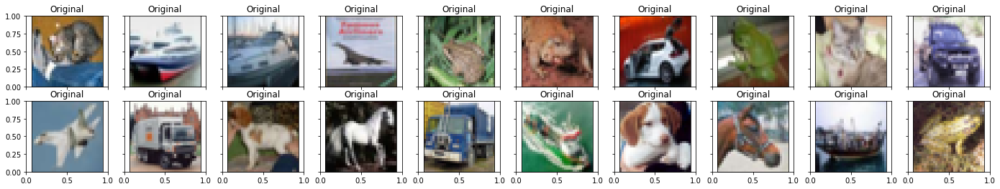

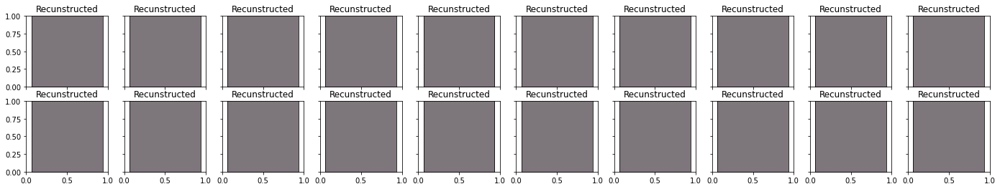


 EPOCH 3/150 	 train loss 0.6914609670639038 	 val loss 0.6917552351951599


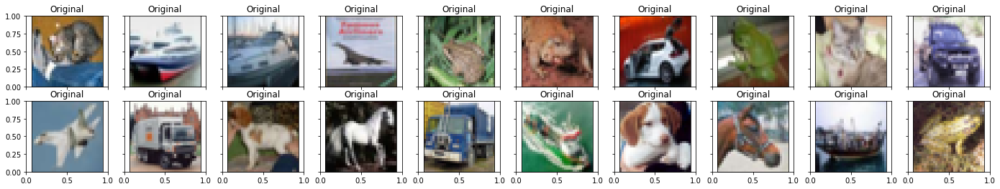

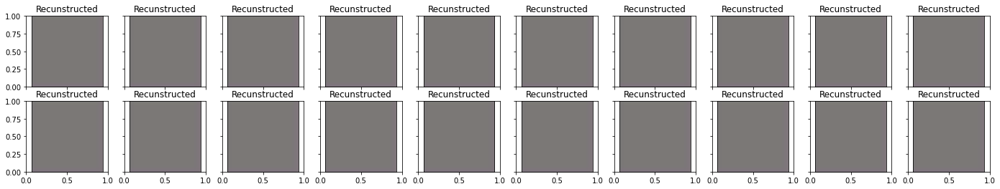


 EPOCH 4/150 	 train loss 0.6911831498146057 	 val loss 0.6916043162345886


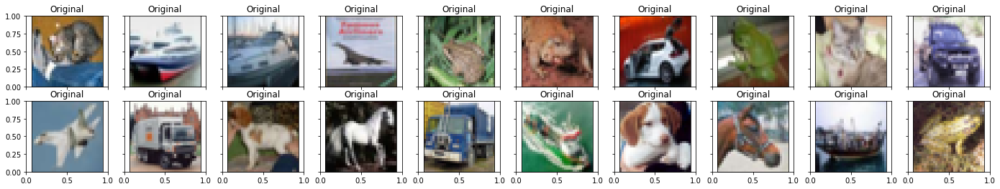

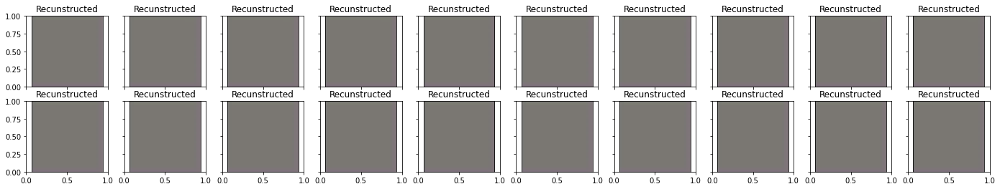


 EPOCH 5/150 	 train loss 0.6910454034805298 	 val loss 0.6915699243545532


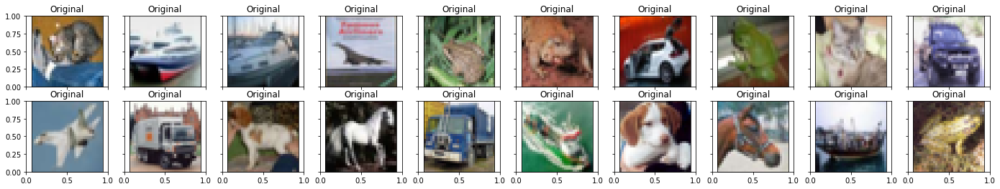

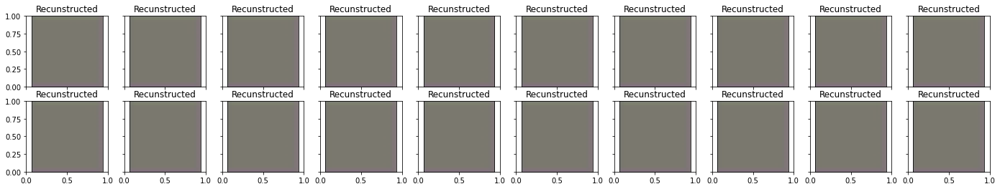


 EPOCH 6/150 	 train loss 0.6908560395240784 	 val loss 0.6917600035667419


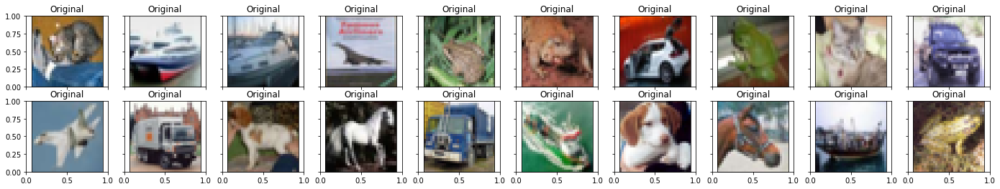

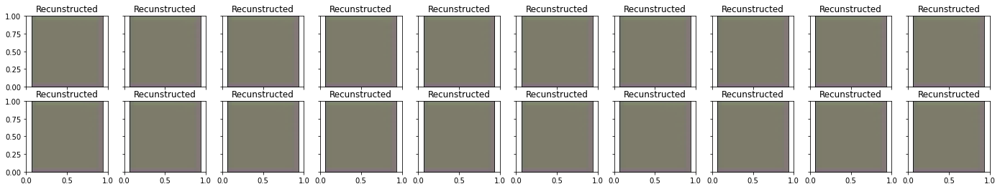


 EPOCH 7/150 	 train loss 0.6906964182853699 	 val loss 0.6933302283287048


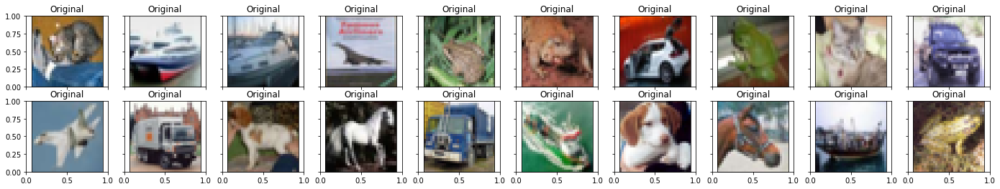

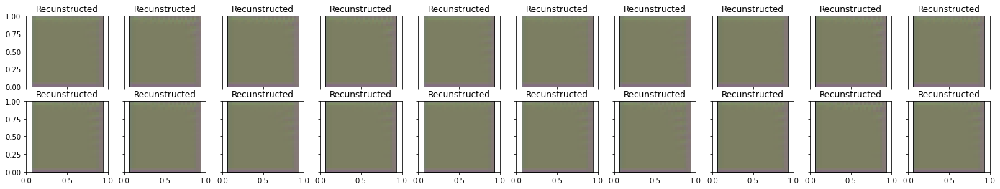


 EPOCH 8/150 	 train loss 0.6904619336128235 	 val loss 0.6965411305427551


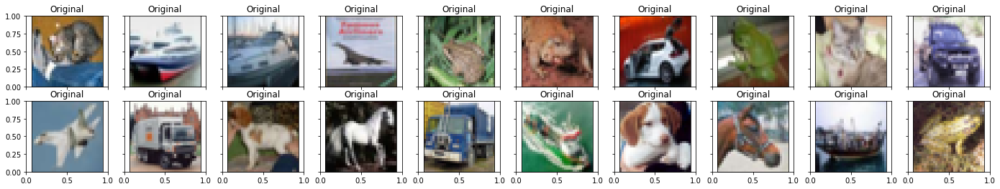

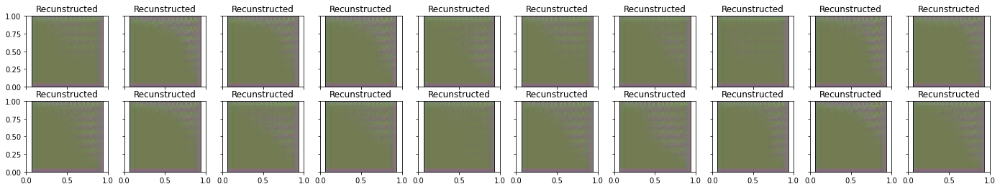


 EPOCH 9/150 	 train loss 0.6873293519020081 	 val loss 0.677908182144165


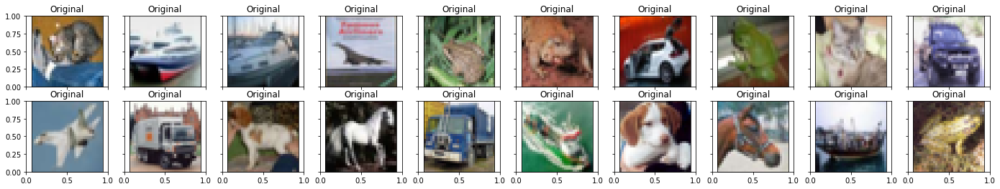

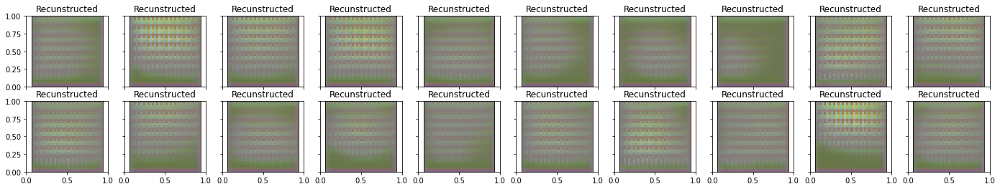


 EPOCH 10/150 	 train loss 0.6689119338989258 	 val loss 1.0315486192703247


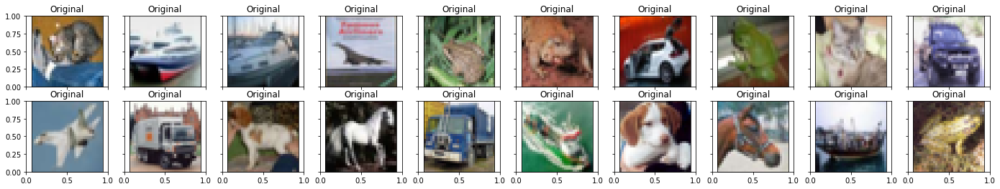

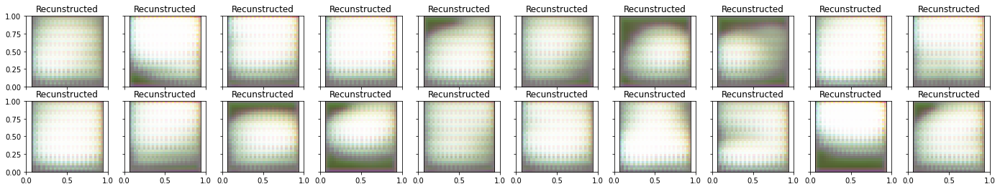


 EPOCH 11/150 	 train loss 0.65141761302948 	 val loss 1.0022414922714233


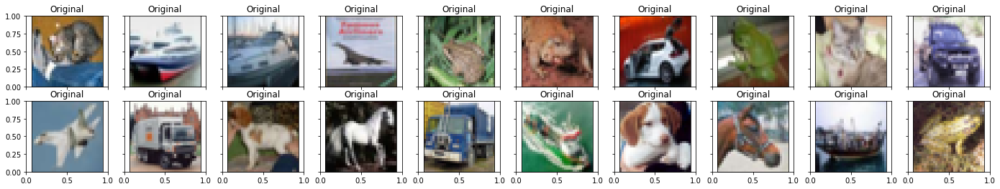

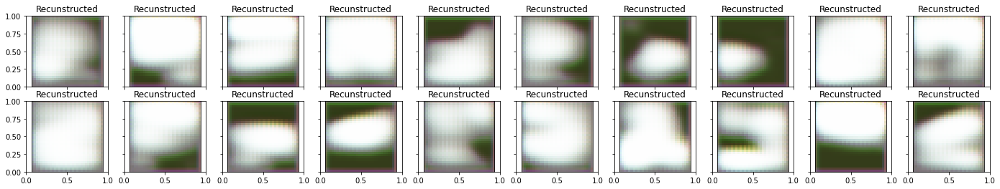


 EPOCH 12/150 	 train loss 0.6461861729621887 	 val loss 0.6920046806335449


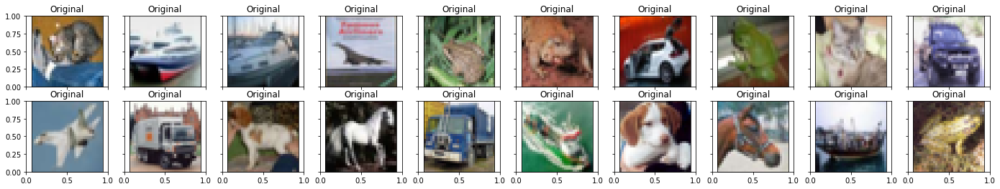

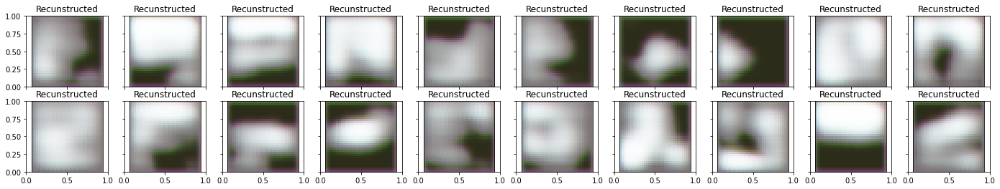


 EPOCH 13/150 	 train loss 0.6362836956977844 	 val loss 0.7816710472106934


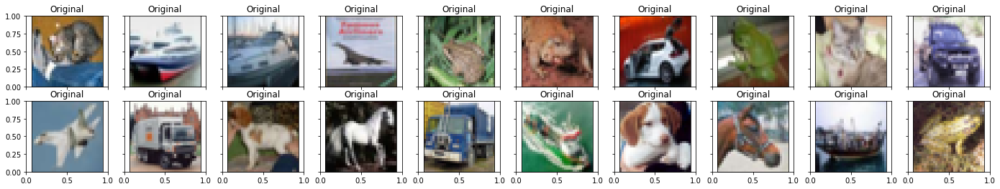

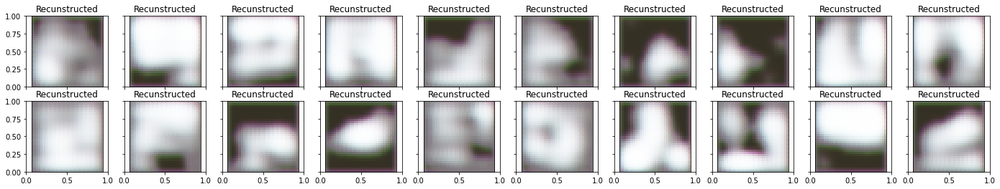


 EPOCH 14/150 	 train loss 0.6452745795249939 	 val loss 0.6453074216842651


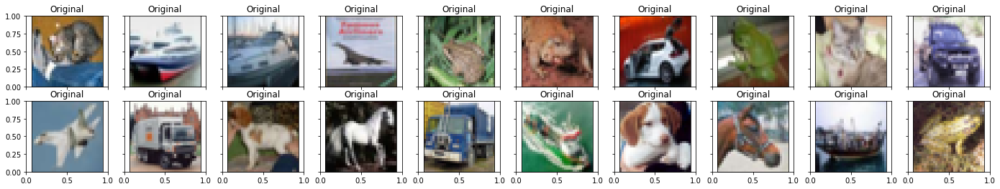

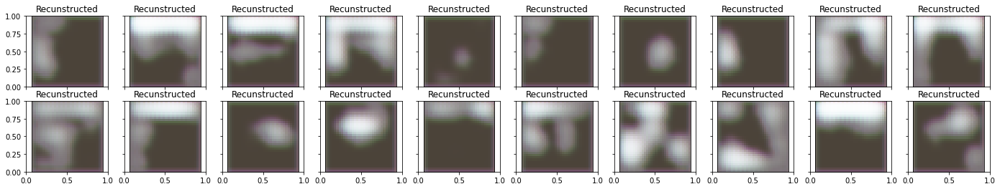


 EPOCH 15/150 	 train loss 0.641215443611145 	 val loss 0.6736419200897217


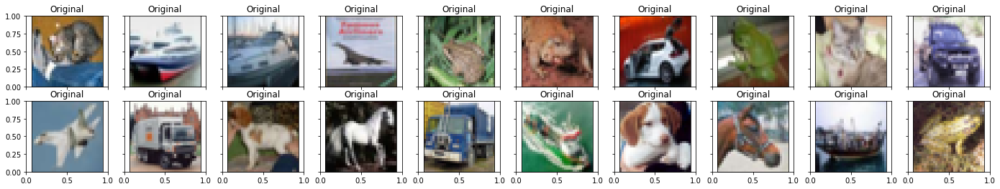

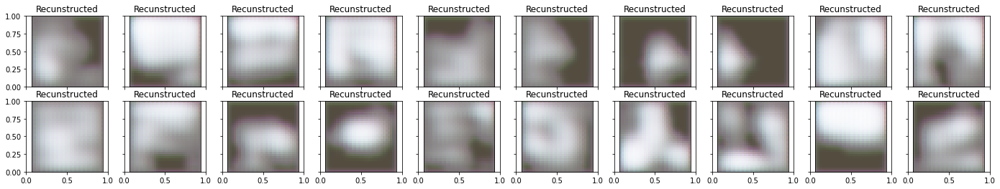


 EPOCH 16/150 	 train loss 0.6327971816062927 	 val loss 0.6854600310325623


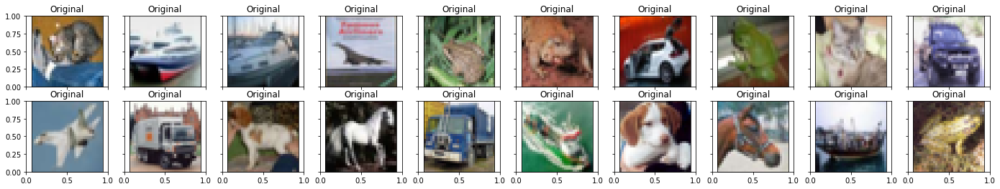

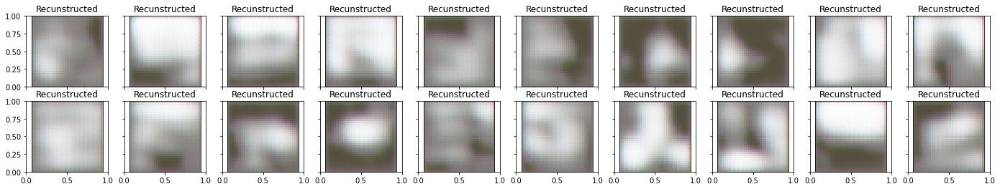


 EPOCH 17/150 	 train loss 0.6219680309295654 	 val loss 0.7018622159957886


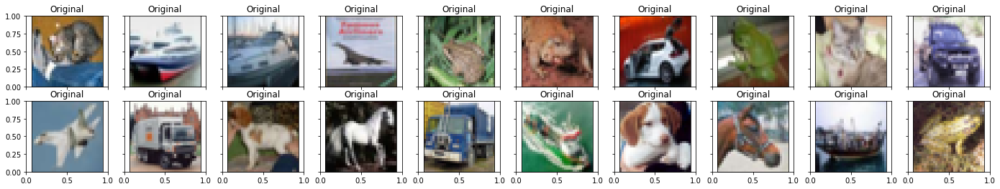

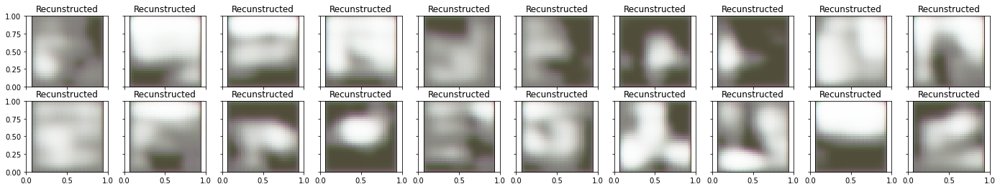


 EPOCH 18/150 	 train loss 0.6175655722618103 	 val loss 0.6566173434257507


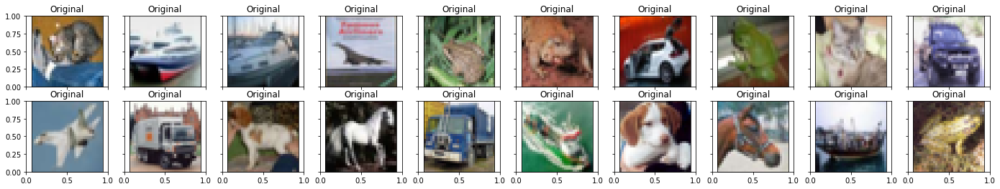

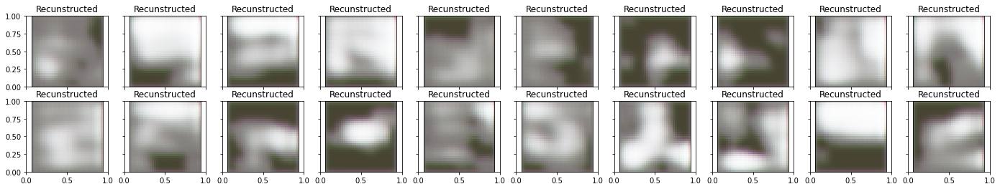


 EPOCH 19/150 	 train loss 0.6195892095565796 	 val loss 0.6688471436500549


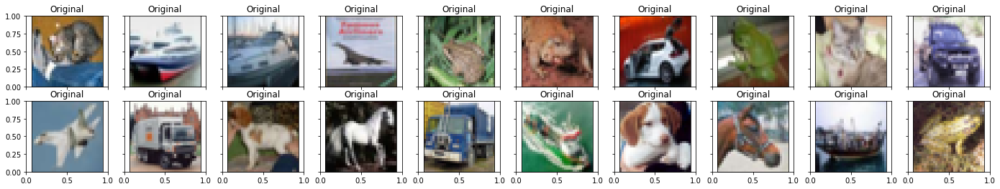

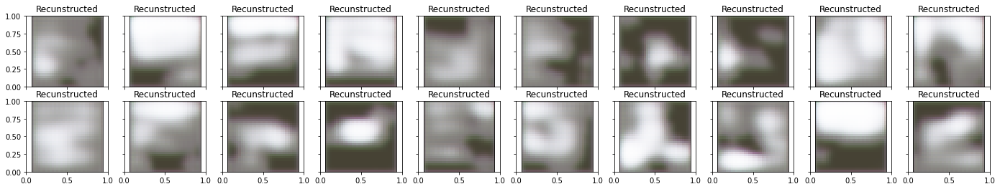


 EPOCH 20/150 	 train loss 0.6151828169822693 	 val loss 0.6192514300346375


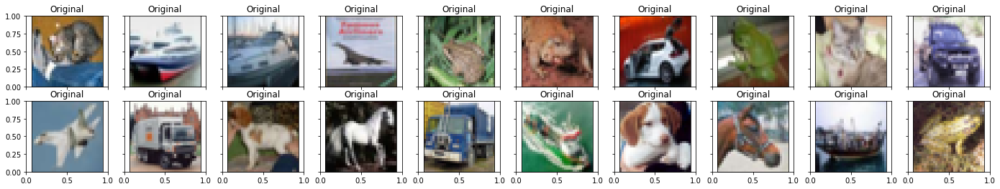

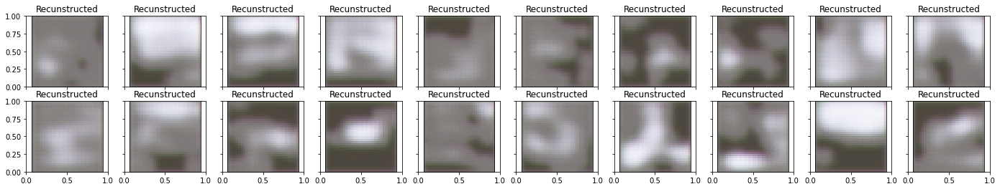


 EPOCH 21/150 	 train loss 0.6161260008811951 	 val loss 0.6165669560432434


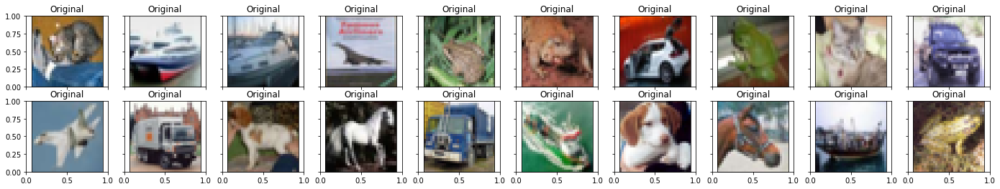

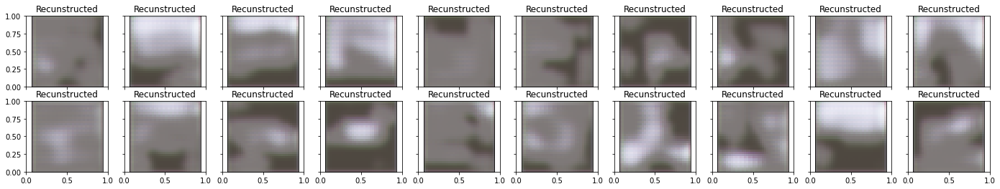


 EPOCH 22/150 	 train loss 0.6111168265342712 	 val loss 0.6268777251243591


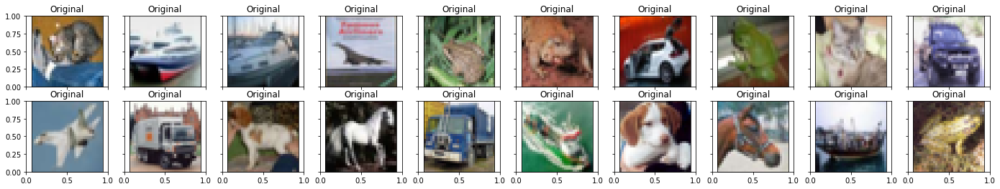

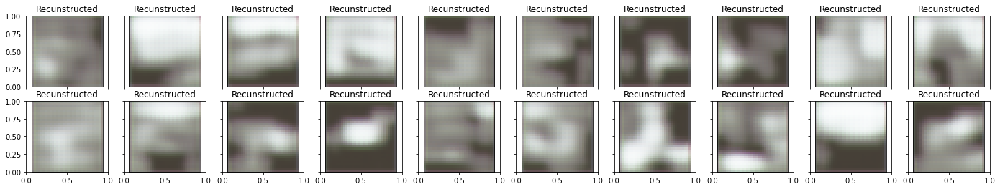


 EPOCH 23/150 	 train loss 0.6070276498794556 	 val loss 0.6177796125411987


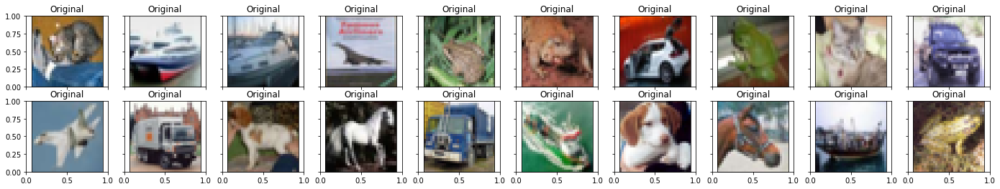

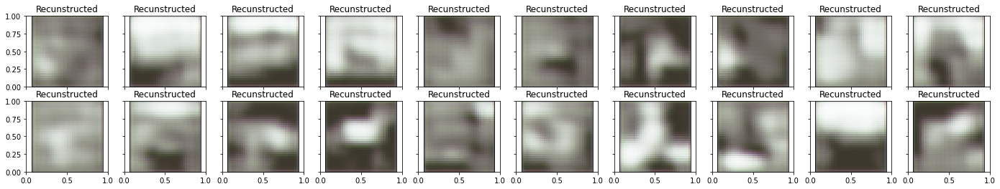


 EPOCH 24/150 	 train loss 0.6082601547241211 	 val loss 0.6049277186393738


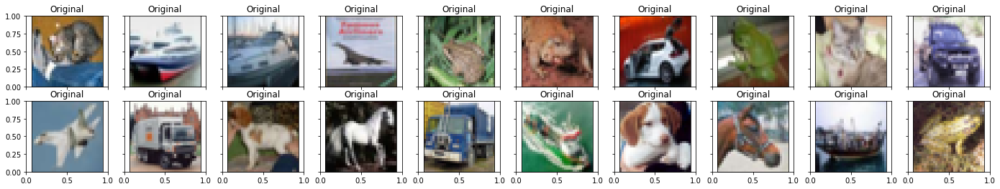

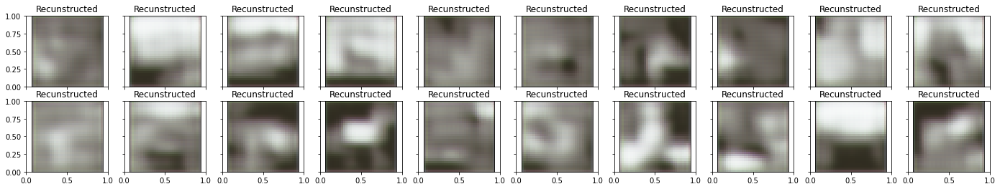


 EPOCH 25/150 	 train loss 0.6028679013252258 	 val loss 0.6178401112556458


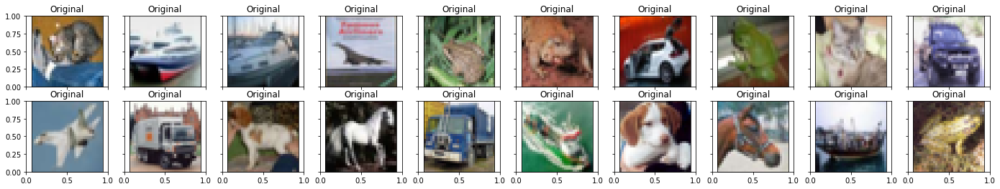

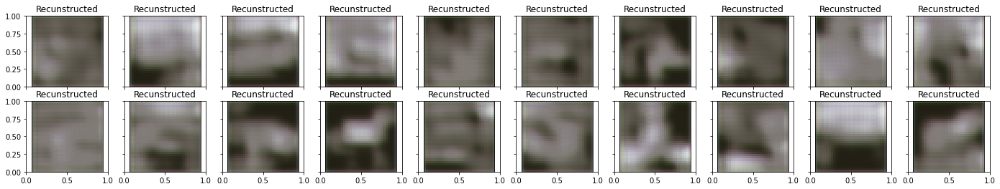


 EPOCH 26/150 	 train loss 0.6081307530403137 	 val loss 0.6185929775238037


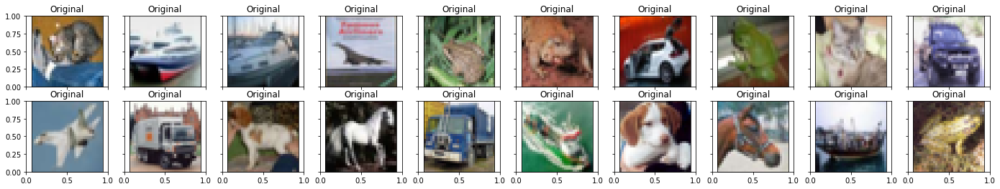

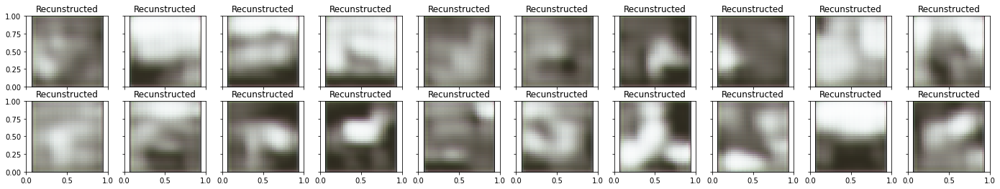


 EPOCH 27/150 	 train loss 0.6014403700828552 	 val loss 0.622042179107666


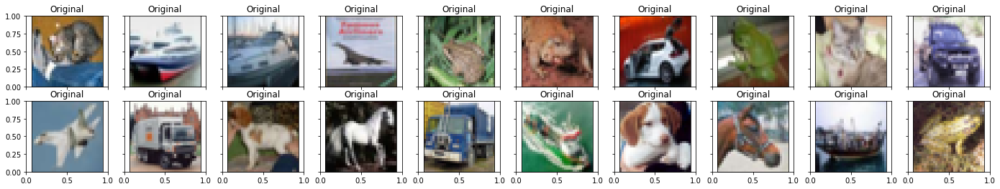

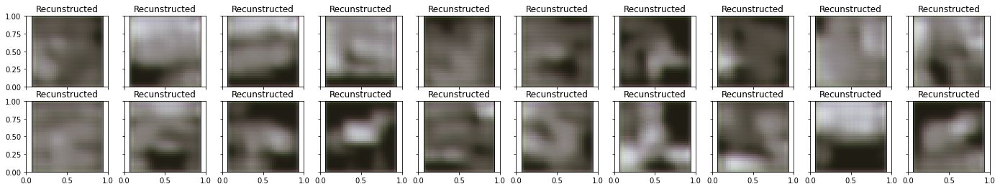


 EPOCH 28/150 	 train loss 0.6033353209495544 	 val loss 0.6422792673110962


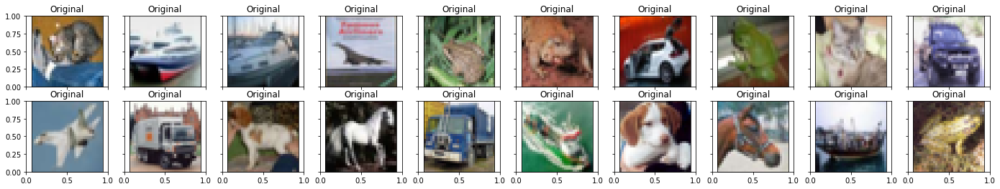

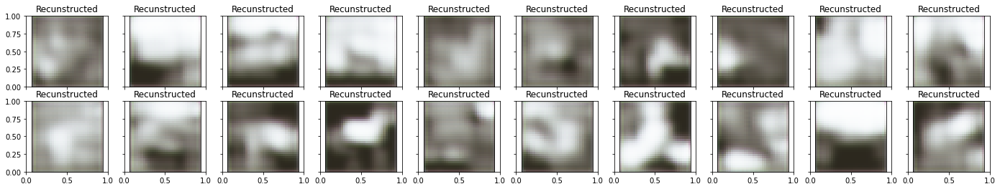


 EPOCH 29/150 	 train loss 0.6112922430038452 	 val loss 0.6299187541007996


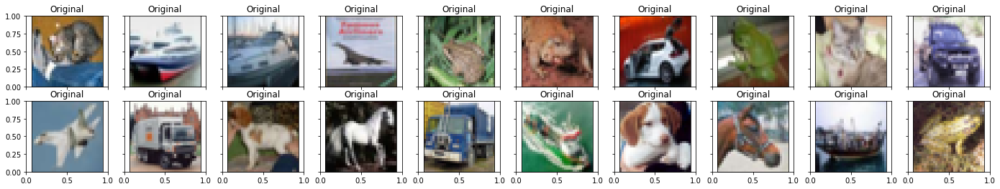

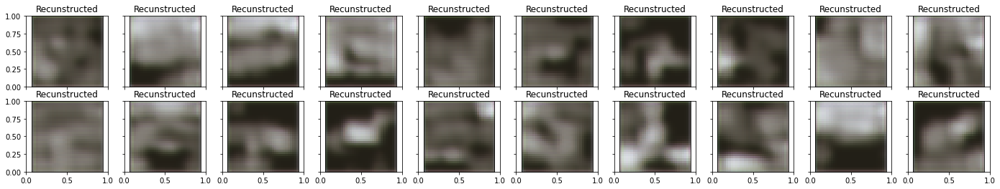


 EPOCH 30/150 	 train loss 0.6222215890884399 	 val loss 0.6069562435150146


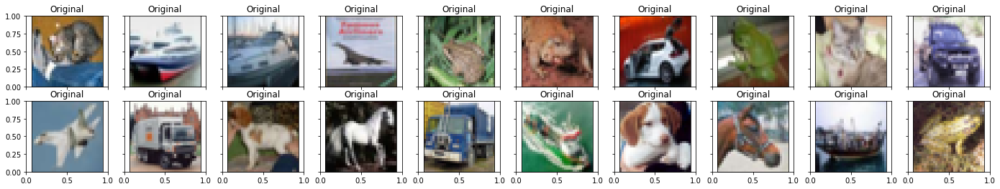

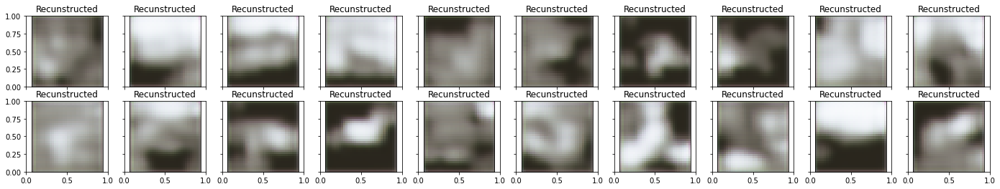


 EPOCH 31/150 	 train loss 0.6227349042892456 	 val loss 0.6179941296577454


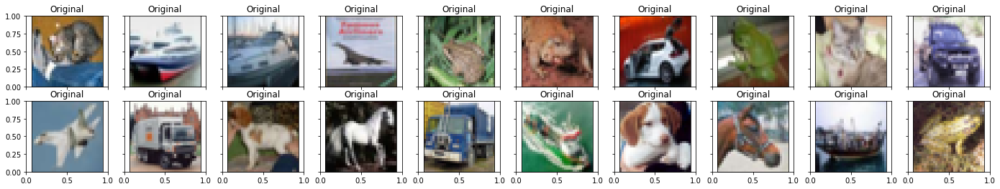

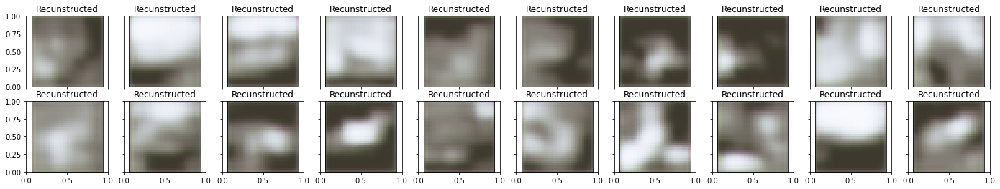


 EPOCH 32/150 	 train loss 0.618938684463501 	 val loss 0.6065391898155212


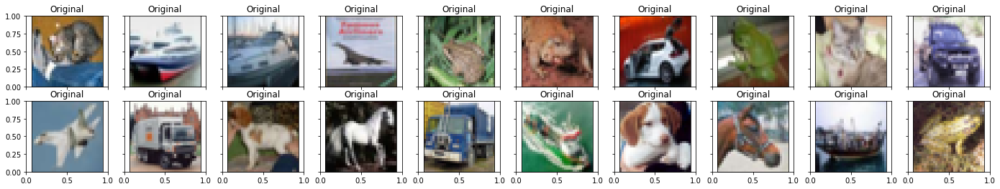

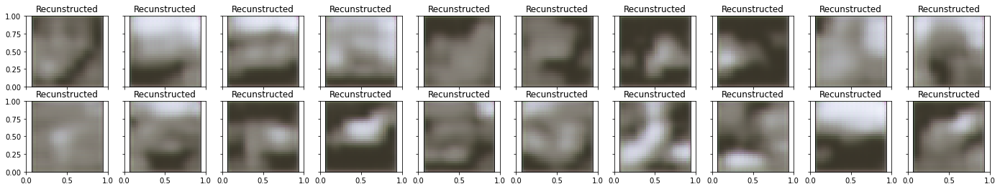


 EPOCH 33/150 	 train loss 0.6131032109260559 	 val loss 0.6016974449157715


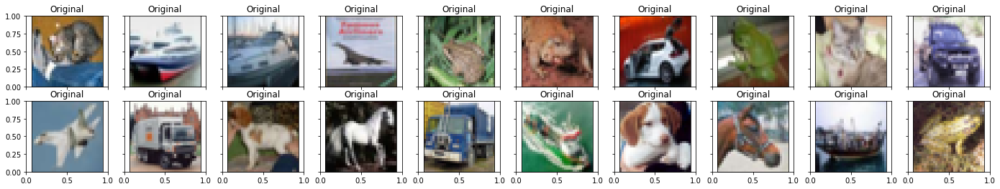

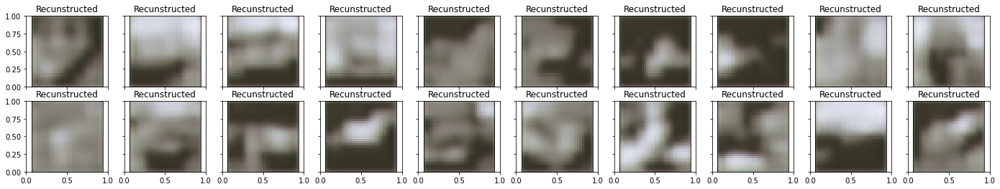


 EPOCH 34/150 	 train loss 0.6101014018058777 	 val loss 0.6172456741333008


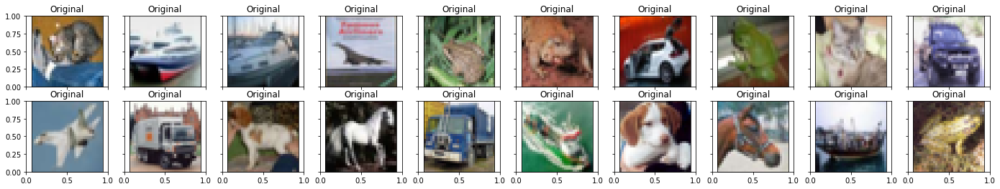

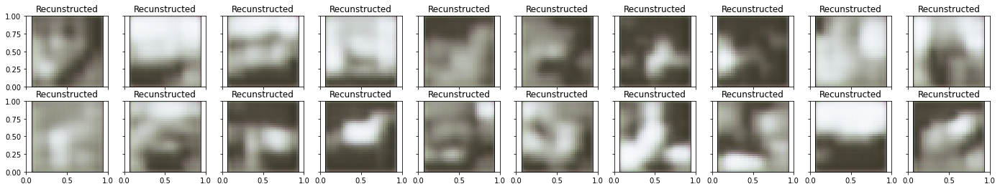


 EPOCH 35/150 	 train loss 0.6070343255996704 	 val loss 0.6052692532539368


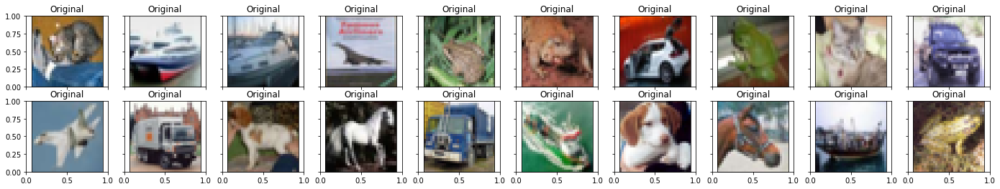

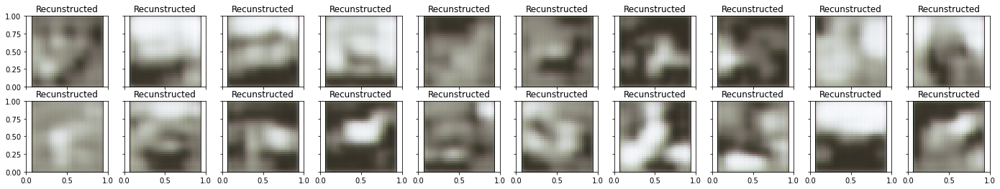


 EPOCH 36/150 	 train loss 0.6005504727363586 	 val loss 0.6211169362068176


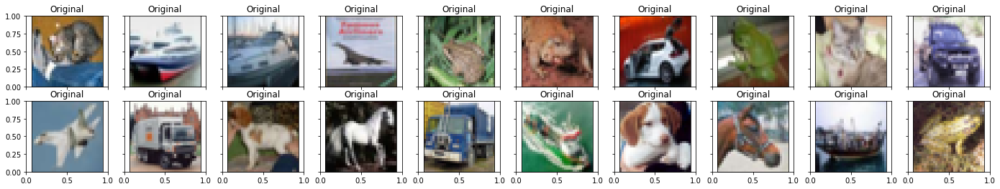

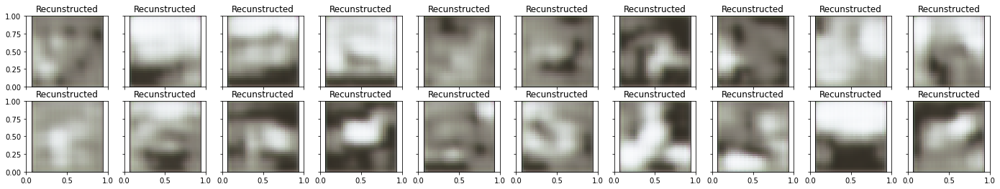


 EPOCH 37/150 	 train loss 0.5990869402885437 	 val loss 0.6015506386756897


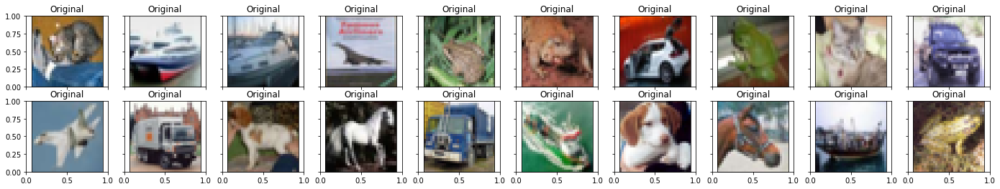

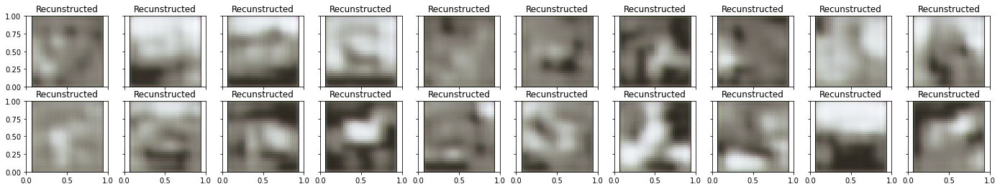


 EPOCH 38/150 	 train loss 0.5985349416732788 	 val loss 0.5987356901168823


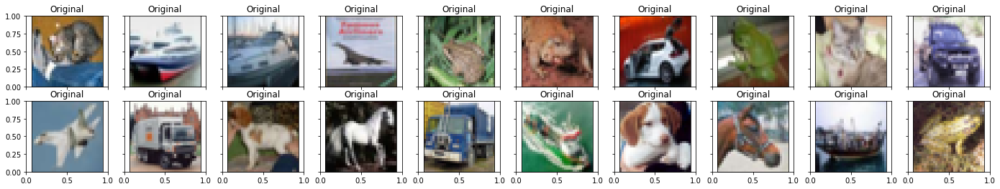

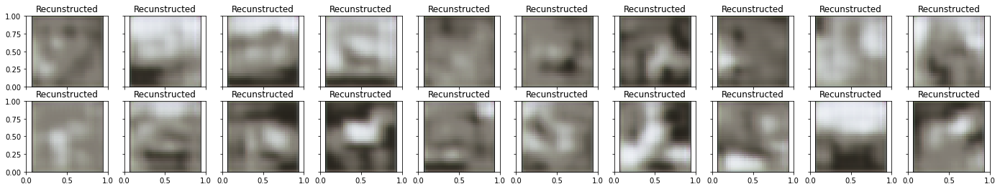


 EPOCH 39/150 	 train loss 0.597091019153595 	 val loss 0.5954121351242065


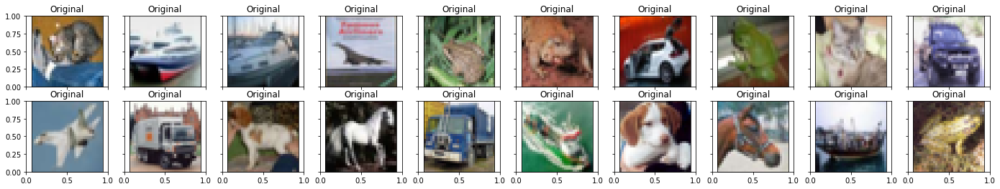

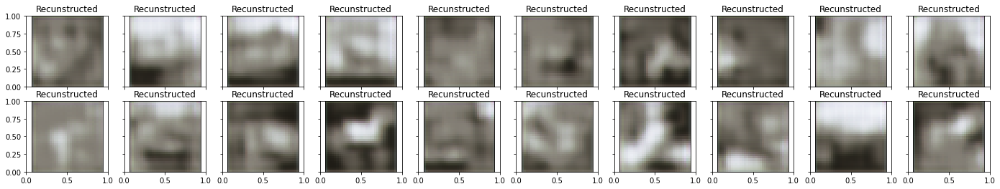


 EPOCH 40/150 	 train loss 0.5967044830322266 	 val loss 0.5924291610717773


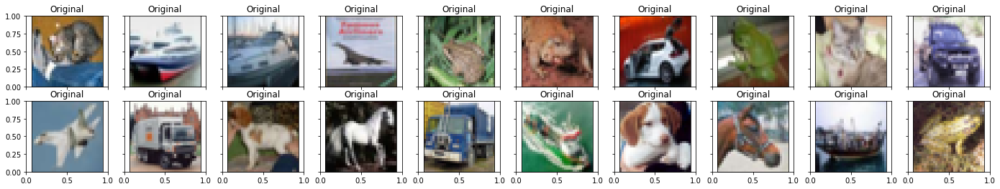

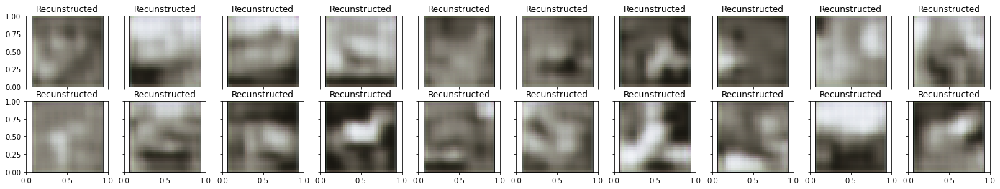


 EPOCH 41/150 	 train loss 0.5958912968635559 	 val loss 0.5907126069068909


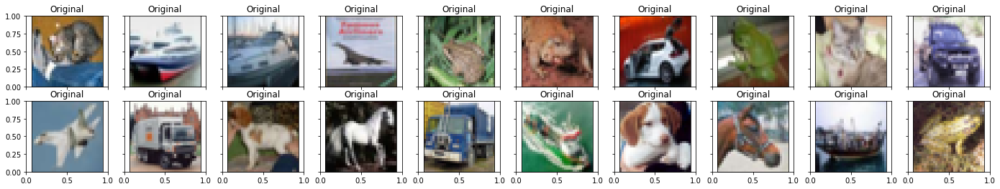

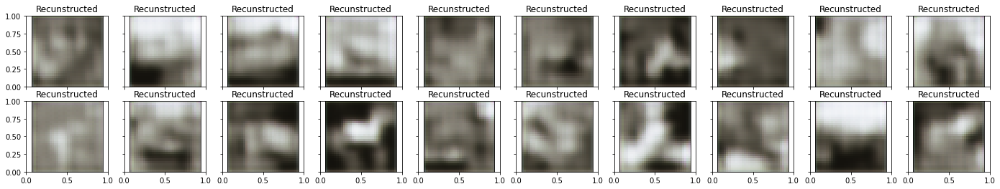


 EPOCH 42/150 	 train loss 0.5927339792251587 	 val loss 0.5978032350540161


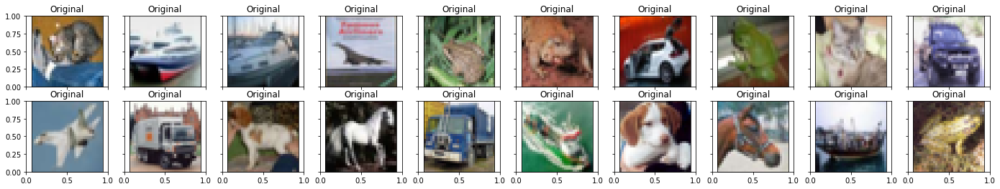

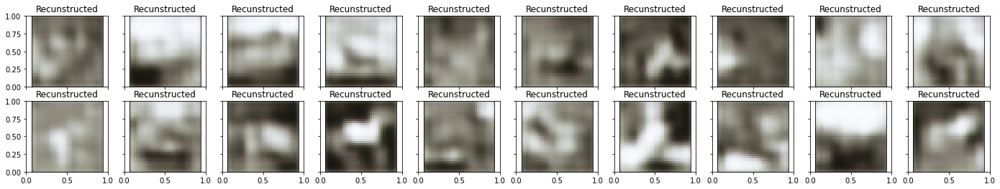


 EPOCH 43/150 	 train loss 0.5925825834274292 	 val loss 0.5964428186416626


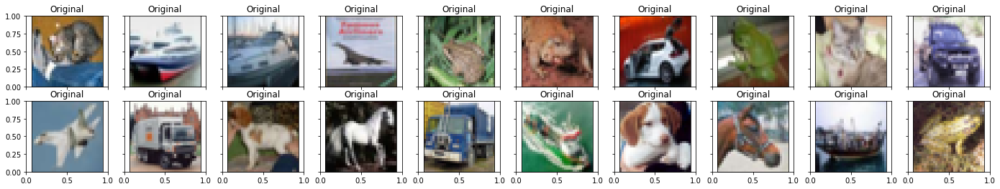

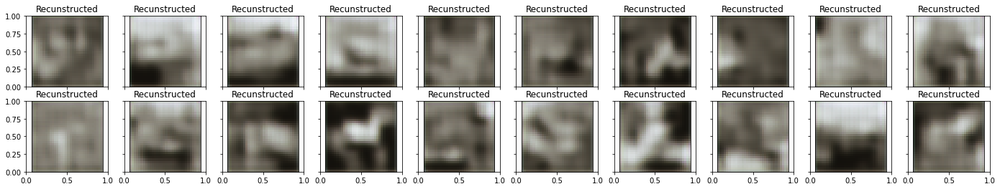


 EPOCH 44/150 	 train loss 0.5958912968635559 	 val loss 0.6016101837158203


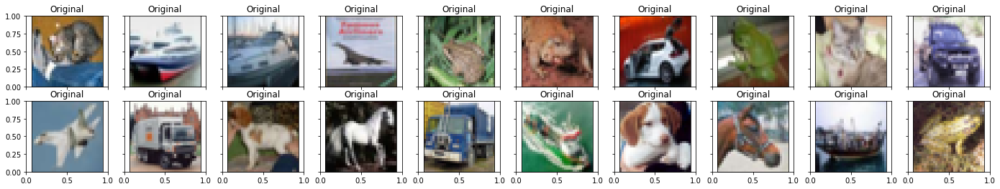

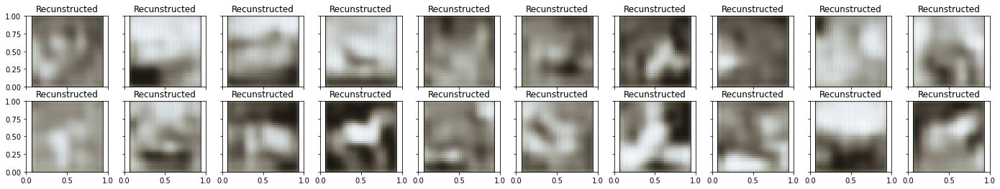


 EPOCH 45/150 	 train loss 0.6020663976669312 	 val loss 0.5947257876396179


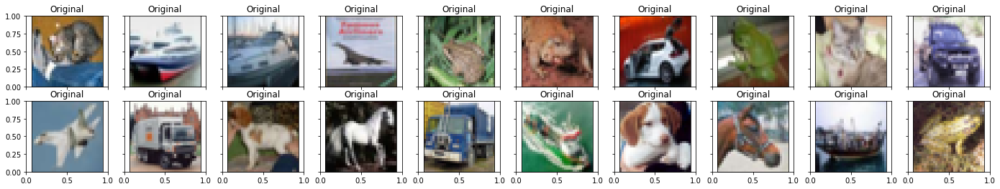

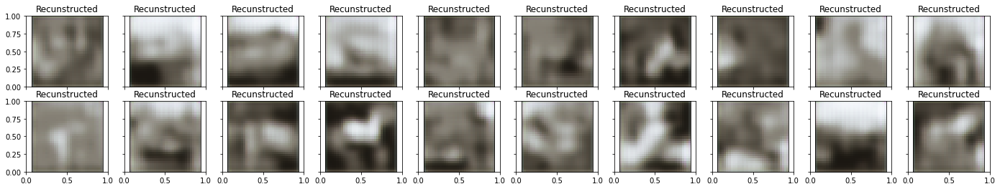


 EPOCH 46/150 	 train loss 0.5987006425857544 	 val loss 0.5959644317626953


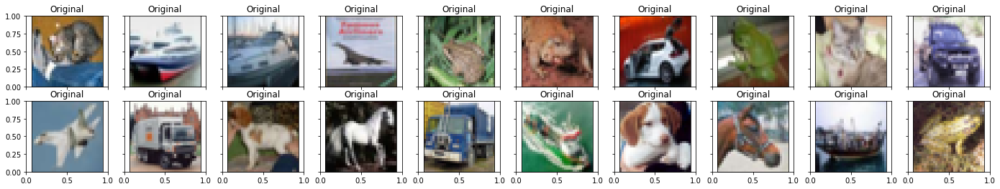

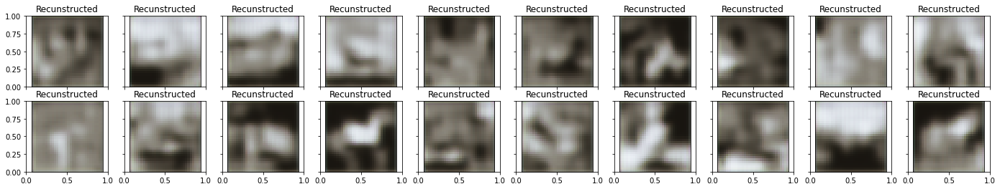


 EPOCH 47/150 	 train loss 0.6070002317428589 	 val loss 0.6038239598274231


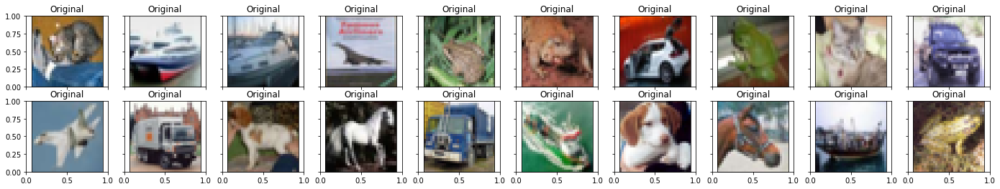

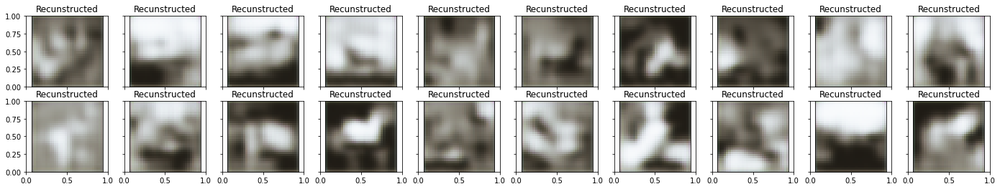


 EPOCH 48/150 	 train loss 0.6045712828636169 	 val loss 0.5941987037658691


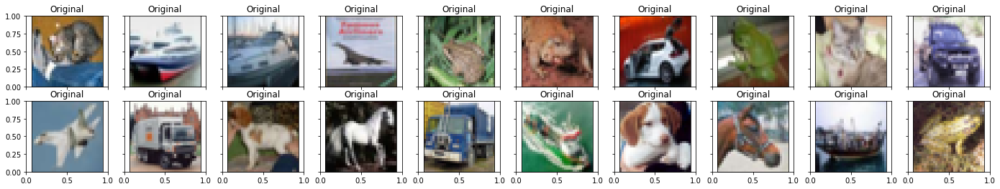

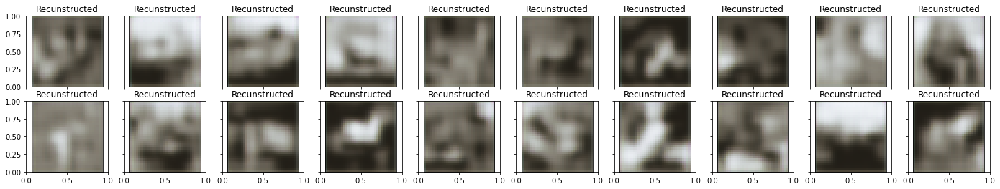


 EPOCH 49/150 	 train loss 0.5970476865768433 	 val loss 0.5921554565429688


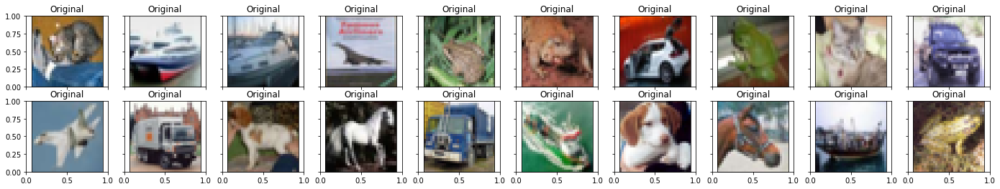

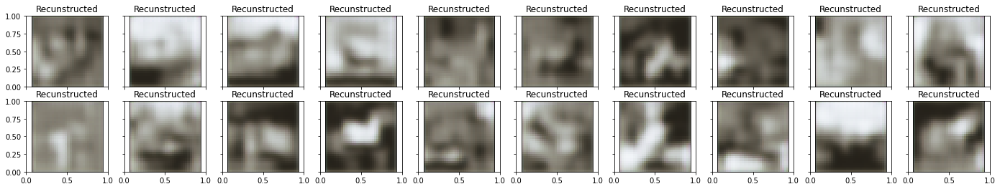


 EPOCH 50/150 	 train loss 0.5981851816177368 	 val loss 0.6078536510467529


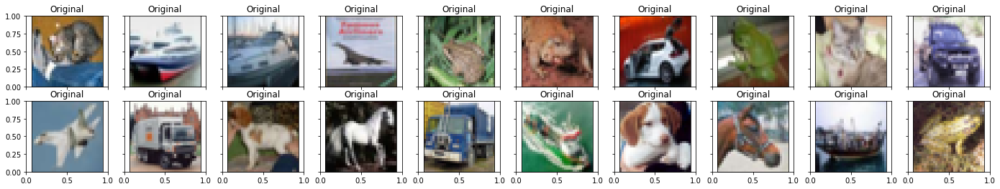

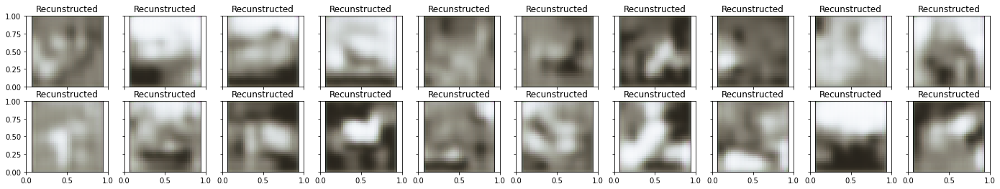


 EPOCH 51/150 	 train loss 0.5939334034919739 	 val loss 0.5923364162445068


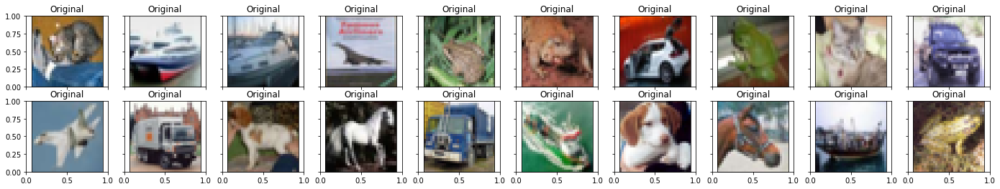

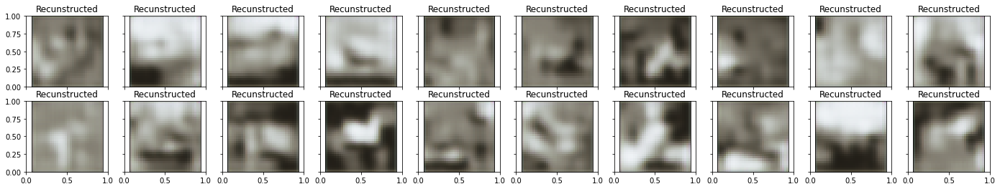


 EPOCH 52/150 	 train loss 0.5931615829467773 	 val loss 0.5958941578865051


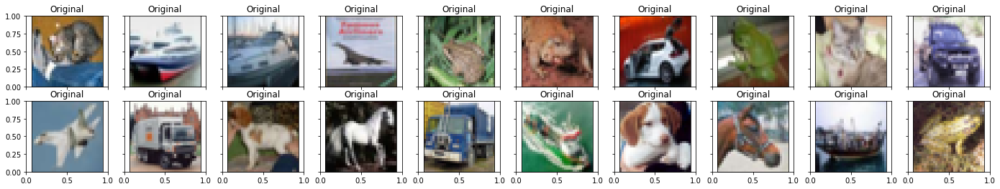

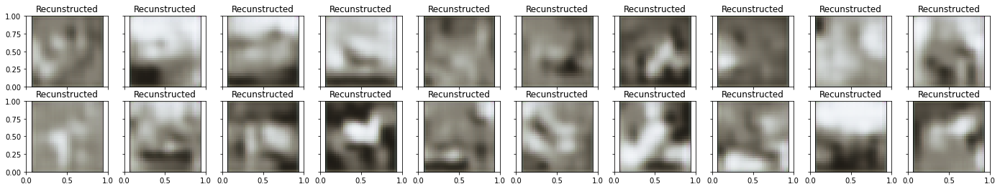


 EPOCH 53/150 	 train loss 0.5897763967514038 	 val loss 0.5897249579429626


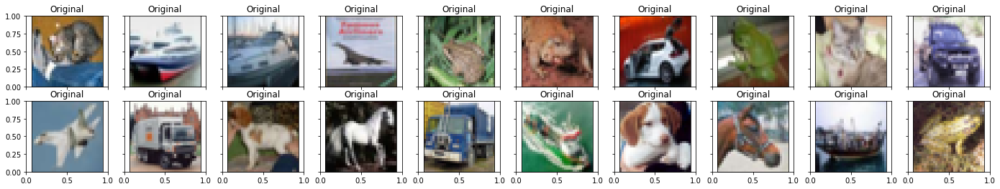

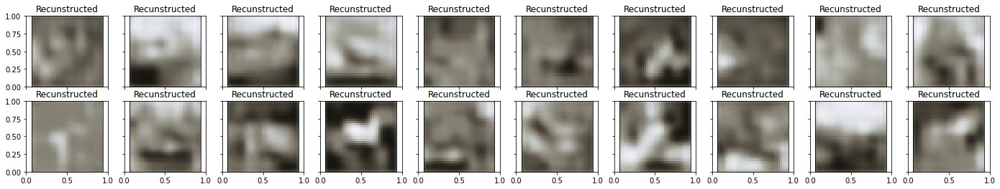


 EPOCH 54/150 	 train loss 0.5898467302322388 	 val loss 0.5919334888458252


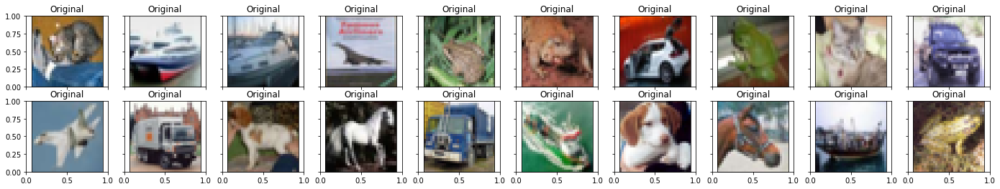

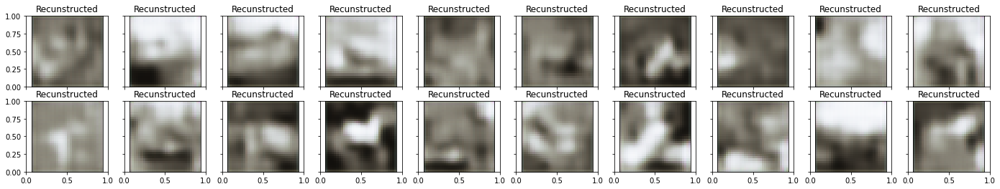


 EPOCH 55/150 	 train loss 0.5911034345626831 	 val loss 0.6012807488441467


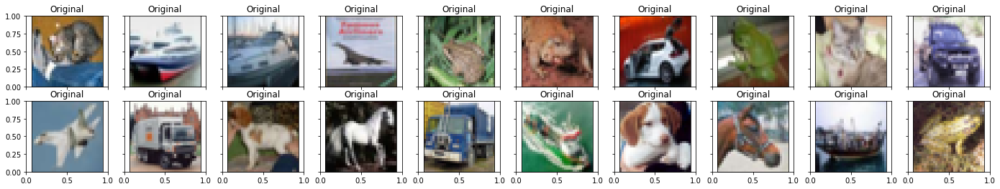

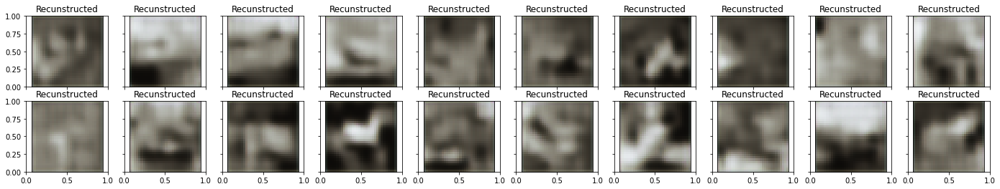


 EPOCH 56/150 	 train loss 0.5962608456611633 	 val loss 0.5984153151512146


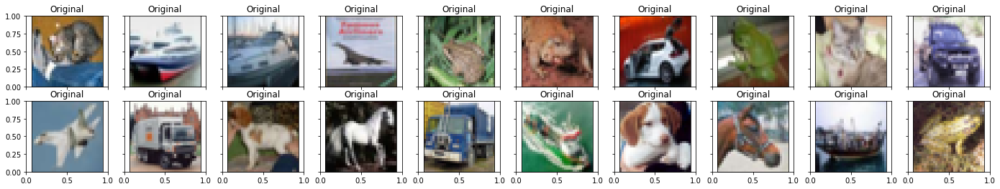

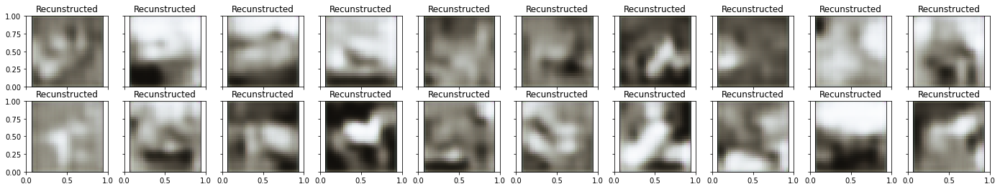


 EPOCH 57/150 	 train loss 0.5950554013252258 	 val loss 0.5930623412132263


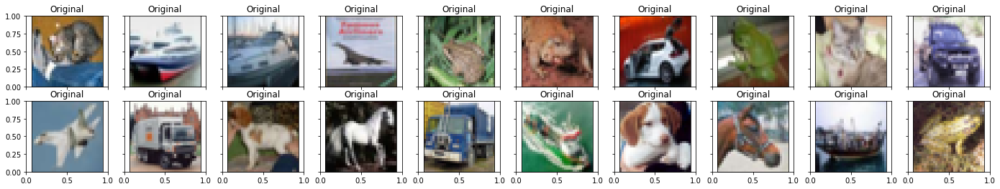

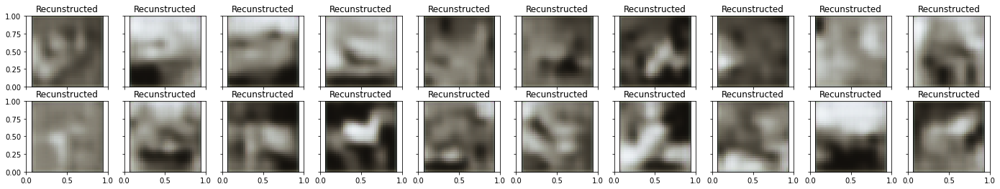


 EPOCH 58/150 	 train loss 0.5921836495399475 	 val loss 0.5904247164726257


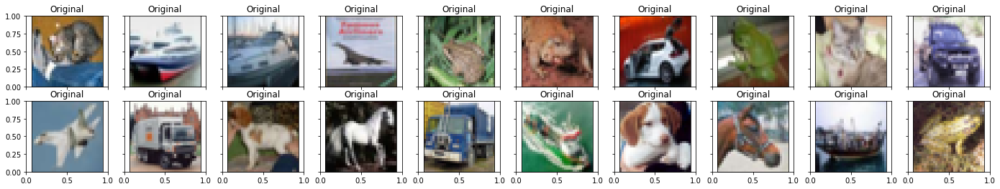

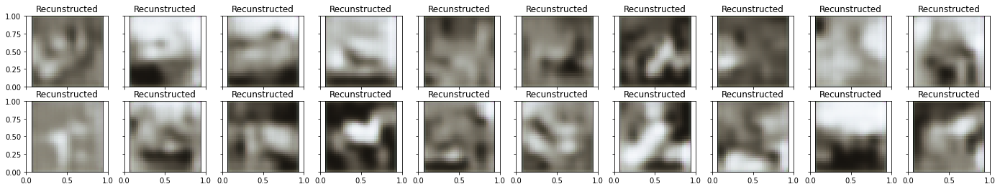


 EPOCH 59/150 	 train loss 0.5951333045959473 	 val loss 0.5891619920730591


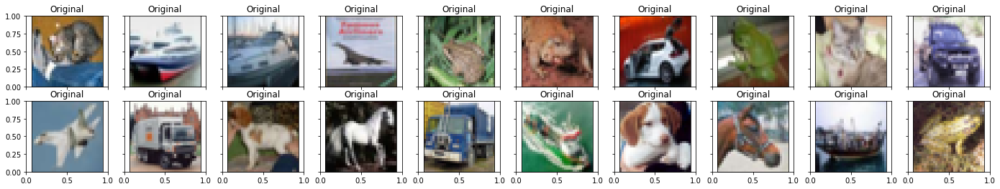

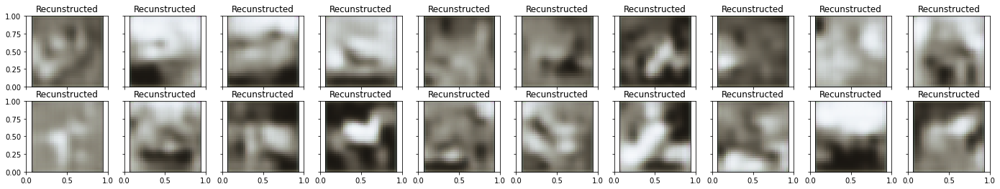


 EPOCH 60/150 	 train loss 0.5959068536758423 	 val loss 0.5882220268249512


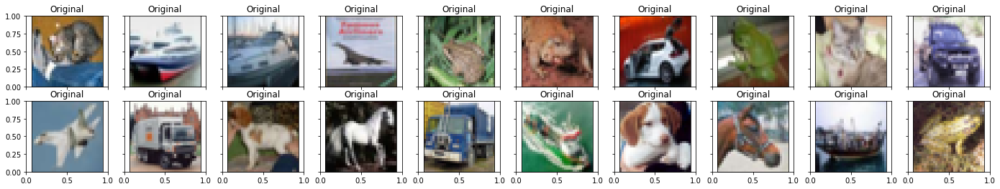

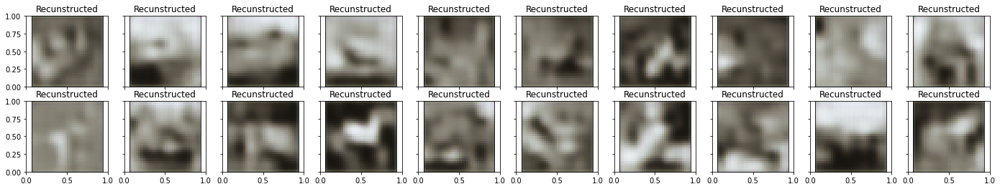


 EPOCH 61/150 	 train loss 0.5932722687721252 	 val loss 0.6039342284202576


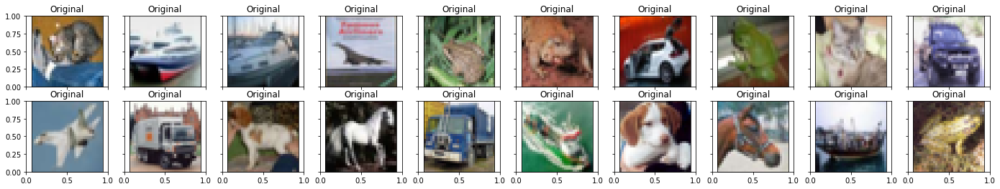

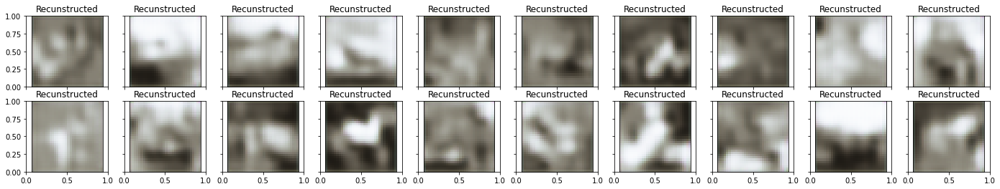


 EPOCH 62/150 	 train loss 0.5926865339279175 	 val loss 0.5871540307998657


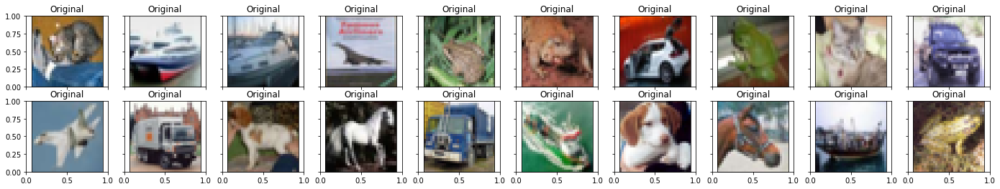

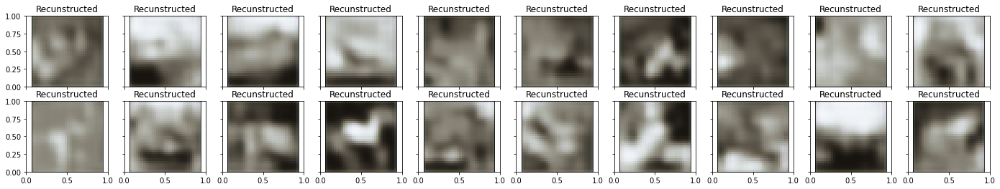


 EPOCH 63/150 	 train loss 0.5934244394302368 	 val loss 0.5875340104103088


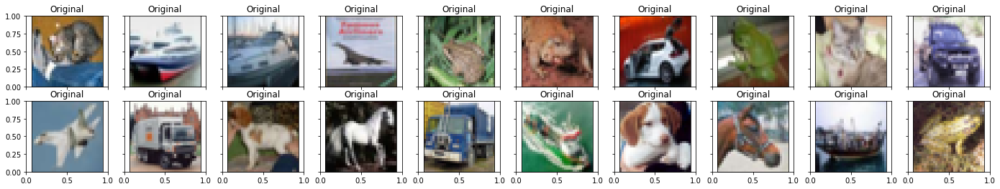

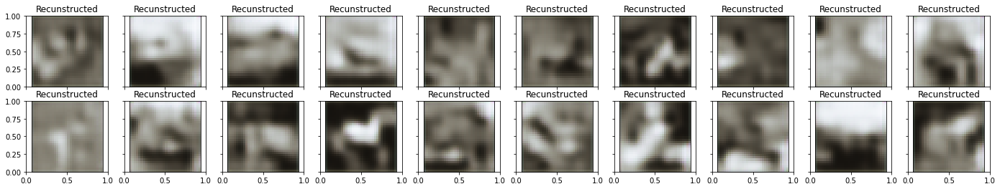


 EPOCH 64/150 	 train loss 0.5940709114074707 	 val loss 0.6061663031578064


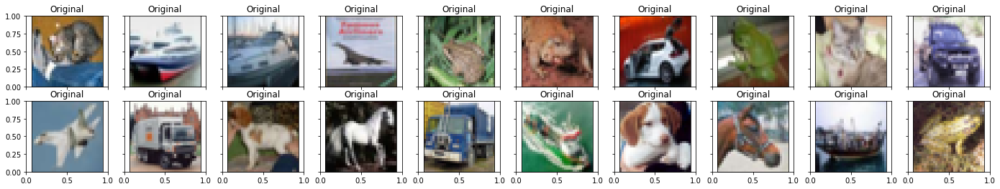

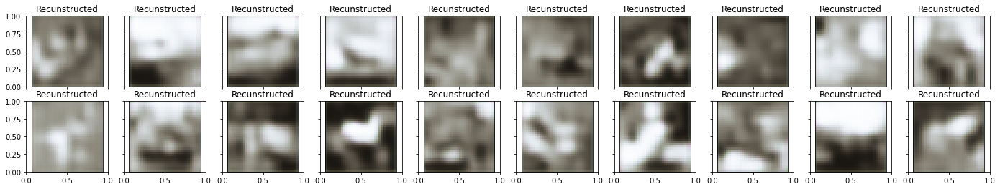


 EPOCH 65/150 	 train loss 0.5944521427154541 	 val loss 0.5861673355102539


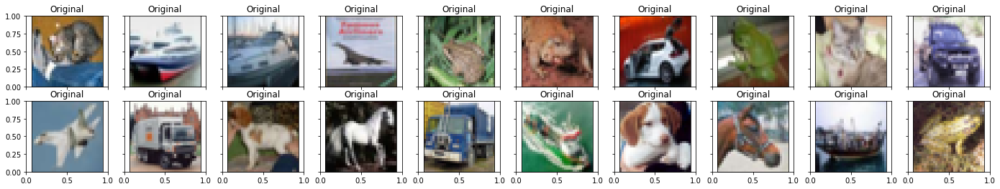

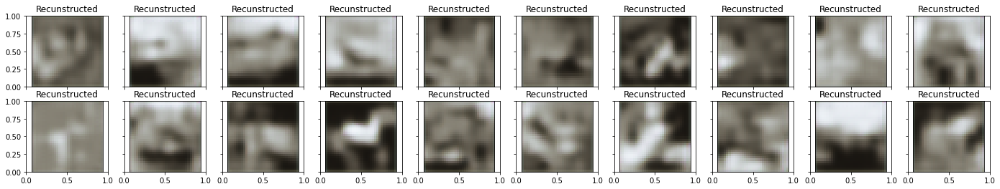


 EPOCH 66/150 	 train loss 0.5940554141998291 	 val loss 0.5865456461906433


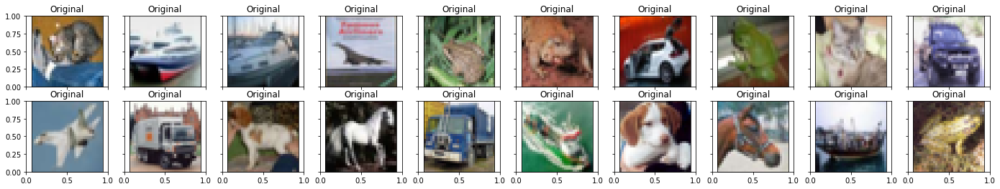

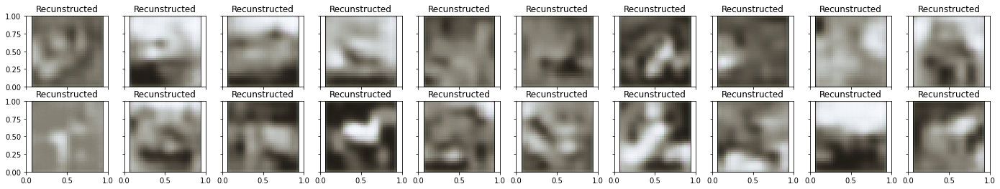


 EPOCH 67/150 	 train loss 0.588761031627655 	 val loss 0.5875921845436096


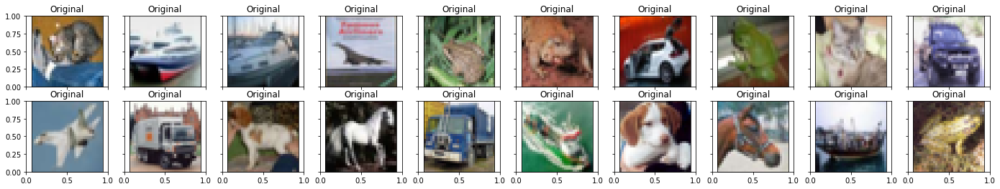

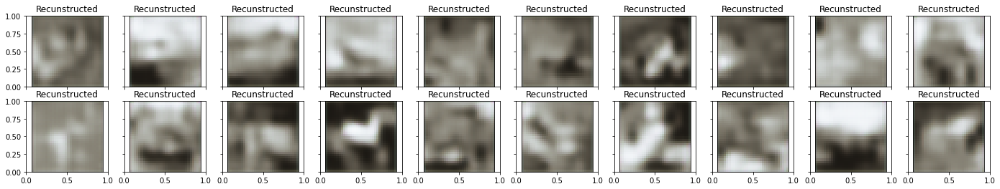


 EPOCH 68/150 	 train loss 0.590137779712677 	 val loss 0.5859609246253967


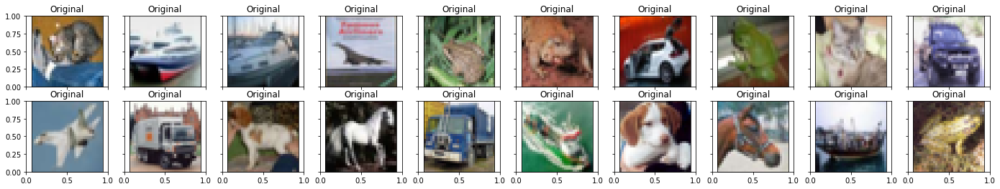

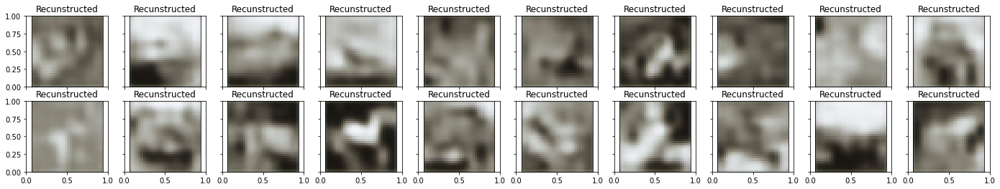


 EPOCH 69/150 	 train loss 0.5858219861984253 	 val loss 0.5887054204940796


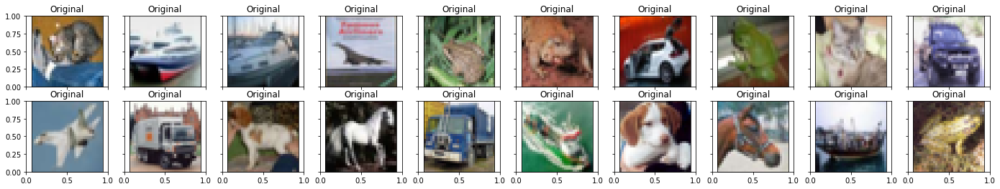

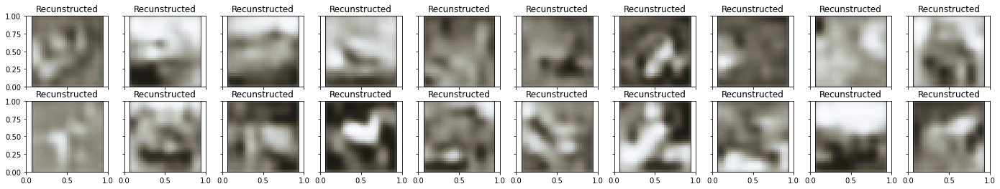


 EPOCH 70/150 	 train loss 0.5874166488647461 	 val loss 0.5838474631309509


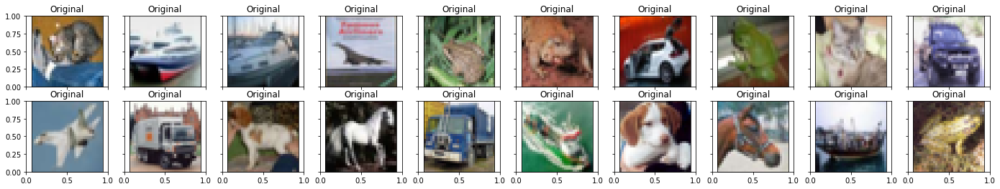

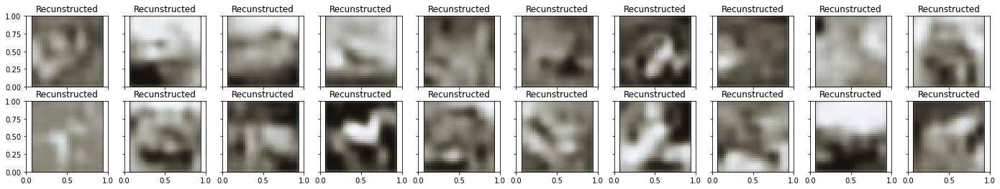


 EPOCH 71/150 	 train loss 0.5859806537628174 	 val loss 0.5842124223709106


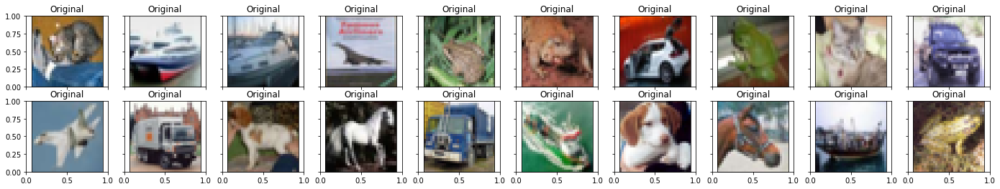

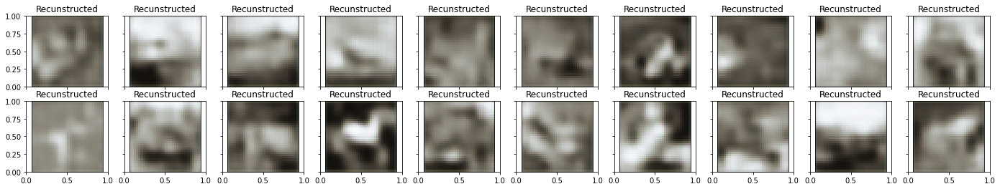


 EPOCH 72/150 	 train loss 0.5848696827888489 	 val loss 0.5832376480102539


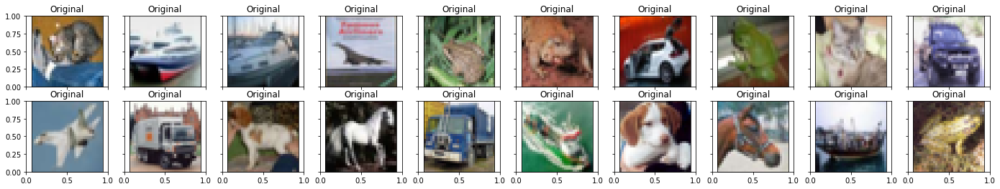

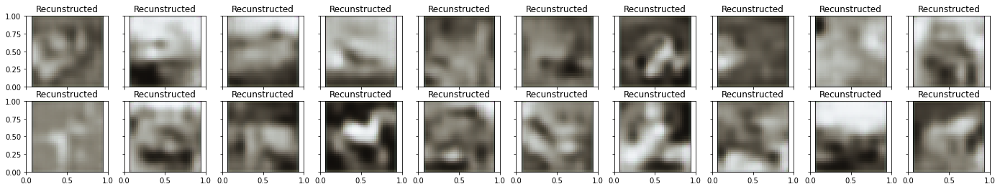


 EPOCH 73/150 	 train loss 0.5851305723190308 	 val loss 0.5826942324638367


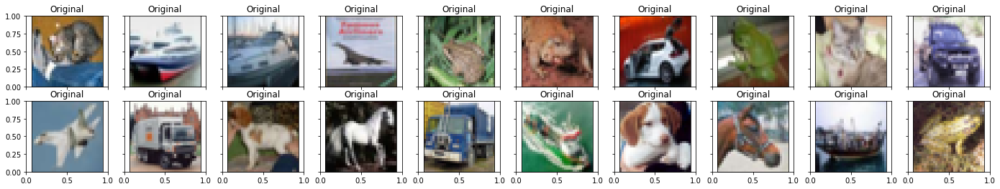

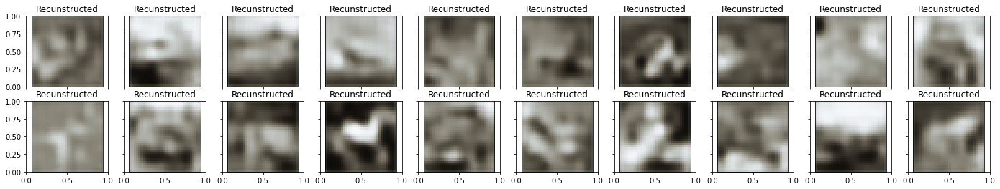


 EPOCH 74/150 	 train loss 0.5838908553123474 	 val loss 0.5824207067489624


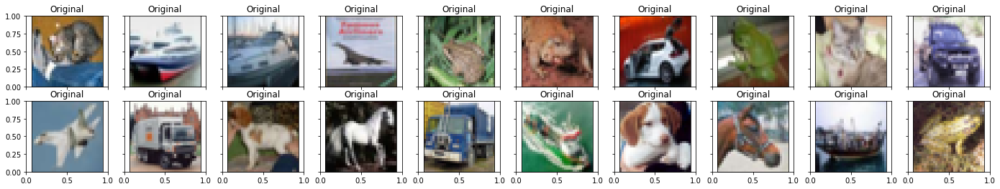

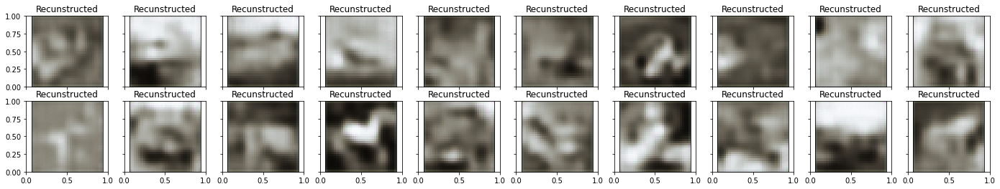


 EPOCH 75/150 	 train loss 0.5840421915054321 	 val loss 0.5821436047554016


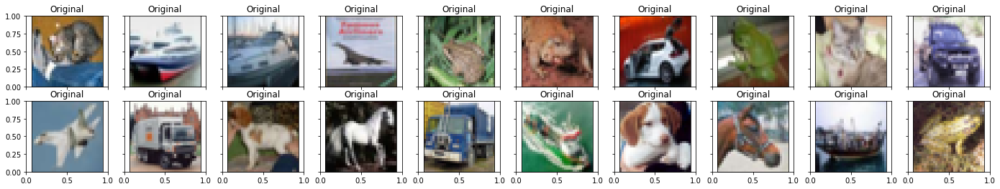

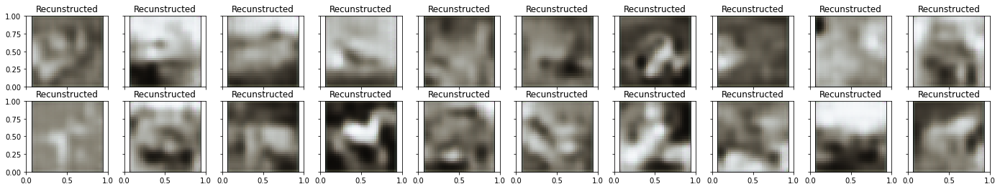


 EPOCH 76/150 	 train loss 0.5828224420547485 	 val loss 0.5835566520690918


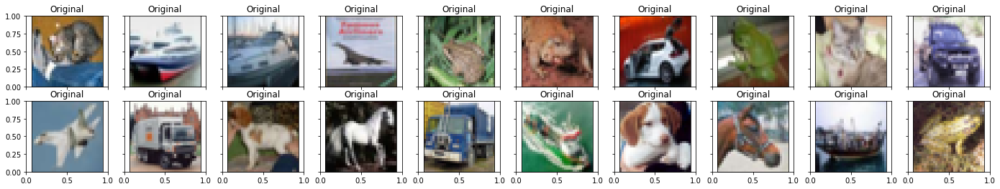

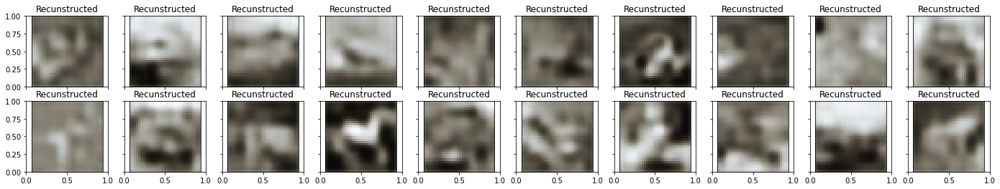


 EPOCH 77/150 	 train loss 0.5831668376922607 	 val loss 0.5821408629417419


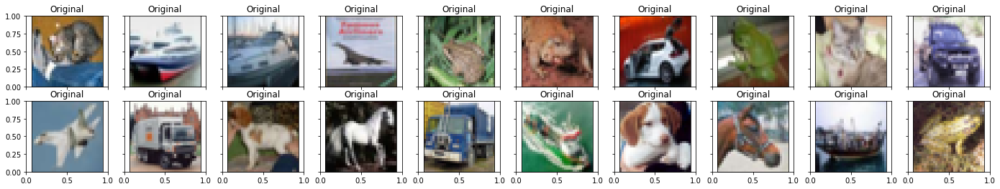

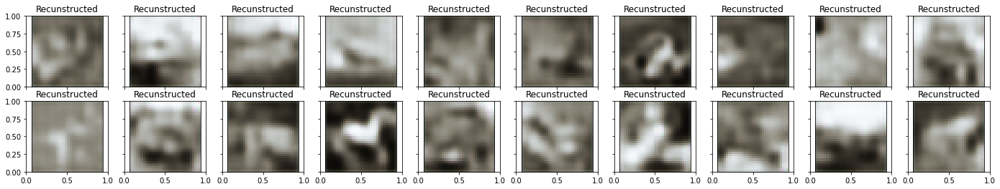


 EPOCH 78/150 	 train loss 0.5828394293785095 	 val loss 0.5844914317131042


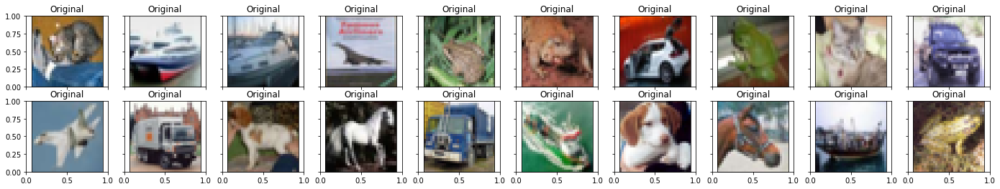

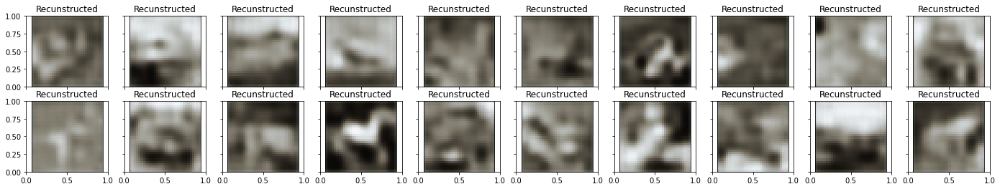


 EPOCH 79/150 	 train loss 0.5828311443328857 	 val loss 0.5828865170478821


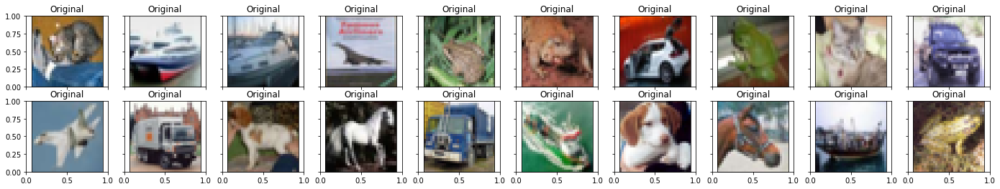

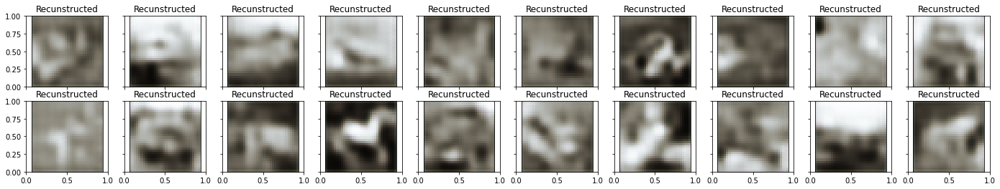


 EPOCH 80/150 	 train loss 0.5832849740982056 	 val loss 0.596657395362854


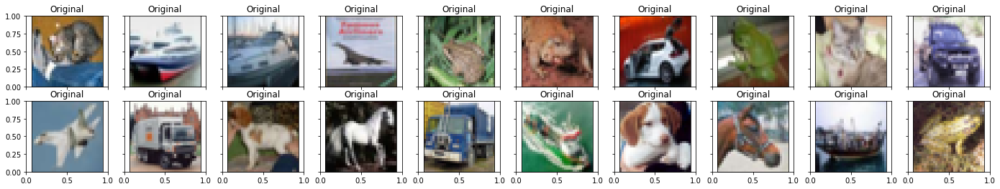

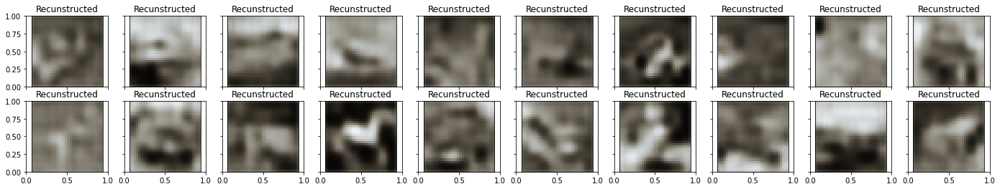


 EPOCH 81/150 	 train loss 0.5853859186172485 	 val loss 0.5944690108299255


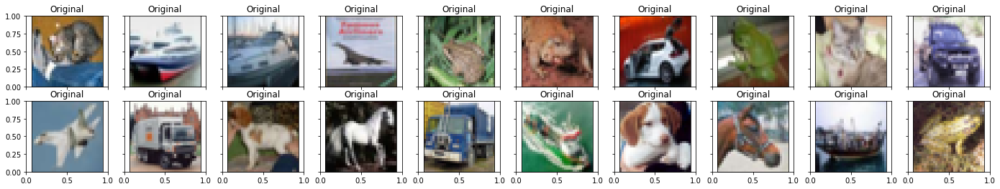

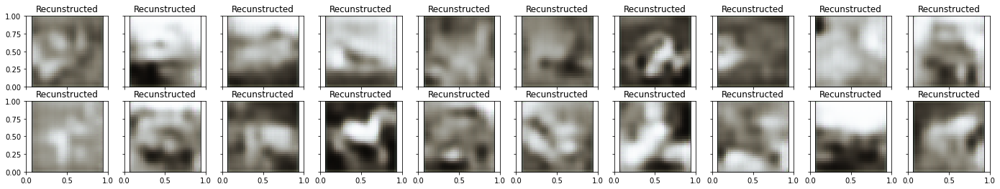


 EPOCH 82/150 	 train loss 0.589540421962738 	 val loss 0.5925871133804321


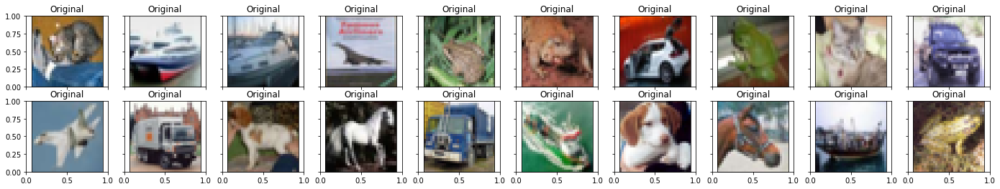

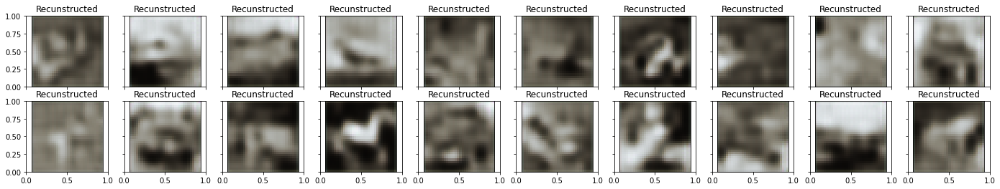


 EPOCH 83/150 	 train loss 0.5836765170097351 	 val loss 0.588693380355835


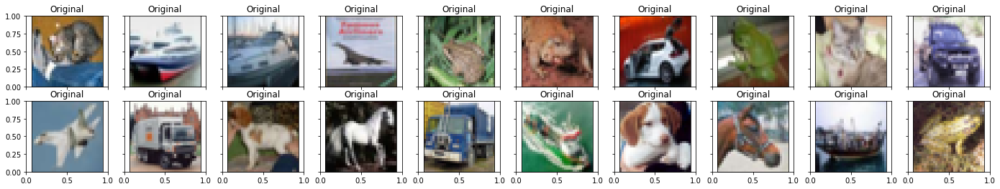

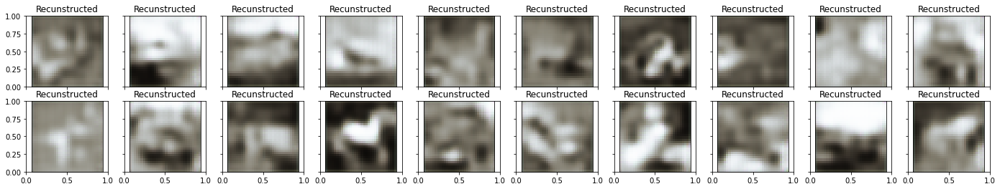


 EPOCH 84/150 	 train loss 0.5856531858444214 	 val loss 0.5834411978721619


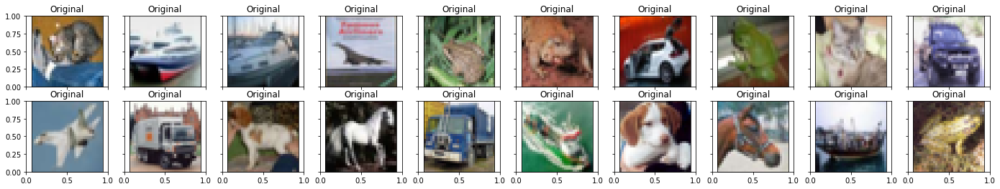

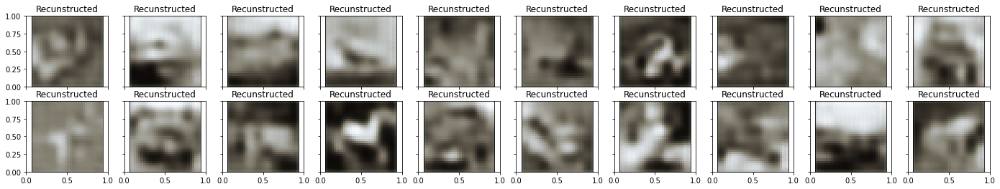


 EPOCH 85/150 	 train loss 0.5827784538269043 	 val loss 0.5813438892364502


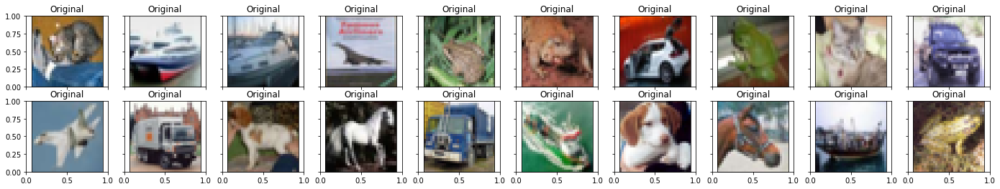

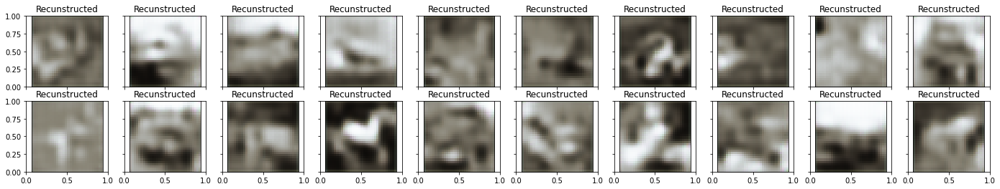


 EPOCH 86/150 	 train loss 0.5823760032653809 	 val loss 0.581766664981842


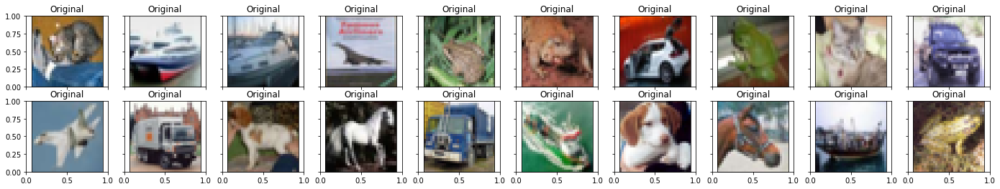

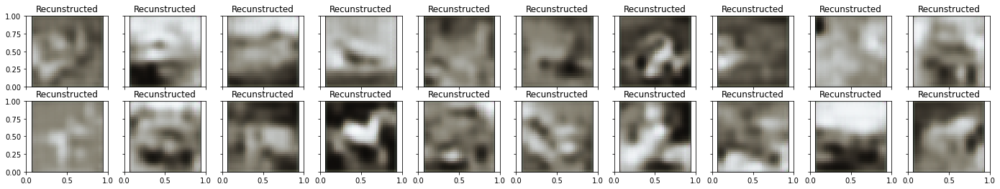


 EPOCH 87/150 	 train loss 0.5837411880493164 	 val loss 0.5808213353157043


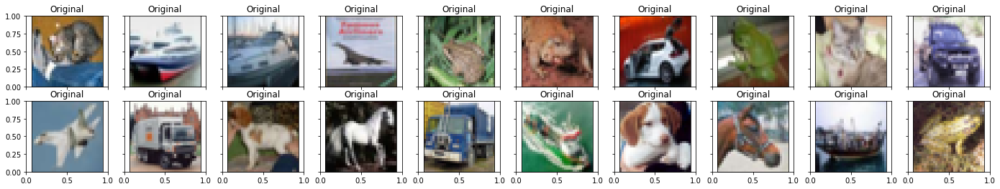

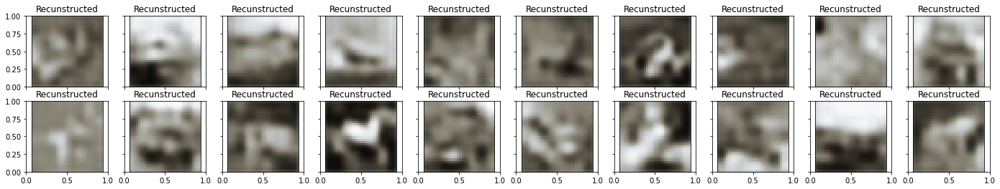


 EPOCH 88/150 	 train loss 0.5820684432983398 	 val loss 0.5831469893455505


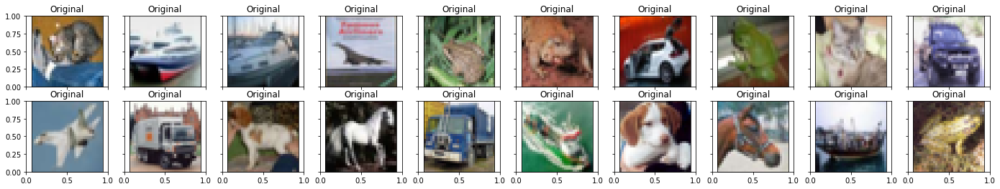

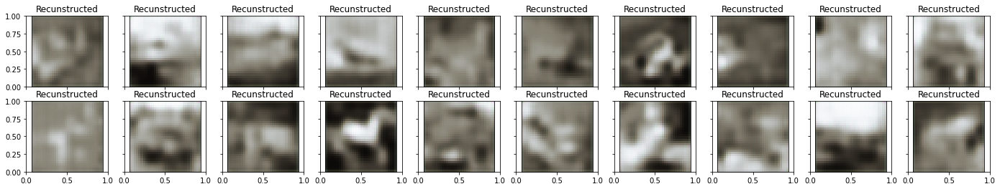


 EPOCH 89/150 	 train loss 0.5850651860237122 	 val loss 0.5866735577583313


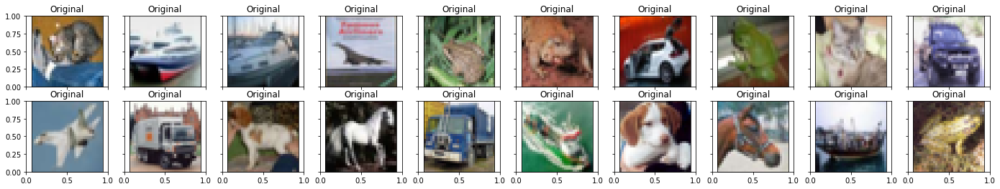

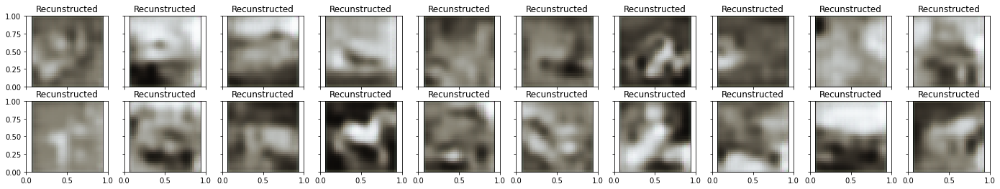


 EPOCH 90/150 	 train loss 0.5923590064048767 	 val loss 0.5941708087921143


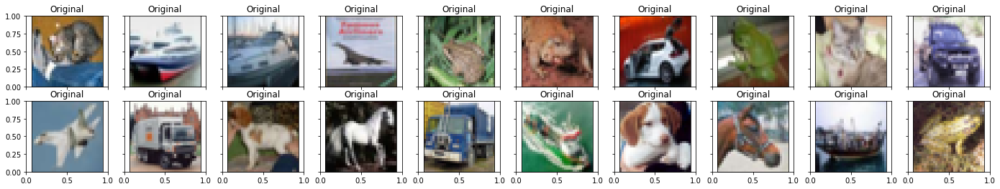

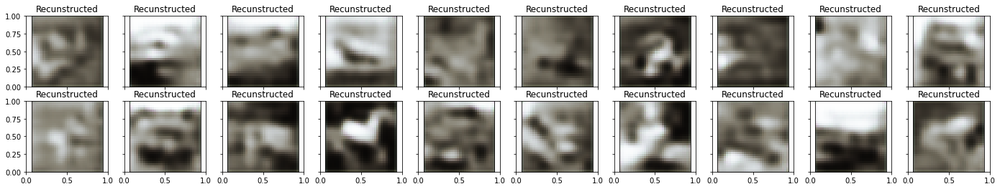


 EPOCH 91/150 	 train loss 0.6036052703857422 	 val loss 0.6000696420669556


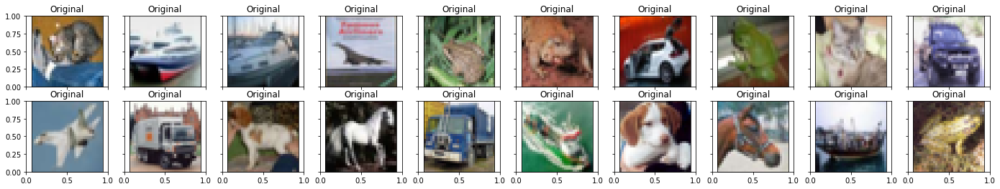

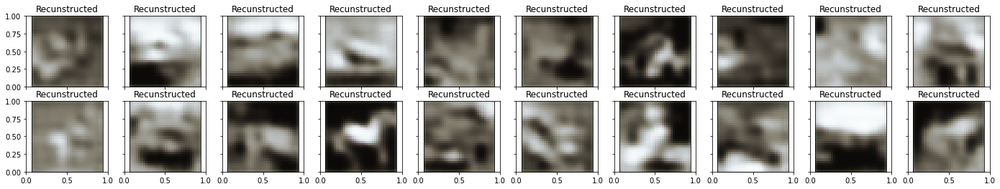


 EPOCH 92/150 	 train loss 0.5967884063720703 	 val loss 0.588559091091156


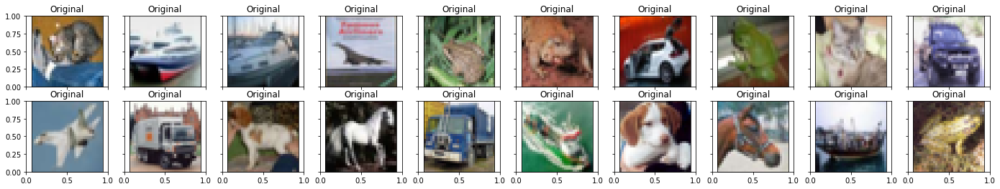

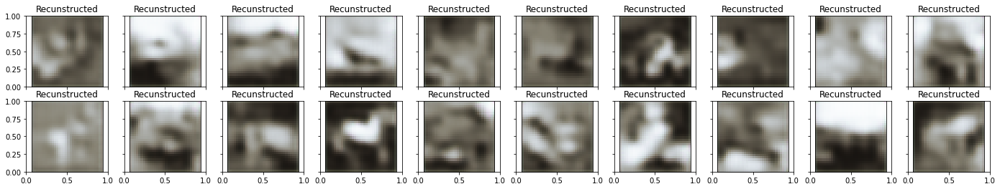


 EPOCH 93/150 	 train loss 0.5947443246841431 	 val loss 0.5857878923416138


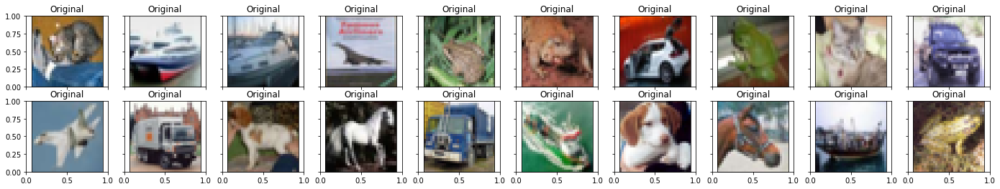

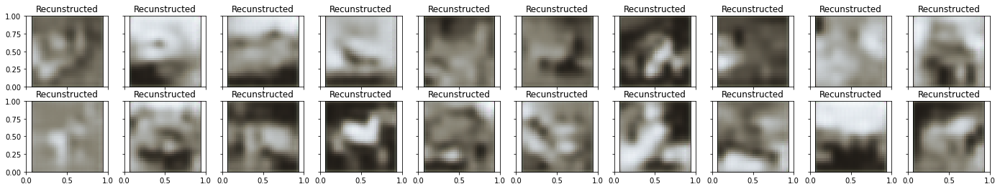


 EPOCH 94/150 	 train loss 0.5893731713294983 	 val loss 0.5893282294273376


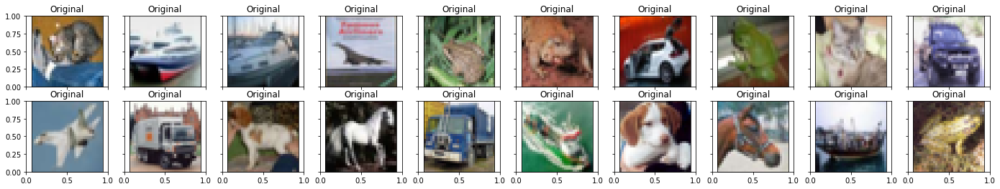

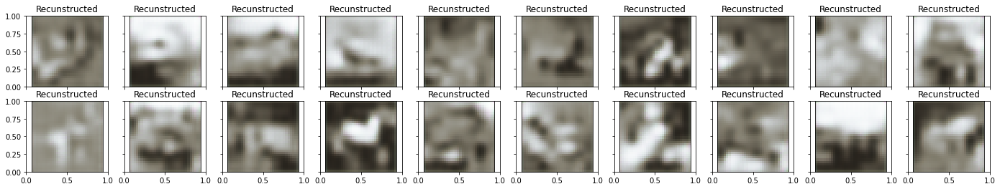


 EPOCH 95/150 	 train loss 0.5862683653831482 	 val loss 0.5958890914916992


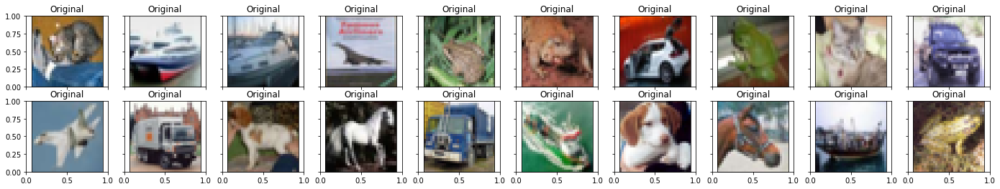

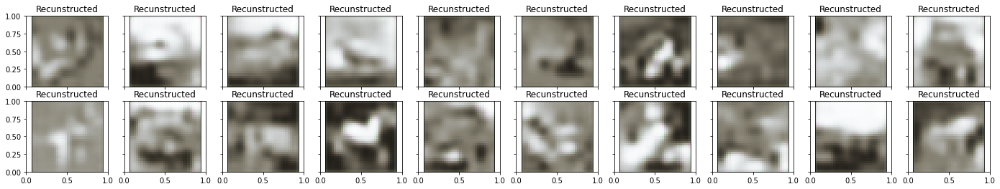


 EPOCH 96/150 	 train loss 0.584455132484436 	 val loss 0.5885743498802185


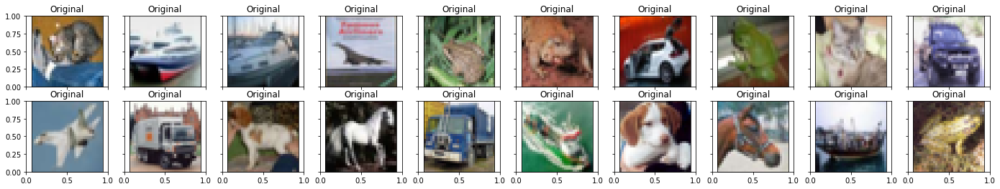

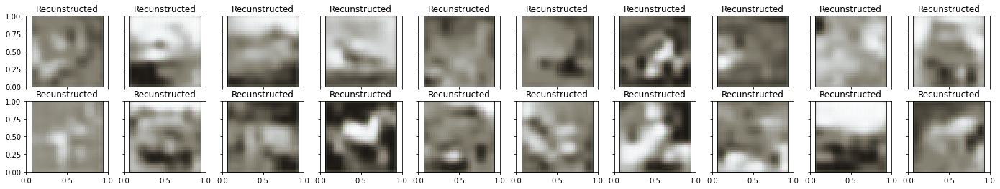


 EPOCH 97/150 	 train loss 0.5836294889450073 	 val loss 0.585159957408905


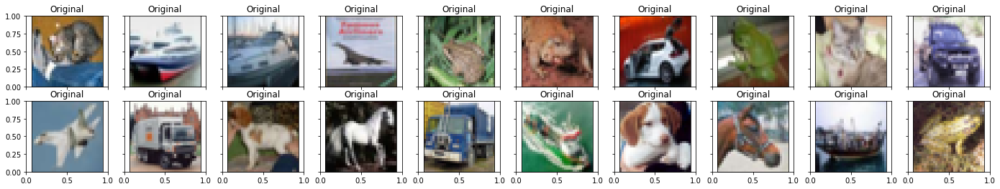

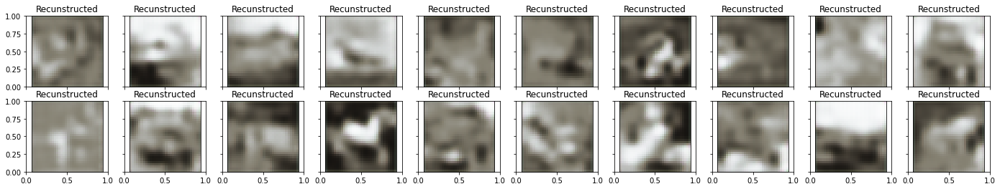


 EPOCH 98/150 	 train loss 0.5817195773124695 	 val loss 0.5826859474182129


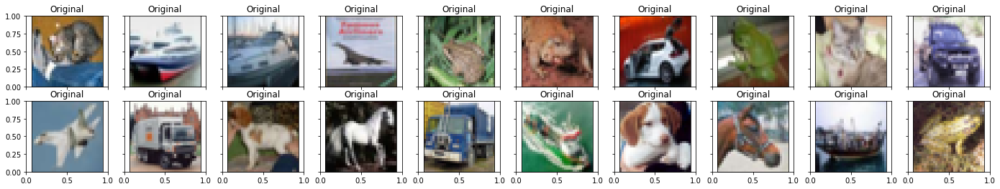

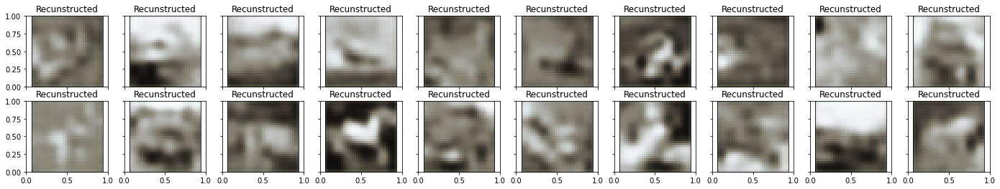


 EPOCH 99/150 	 train loss 0.5819351077079773 	 val loss 0.581515908241272


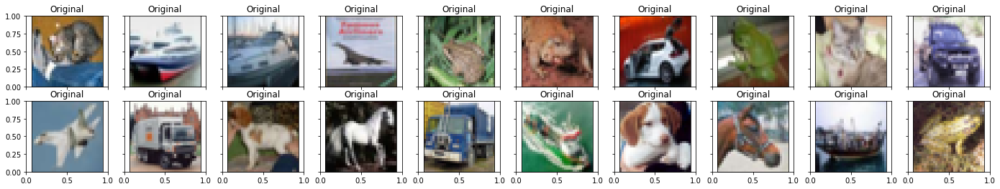

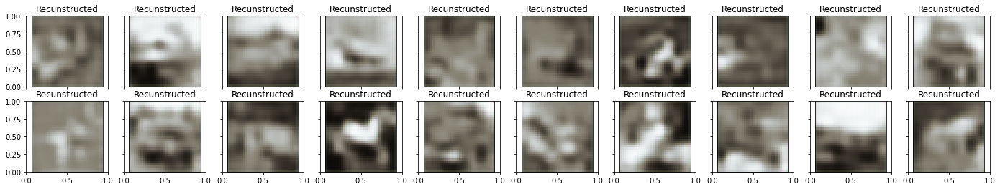


 EPOCH 100/150 	 train loss 0.5822679996490479 	 val loss 0.5812303423881531


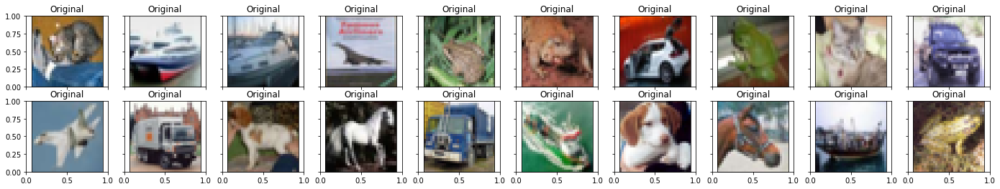

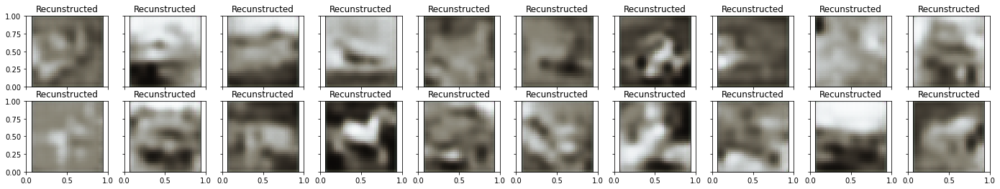


 EPOCH 101/150 	 train loss 0.5816357135772705 	 val loss 0.5812805891036987


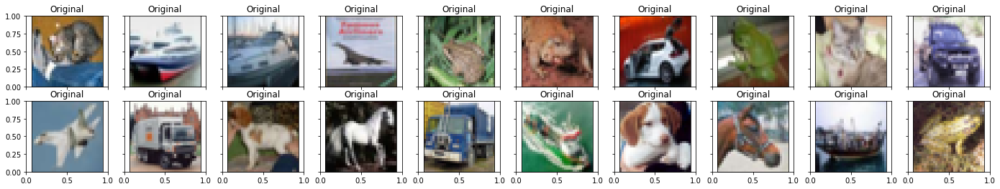

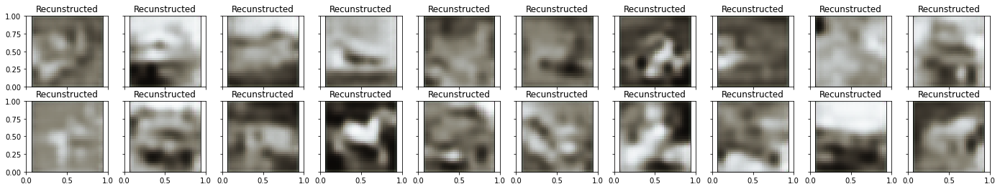


 EPOCH 102/150 	 train loss 0.5830880999565125 	 val loss 0.5825878977775574


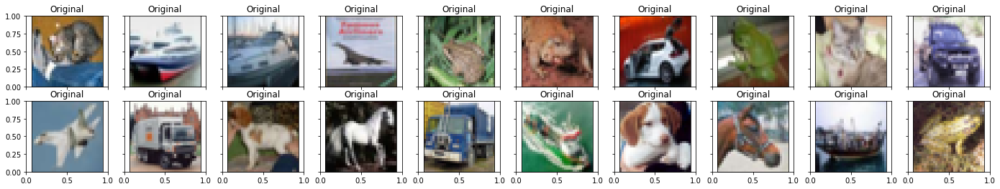

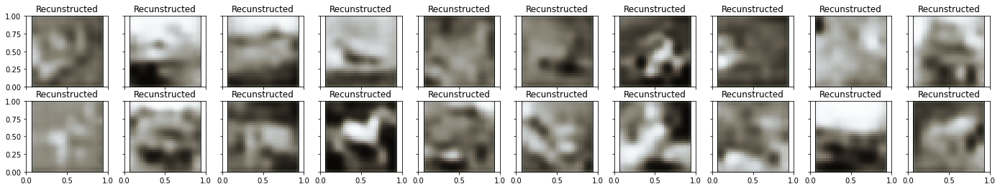


 EPOCH 103/150 	 train loss 0.5883337259292603 	 val loss 0.5854970812797546


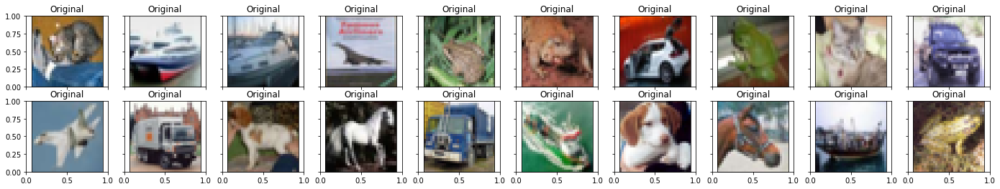

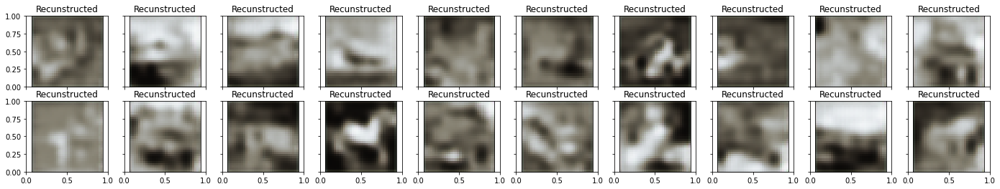


 EPOCH 104/150 	 train loss 0.5894718170166016 	 val loss 0.5808768272399902


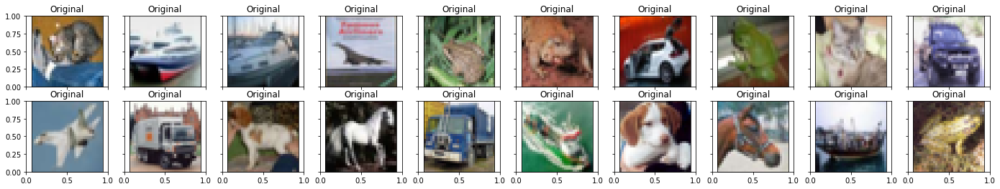

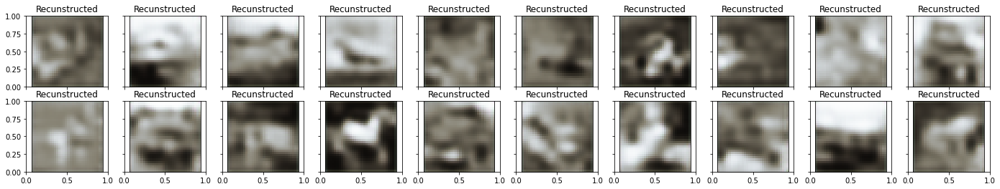


 EPOCH 105/150 	 train loss 0.5847724676132202 	 val loss 0.5829544067382812


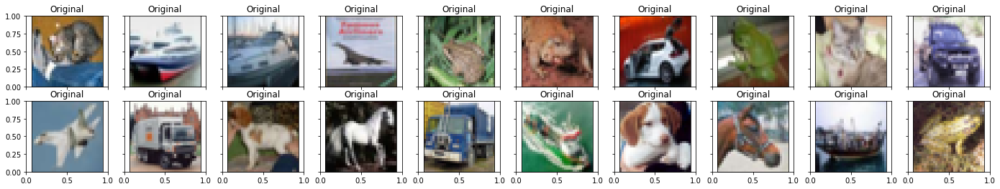

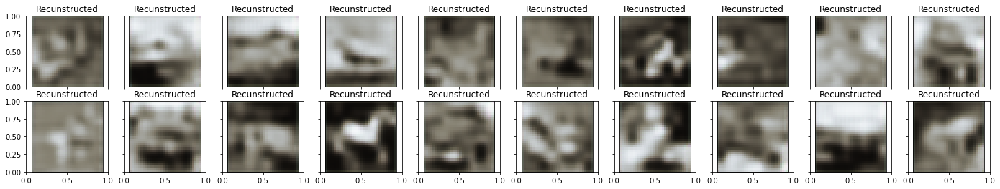


 EPOCH 106/150 	 train loss 0.5831001996994019 	 val loss 0.5969788432121277


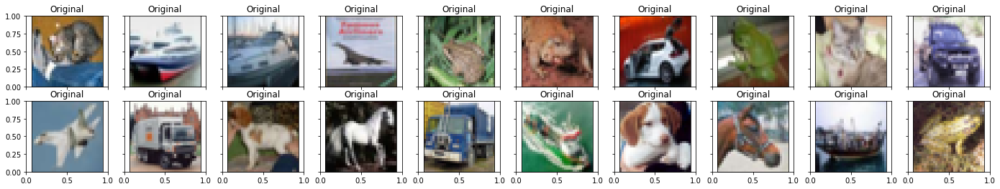

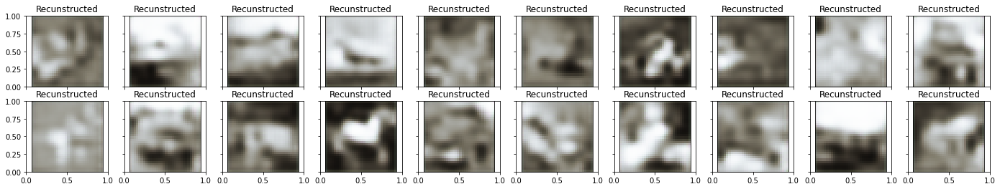


 EPOCH 107/150 	 train loss 0.5840525031089783 	 val loss 0.5808262825012207


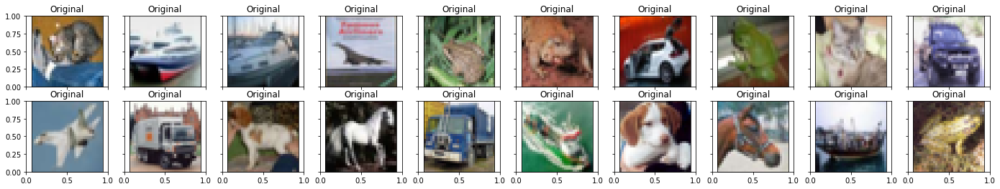

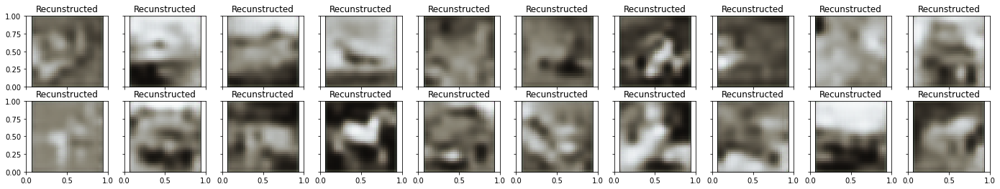


 EPOCH 108/150 	 train loss 0.5819021463394165 	 val loss 0.5826696753501892


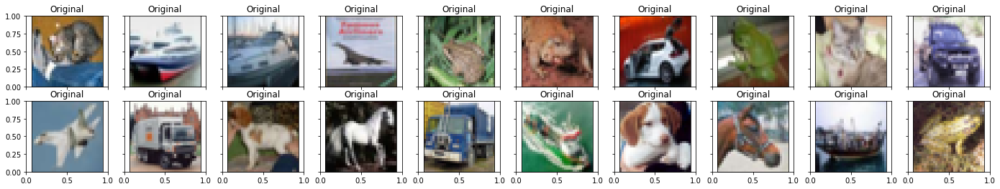

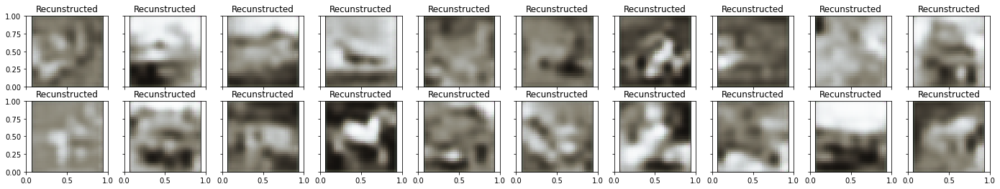


 EPOCH 109/150 	 train loss 0.5818583965301514 	 val loss 0.5796352028846741


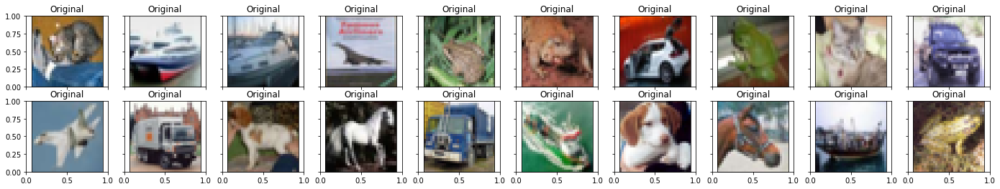

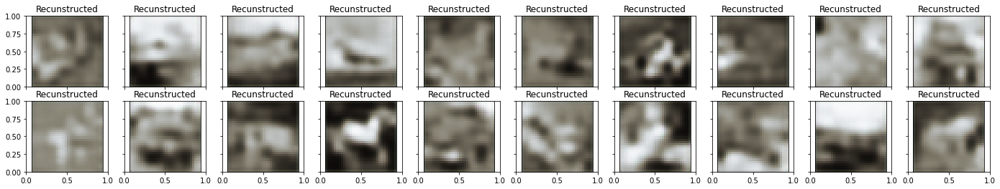


 EPOCH 110/150 	 train loss 0.5802000761032104 	 val loss 0.5808590650558472


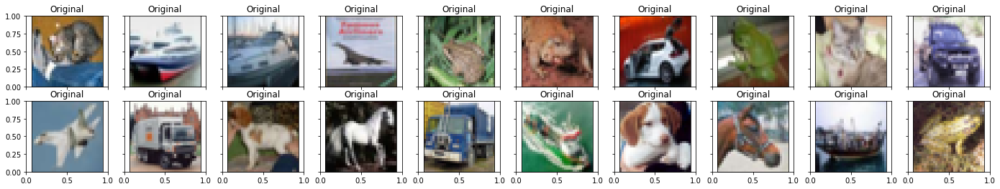

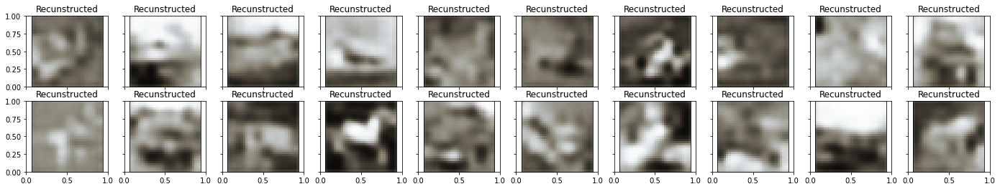


 EPOCH 111/150 	 train loss 0.5806084871292114 	 val loss 0.5792524814605713


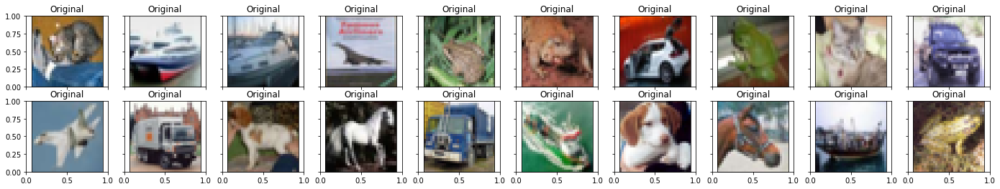

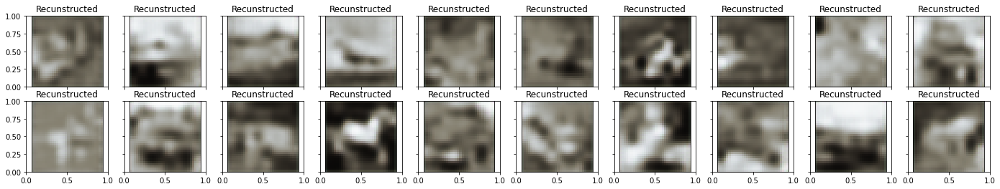


 EPOCH 112/150 	 train loss 0.5800095796585083 	 val loss 0.5816869735717773


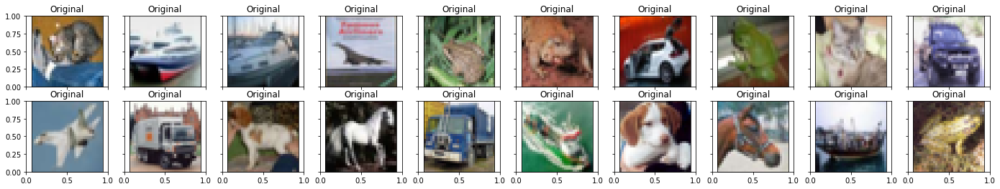

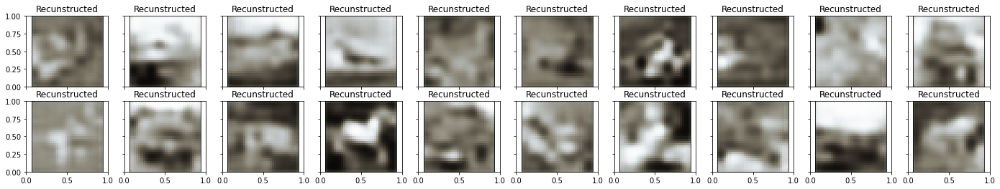


 EPOCH 113/150 	 train loss 0.5805404186248779 	 val loss 0.5792043209075928


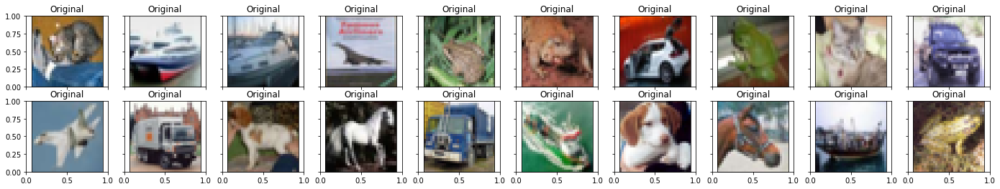

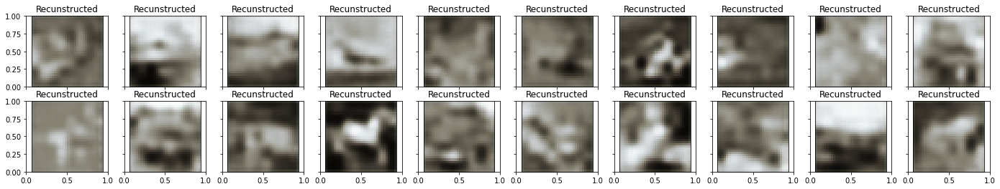


 EPOCH 114/150 	 train loss 0.5800583362579346 	 val loss 0.5789178013801575


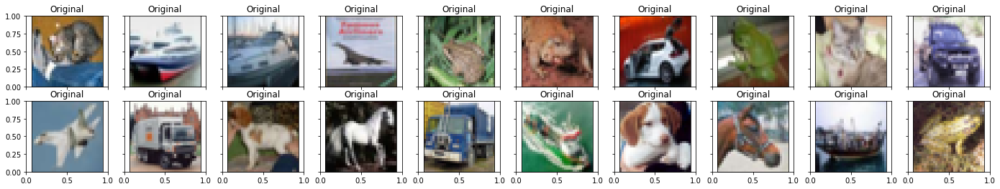

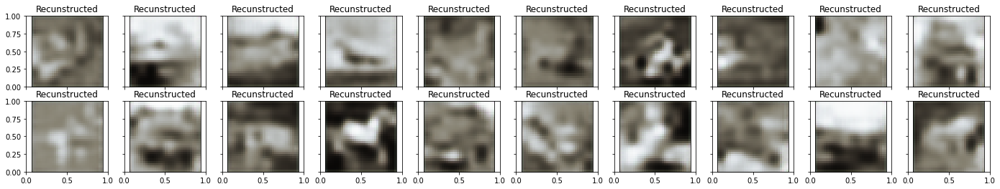


 EPOCH 115/150 	 train loss 0.5802373886108398 	 val loss 0.5786826610565186


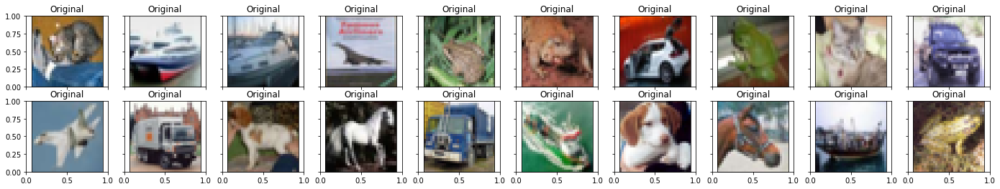

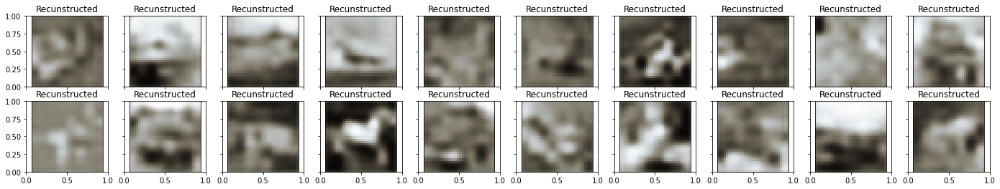


 EPOCH 116/150 	 train loss 0.5796254873275757 	 val loss 0.5791620016098022


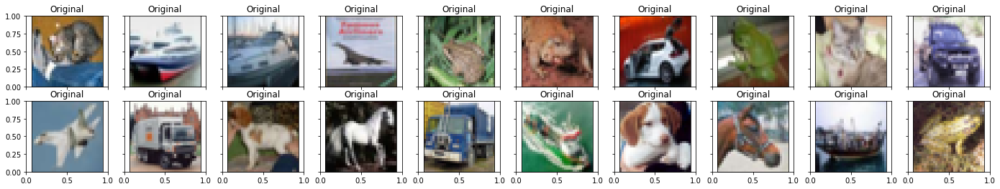

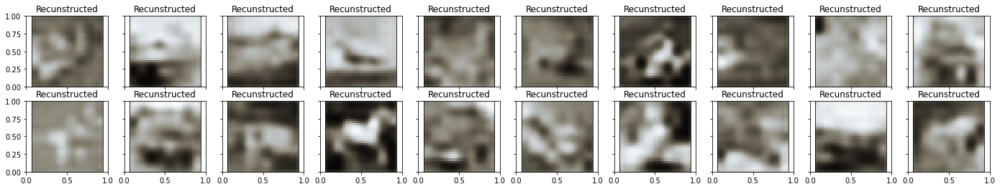


 EPOCH 117/150 	 train loss 0.5793443322181702 	 val loss 0.5787246227264404


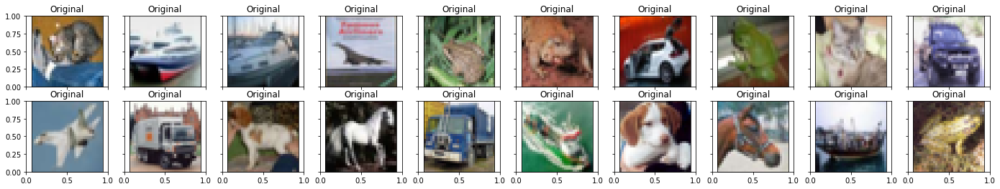

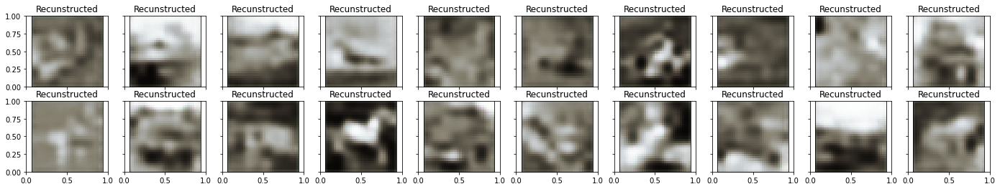


 EPOCH 118/150 	 train loss 0.5795977711677551 	 val loss 0.5789335370063782


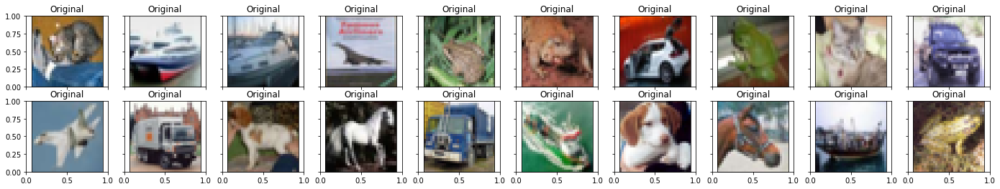

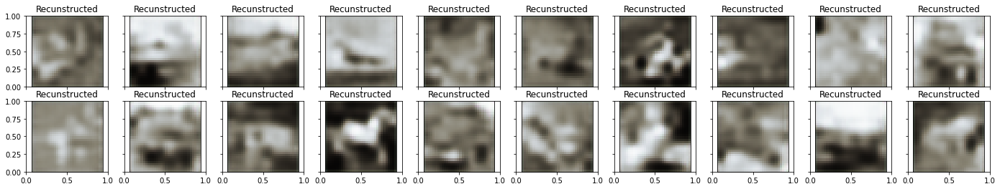


 EPOCH 119/150 	 train loss 0.5792444944381714 	 val loss 0.5788254141807556


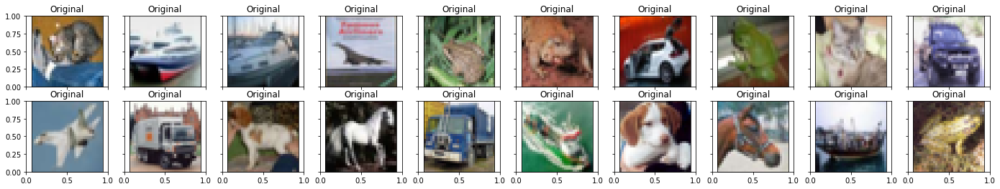

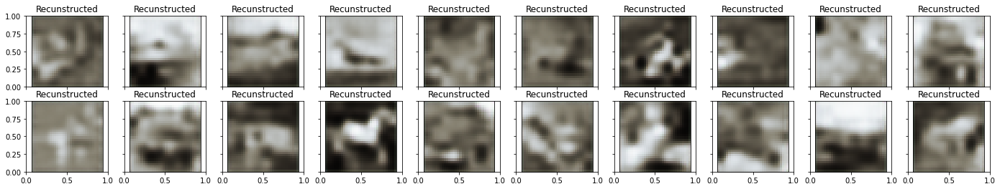


 EPOCH 120/150 	 train loss 0.5797401666641235 	 val loss 0.5790687203407288


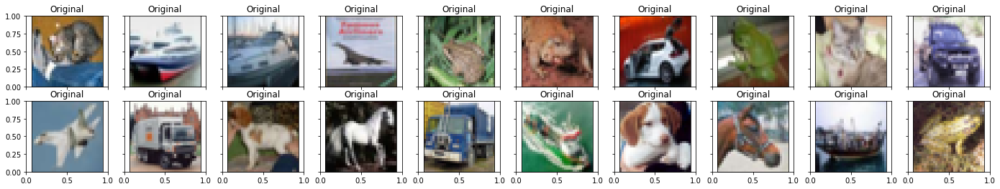

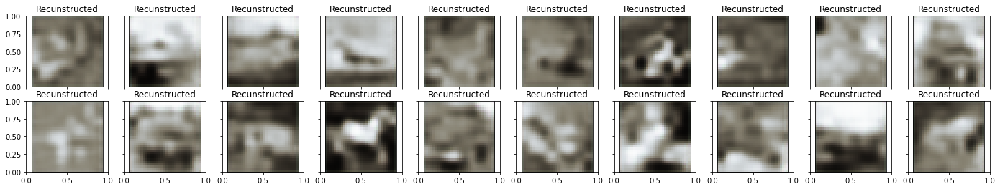


 EPOCH 121/150 	 train loss 0.5791449546813965 	 val loss 0.580858588218689


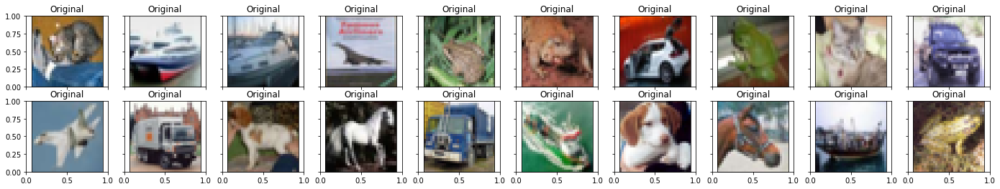

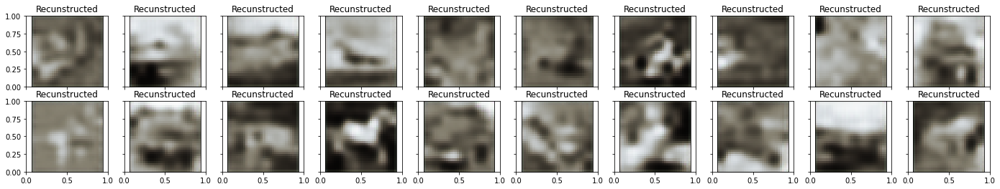


 EPOCH 122/150 	 train loss 0.5788308382034302 	 val loss 0.5786779522895813


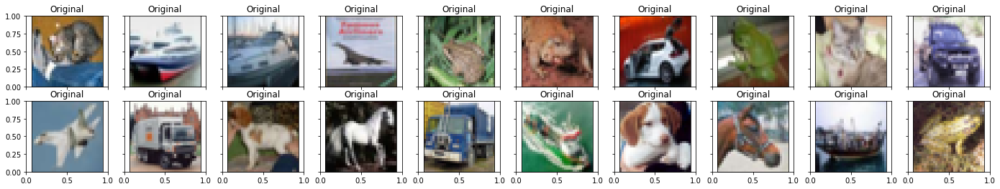

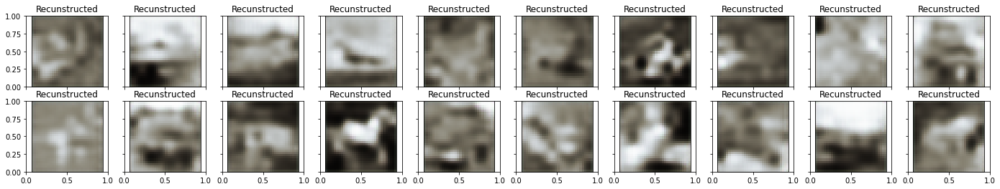


 EPOCH 123/150 	 train loss 0.579153835773468 	 val loss 0.5778841376304626


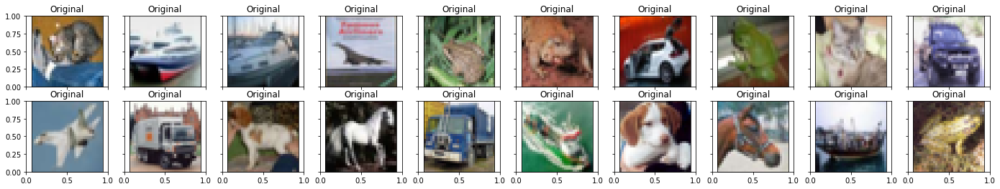

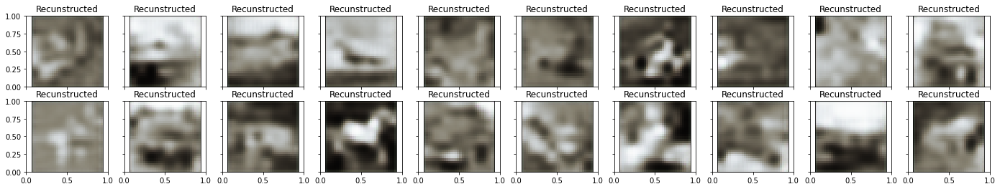


 EPOCH 124/150 	 train loss 0.5796144008636475 	 val loss 0.5791758894920349


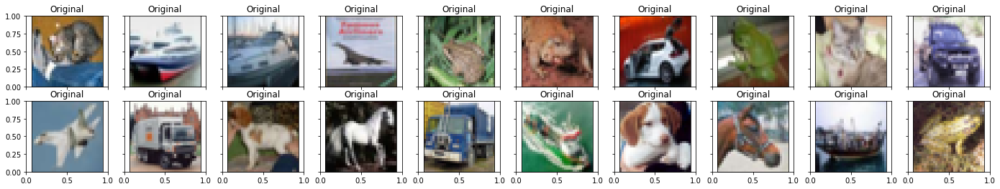

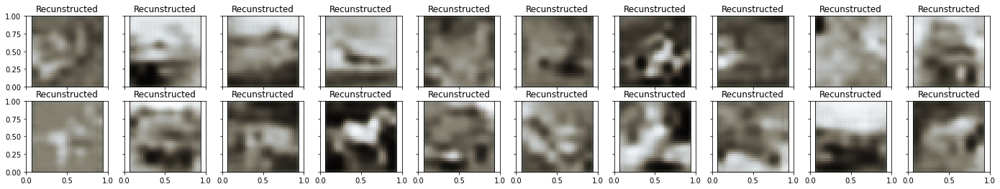


 EPOCH 125/150 	 train loss 0.5790654420852661 	 val loss 0.5778895616531372


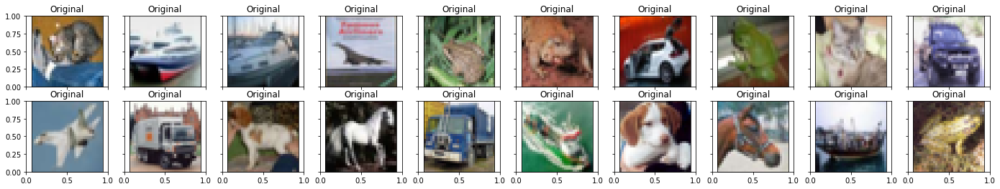

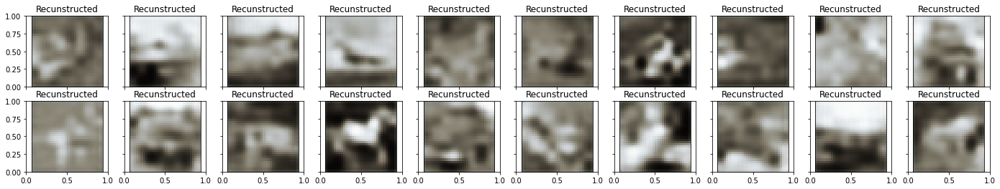


 EPOCH 126/150 	 train loss 0.5787256360054016 	 val loss 0.5785959362983704


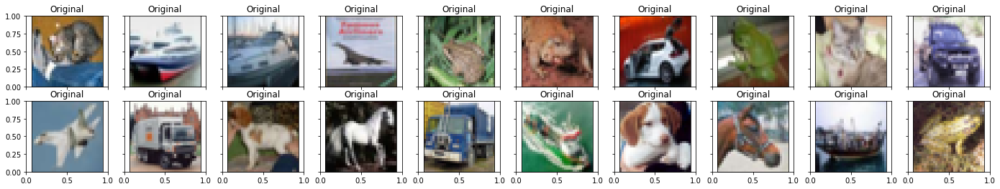

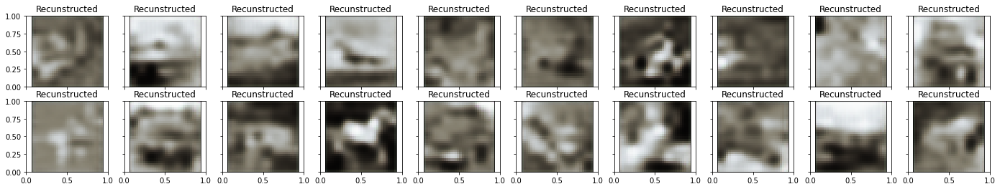


 EPOCH 127/150 	 train loss 0.5798913240432739 	 val loss 0.5781575441360474


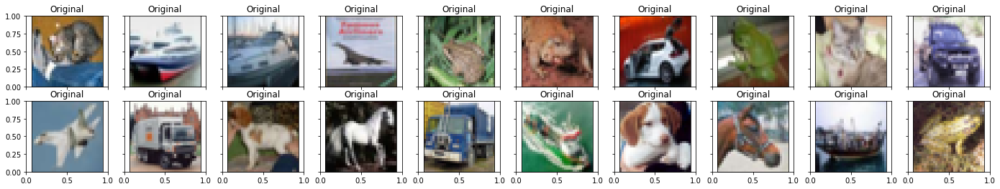

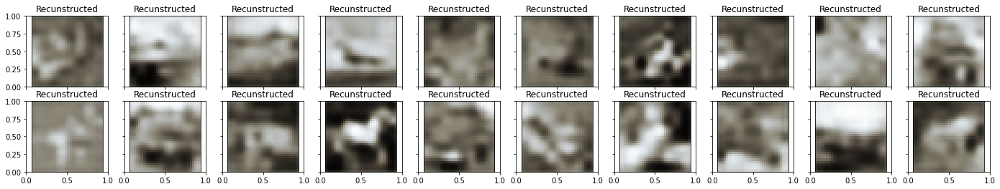


 EPOCH 128/150 	 train loss 0.5797078609466553 	 val loss 0.579207181930542


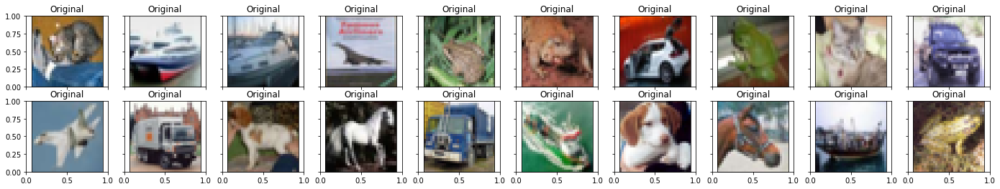

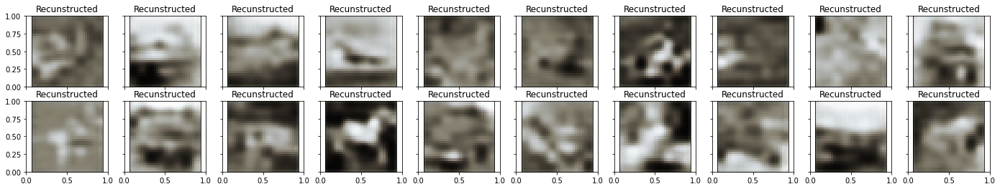


 EPOCH 129/150 	 train loss 0.583342432975769 	 val loss 0.5821602940559387


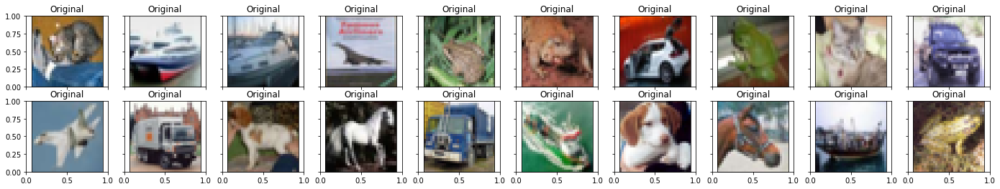

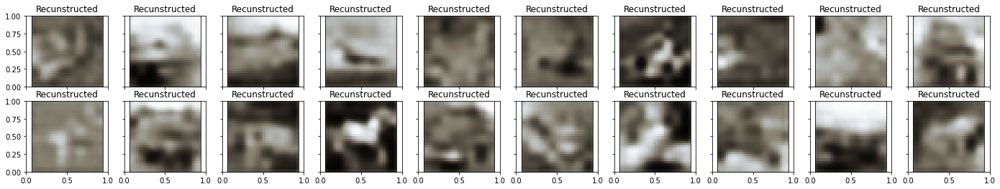


 EPOCH 130/150 	 train loss 0.5838581323623657 	 val loss 0.5802082419395447


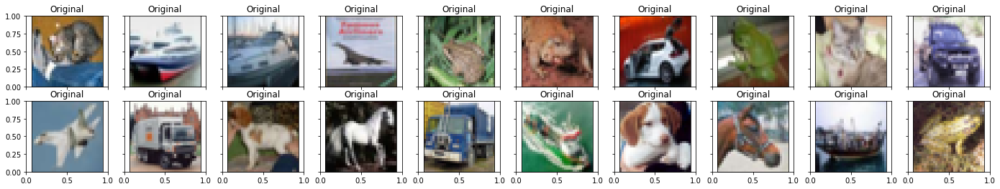

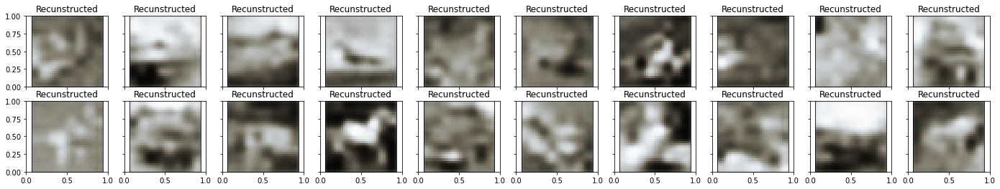


 EPOCH 131/150 	 train loss 0.5845304727554321 	 val loss 0.5820850133895874


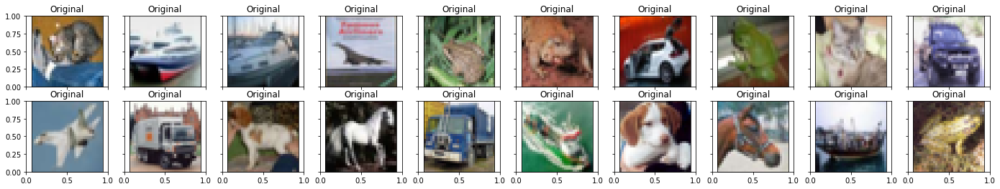

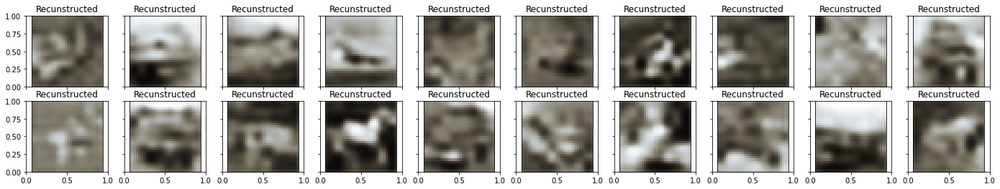


 EPOCH 132/150 	 train loss 0.5861585736274719 	 val loss 0.582138180732727


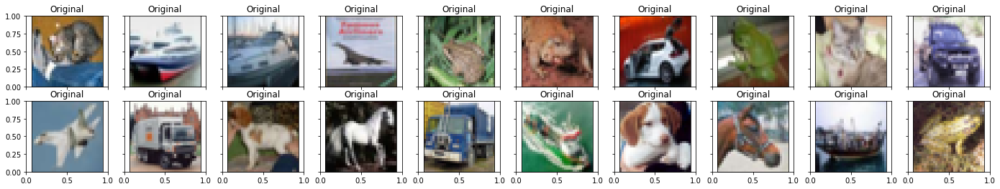

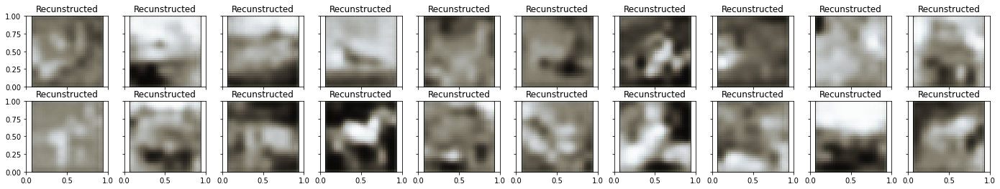


 EPOCH 133/150 	 train loss 0.5878222584724426 	 val loss 0.5794265270233154


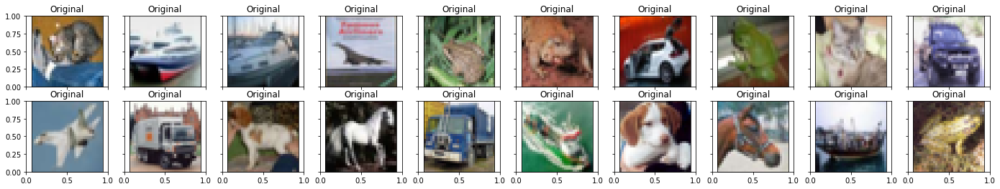

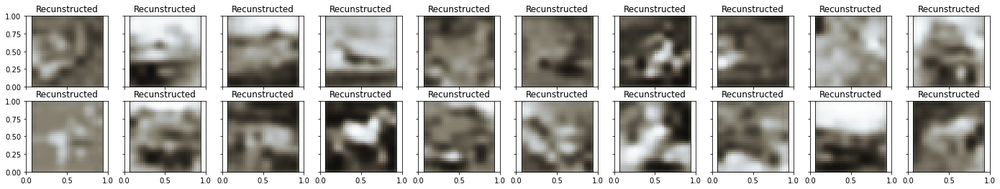


 EPOCH 134/150 	 train loss 0.5839420557022095 	 val loss 0.5816950798034668


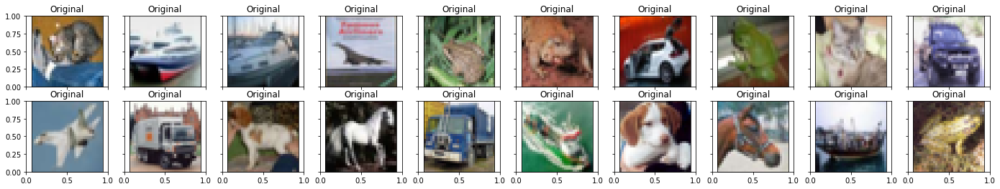

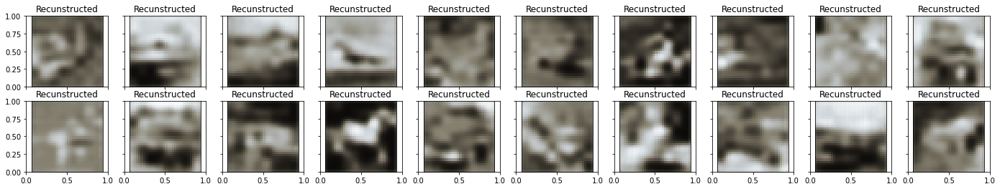


 EPOCH 135/150 	 train loss 0.5824337005615234 	 val loss 0.5872572660446167


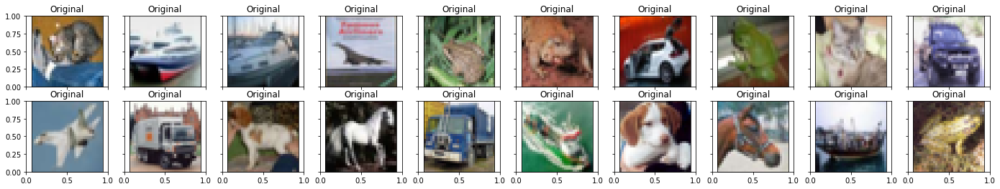

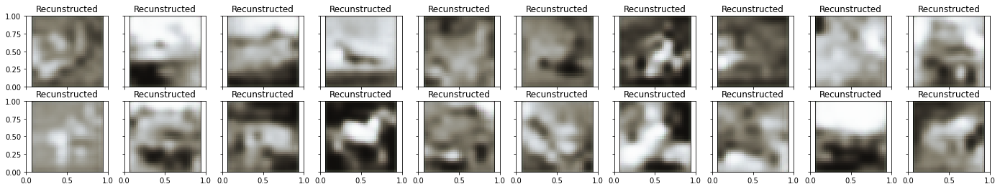


 EPOCH 136/150 	 train loss 0.5801644921302795 	 val loss 0.5841384530067444


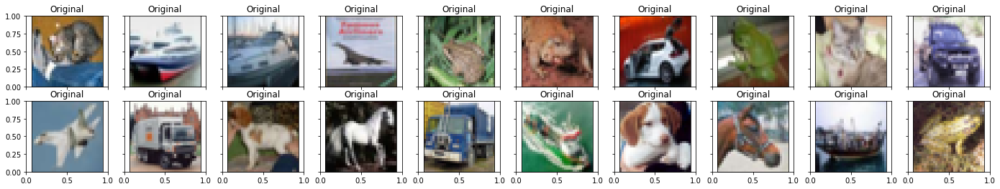

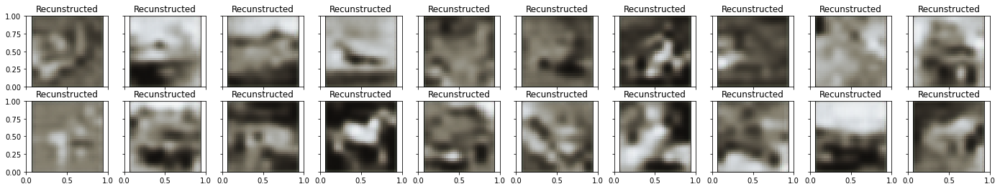


 EPOCH 137/150 	 train loss 0.5813384056091309 	 val loss 0.5851055979728699


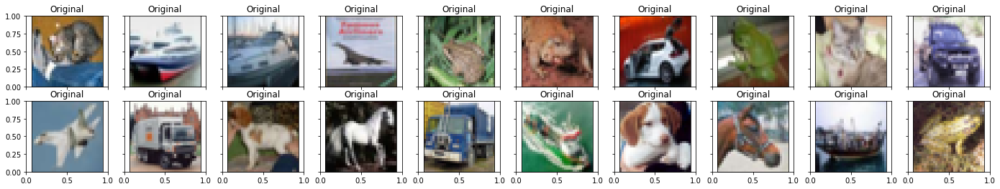

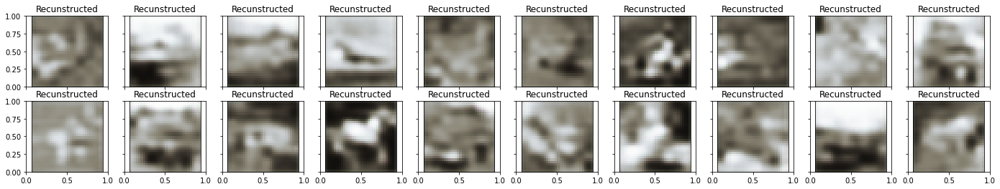


 EPOCH 138/150 	 train loss 0.581086277961731 	 val loss 0.5801407694816589


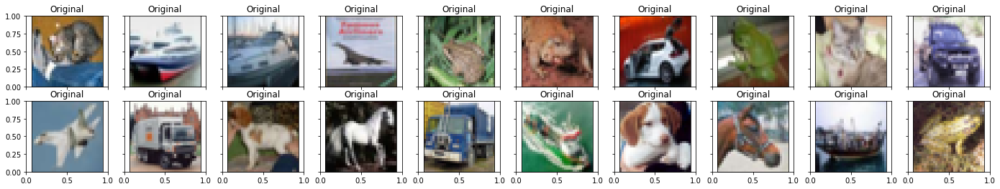

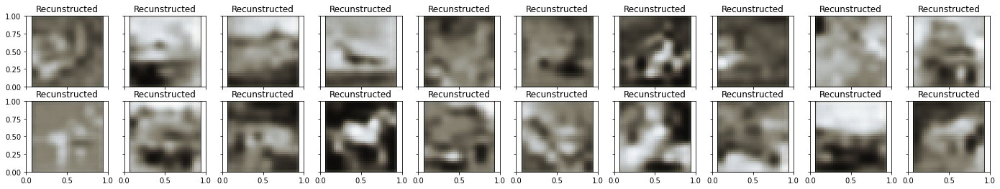


 EPOCH 139/150 	 train loss 0.5819699764251709 	 val loss 0.5842045545578003


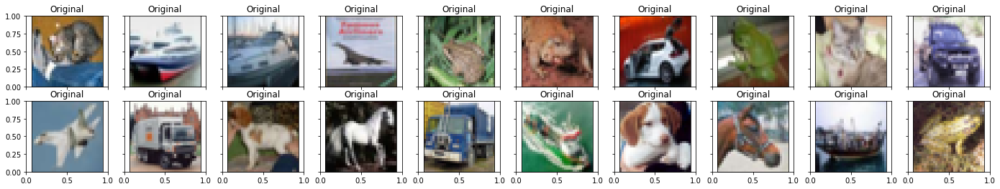

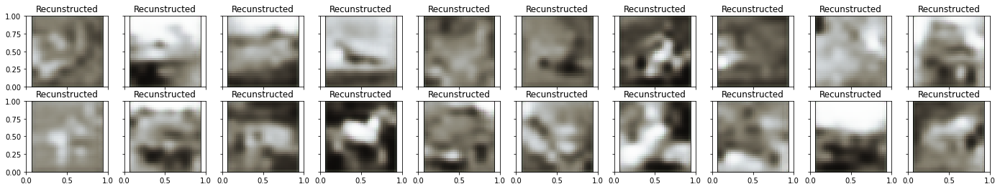


 EPOCH 140/150 	 train loss 0.5858280658721924 	 val loss 0.5785094499588013


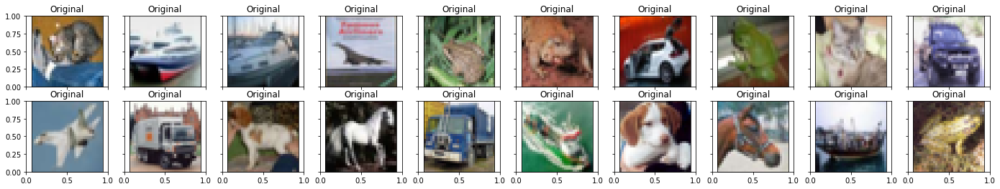

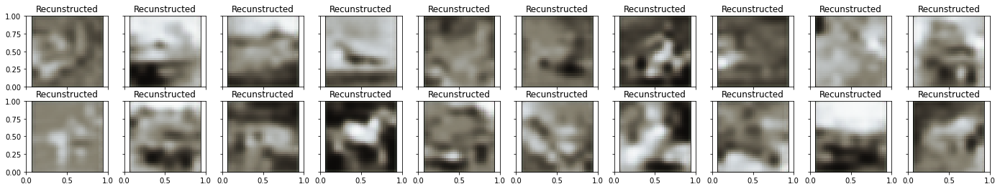


 EPOCH 141/150 	 train loss 0.5814827680587769 	 val loss 0.5793941020965576


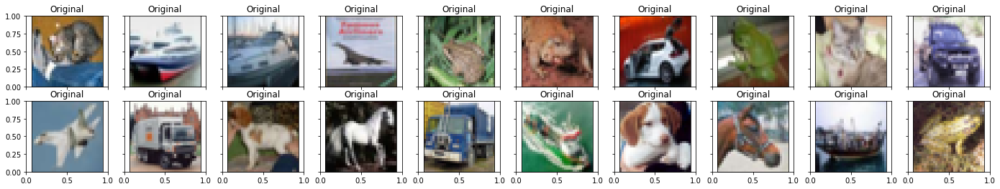

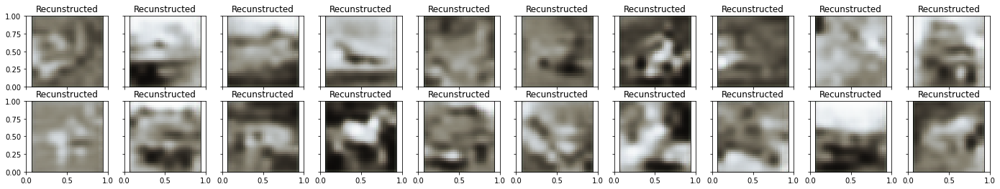


 EPOCH 142/150 	 train loss 0.5804767608642578 	 val loss 0.5795773267745972


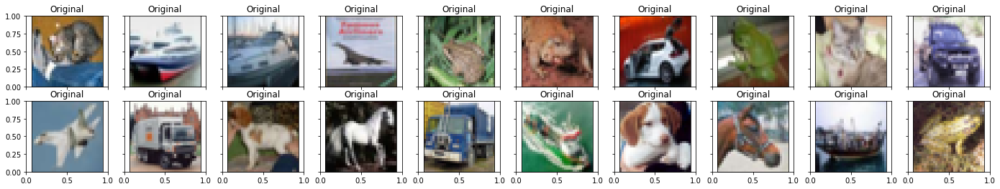

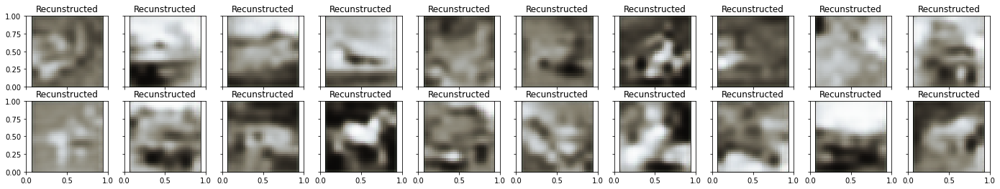


 EPOCH 143/150 	 train loss 0.5843833684921265 	 val loss 0.5789127349853516


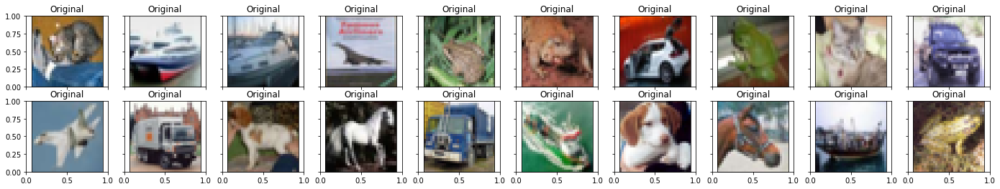

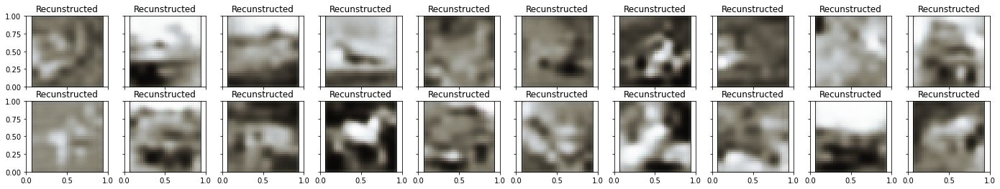


 EPOCH 144/150 	 train loss 0.5811053514480591 	 val loss 0.5789620876312256


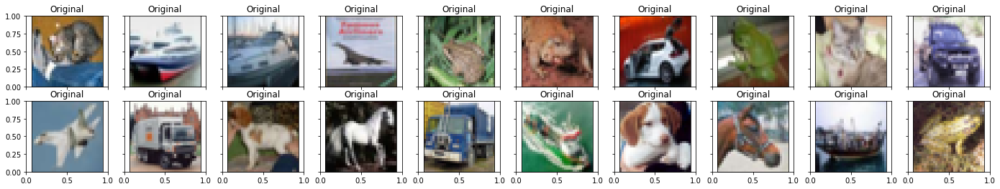

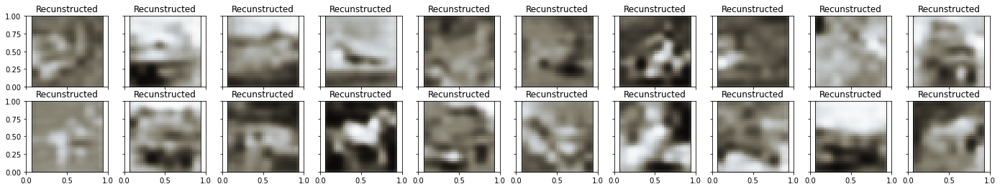


 EPOCH 145/150 	 train loss 0.5845253467559814 	 val loss 0.5777450799942017


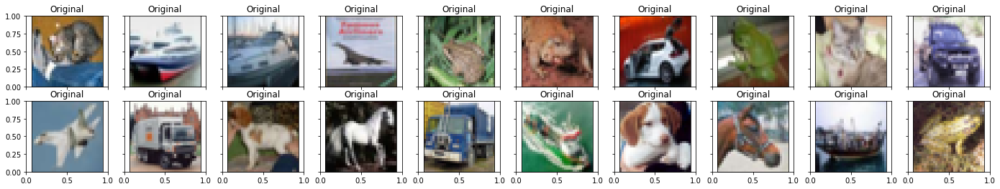

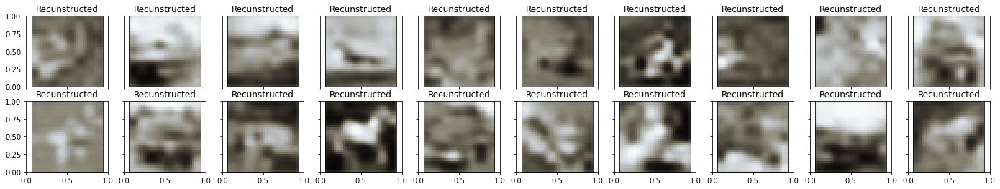


 EPOCH 146/150 	 train loss 0.581061065196991 	 val loss 0.5818708539009094


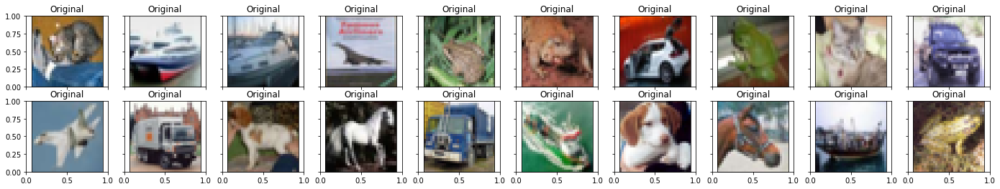

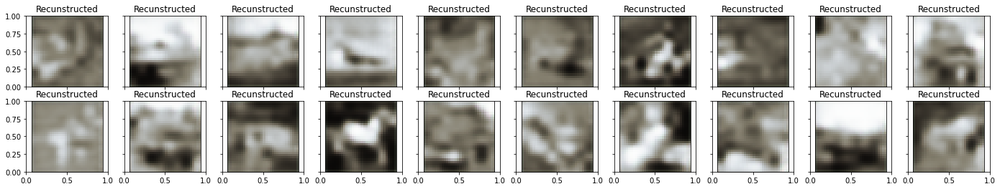


 EPOCH 147/150 	 train loss 0.5835505723953247 	 val loss 0.5779827833175659


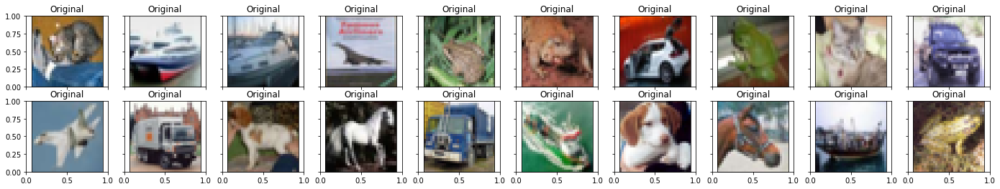

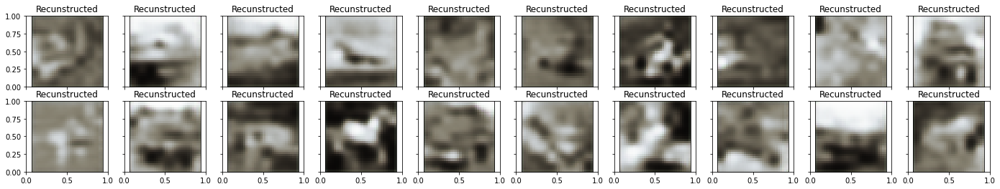


 EPOCH 148/150 	 train loss 0.5801181793212891 	 val loss 0.579651415348053


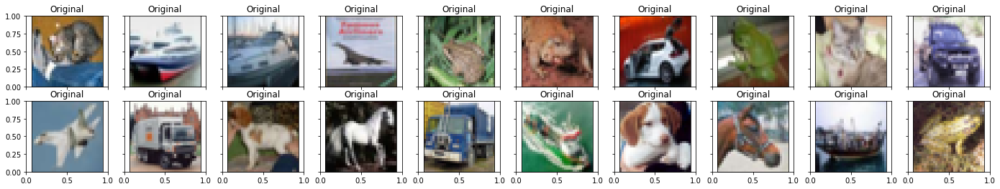

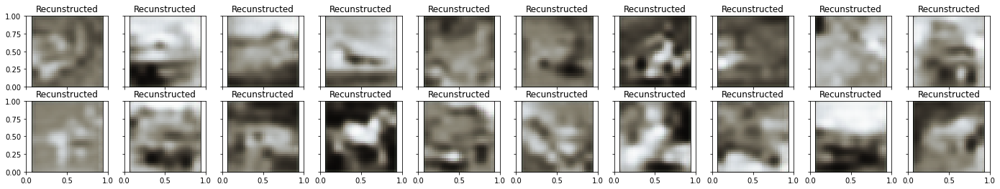


 EPOCH 149/150 	 train loss 0.5788879990577698 	 val loss 0.5793737173080444


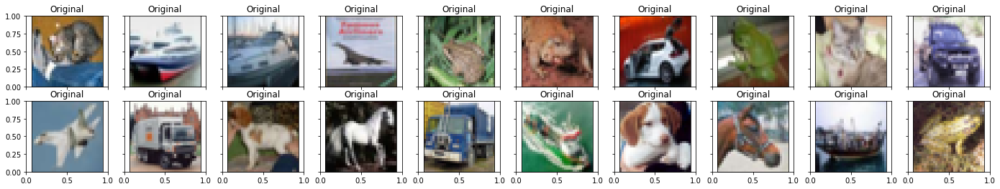

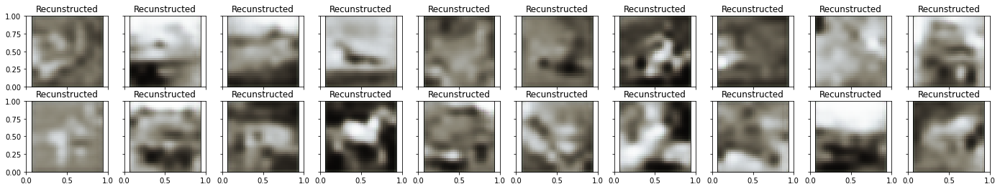


 EPOCH 150/150 	 train loss 0.5815167427062988 	 val loss 0.5794183611869812


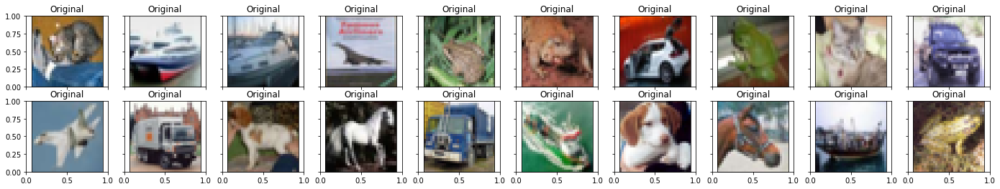

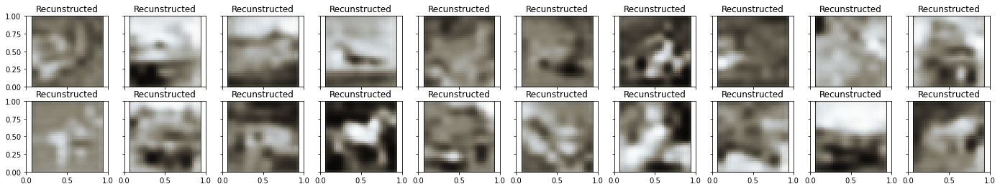

In [ ]:
num_epochs = 150
diz_loss = {'train_loss':[],'val_loss':[]}
for epoch in range(num_epochs):
   train_loss =train_epoch(autoencoder_1,device,
   train_loader,loss_fn,optimizer_1)
   val_loss = test_epoch(autoencoder_1,device,test_loader,loss_fn)
   print('\n EPOCH {}/{} \t train loss {} \t val loss {}'.format(epoch + 1, num_epochs,train_loss,val_loss))
   diz_loss['train_loss'].append(train_loss)
   diz_loss['val_loss'].append(val_loss)
   plot_ae_outputs(autoencoder_1, n=20)


 EPOCH 1/50 	 train loss 0.5759040117263794 	 val loss 0.5755029916763306


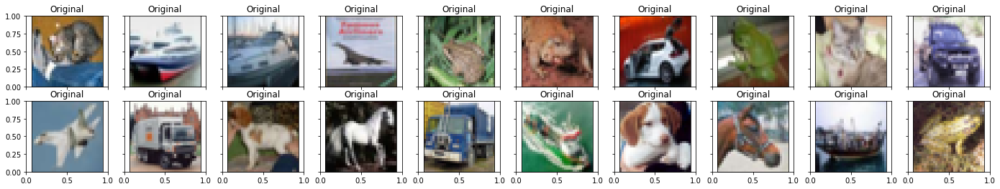

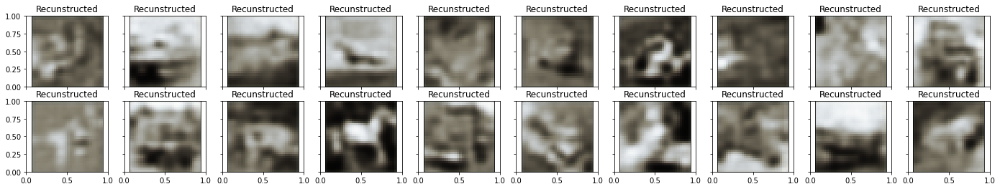


 EPOCH 2/50 	 train loss 0.5760470032691956 	 val loss 0.5742080807685852


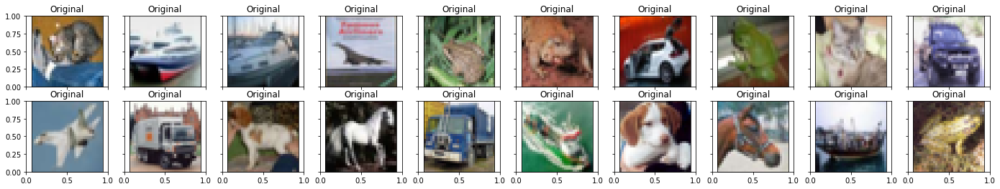

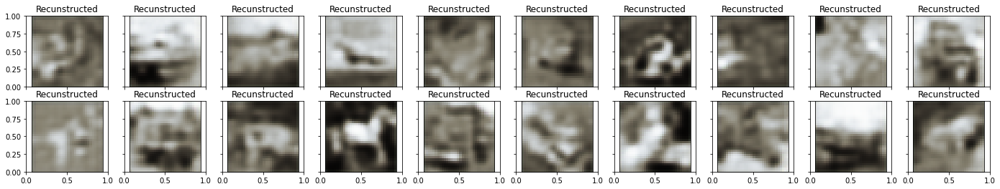


 EPOCH 3/50 	 train loss 0.5744423866271973 	 val loss 0.5742869973182678


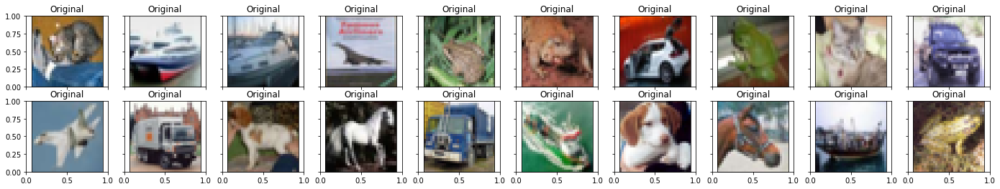

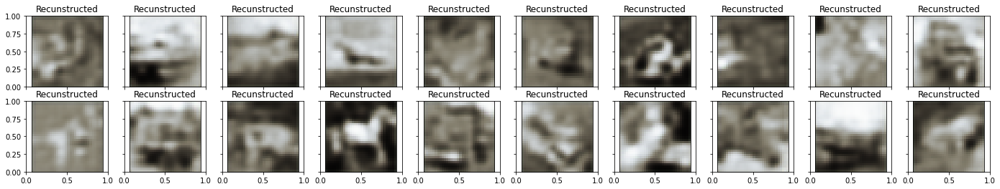


 EPOCH 4/50 	 train loss 0.5753845572471619 	 val loss 0.5738874077796936


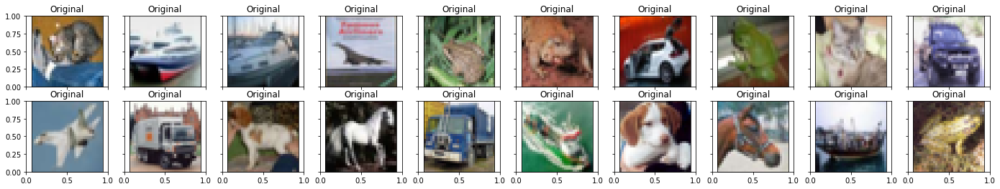

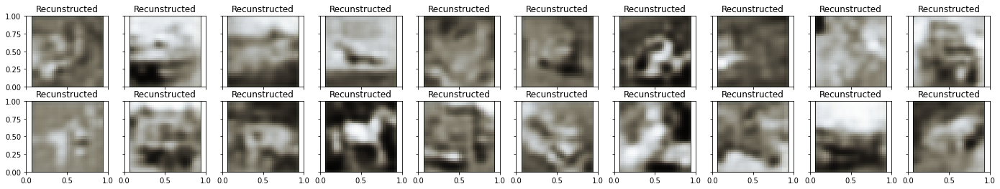


 EPOCH 5/50 	 train loss 0.5742605924606323 	 val loss 0.5743914246559143


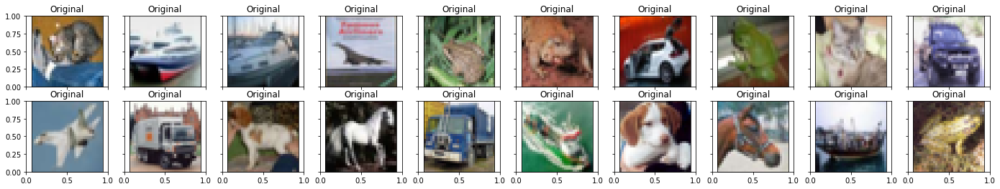

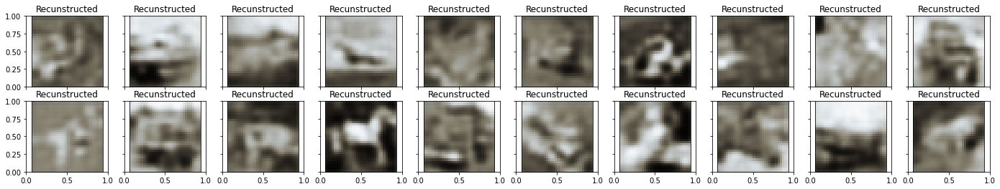


 EPOCH 6/50 	 train loss 0.5753458738327026 	 val loss 0.573810338973999


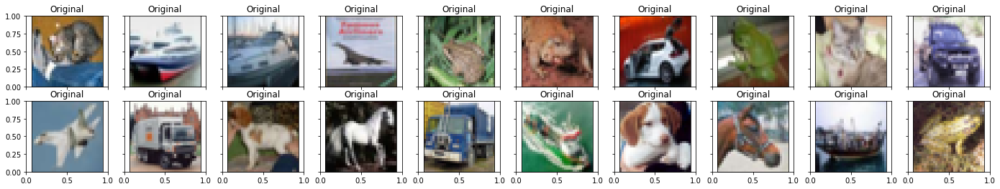

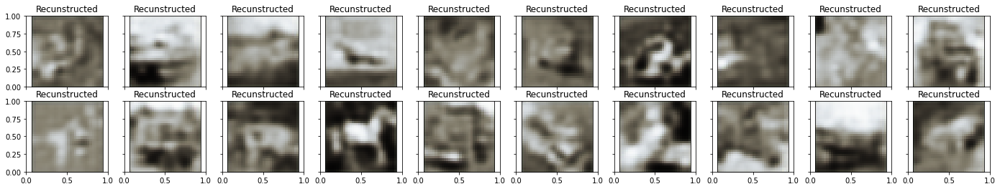


 EPOCH 7/50 	 train loss 0.5743164420127869 	 val loss 0.5738764405250549


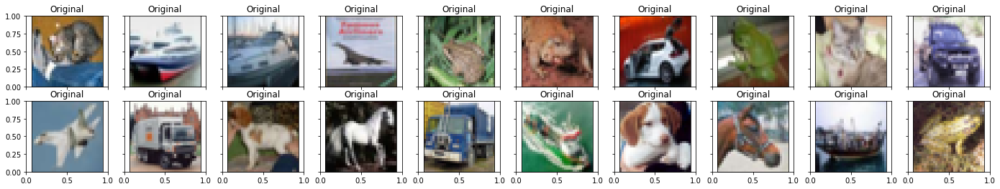

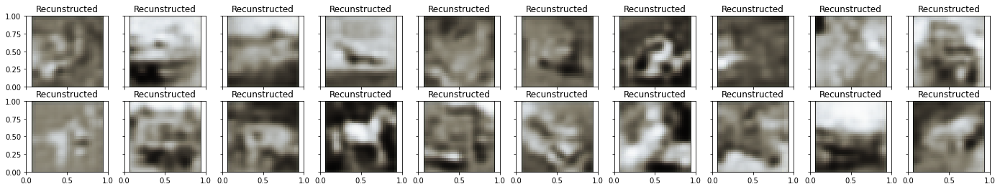


 EPOCH 8/50 	 train loss 0.5739844441413879 	 val loss 0.5739583373069763


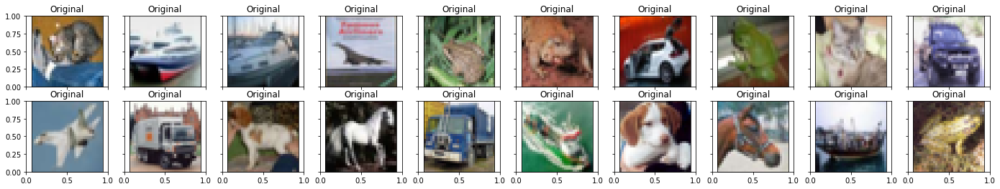

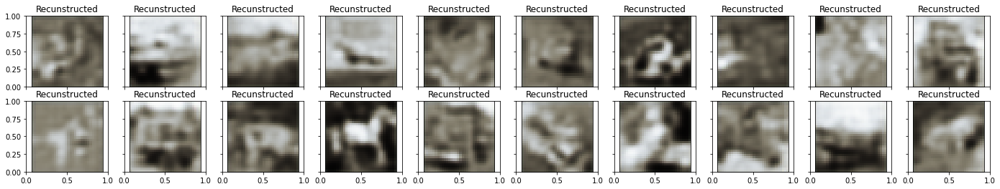


 EPOCH 9/50 	 train loss 0.5740915536880493 	 val loss 0.5736507177352905


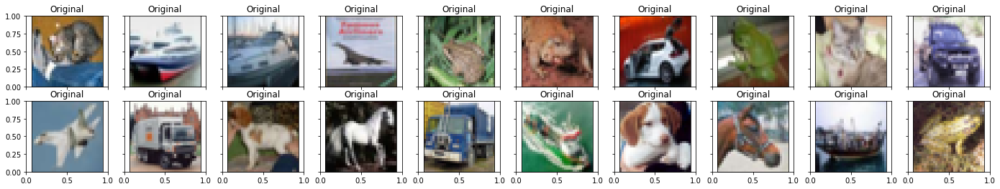

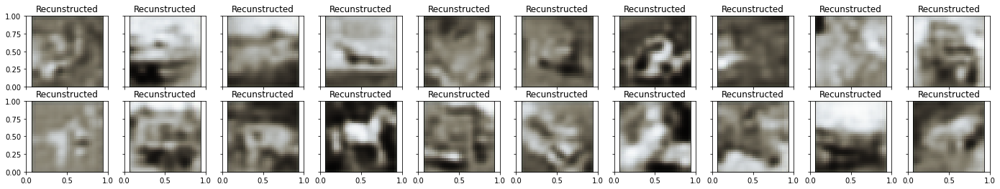


 EPOCH 10/50 	 train loss 0.5735993385314941 	 val loss 0.5733146071434021


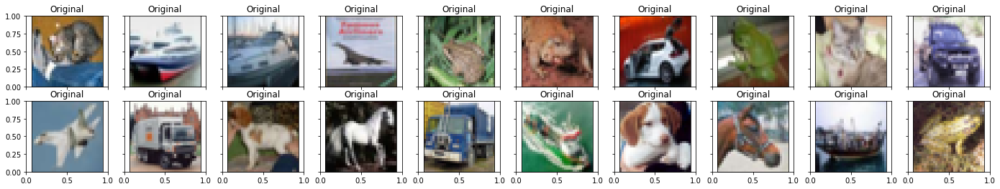

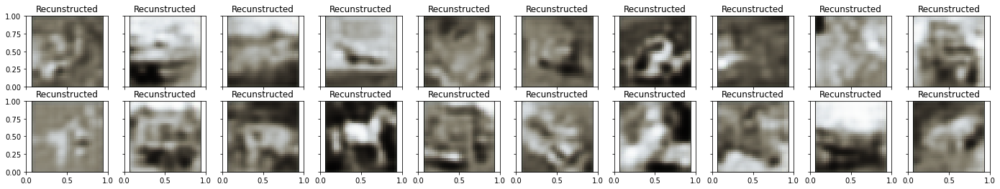


 EPOCH 11/50 	 train loss 0.574212372303009 	 val loss 0.5736829042434692


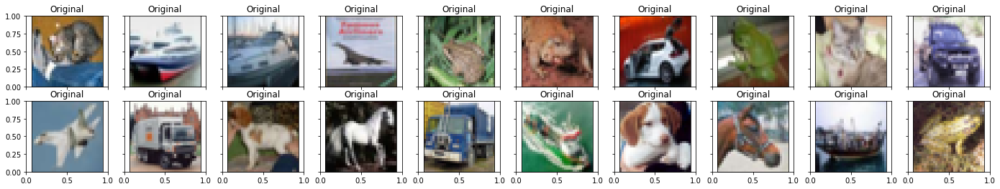

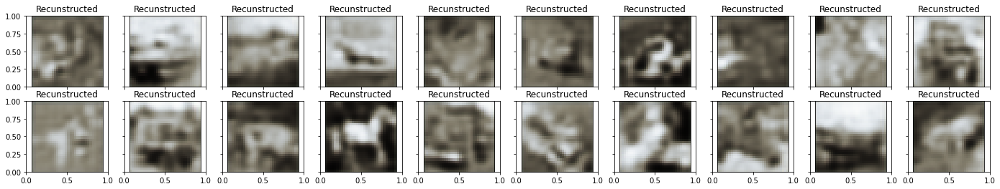


 EPOCH 12/50 	 train loss 0.5738765597343445 	 val loss 0.573702335357666


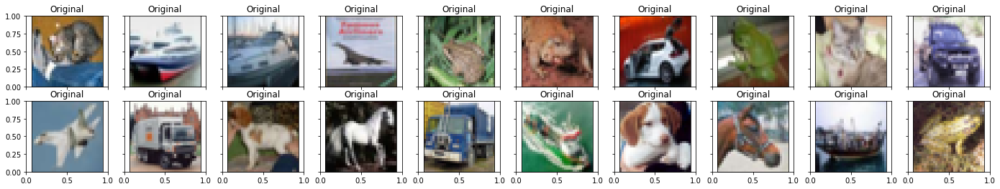

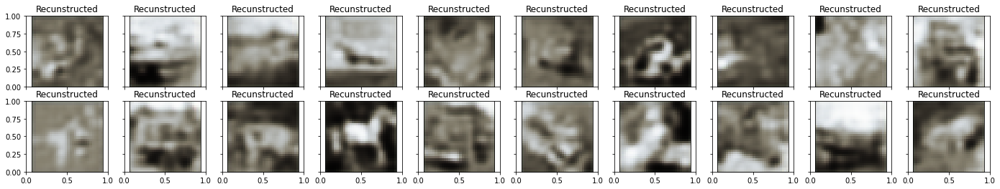


 EPOCH 13/50 	 train loss 0.5747473239898682 	 val loss 0.5741341710090637


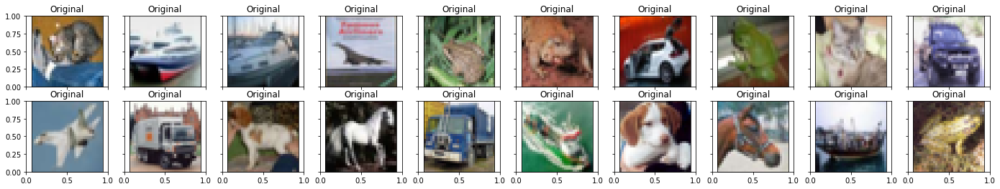

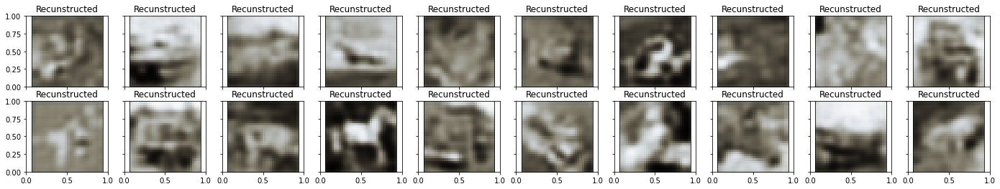


 EPOCH 14/50 	 train loss 0.5745089054107666 	 val loss 0.5736071467399597


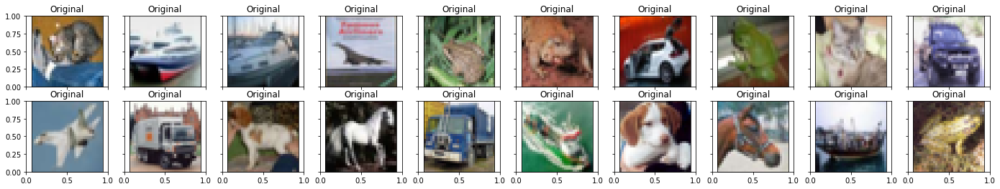

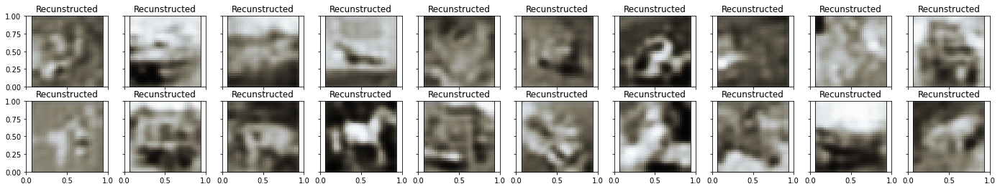


 EPOCH 15/50 	 train loss 0.5750116109848022 	 val loss 0.573742151260376


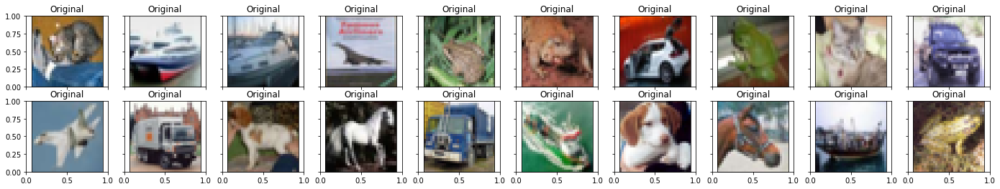

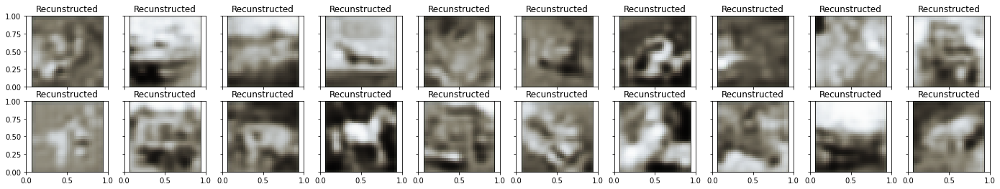


 EPOCH 16/50 	 train loss 0.5751960277557373 	 val loss 0.6001791954040527


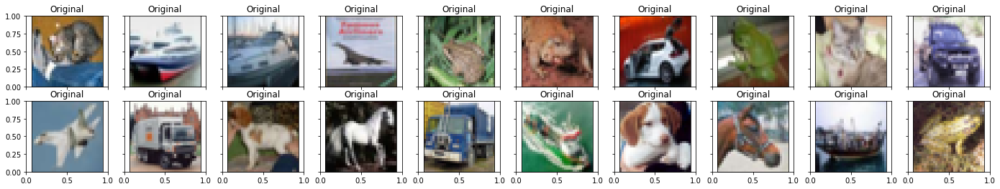

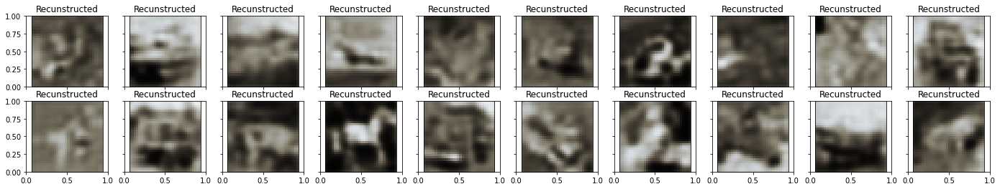


 EPOCH 17/50 	 train loss 0.5785071849822998 	 val loss 0.5933942794799805


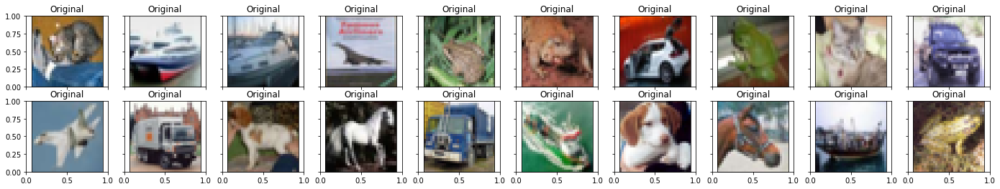

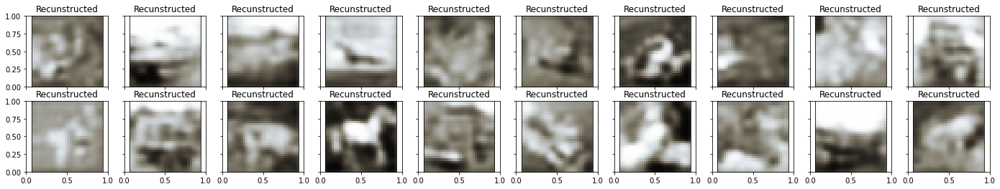


 EPOCH 18/50 	 train loss 0.5812645554542542 	 val loss 0.5798527598381042


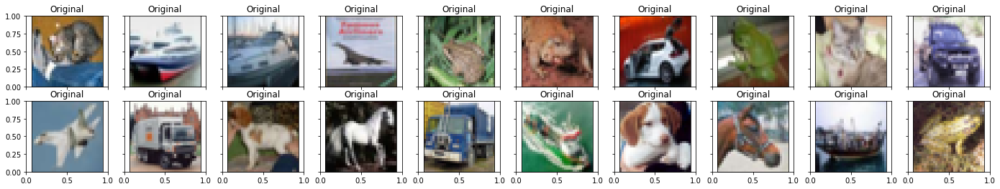

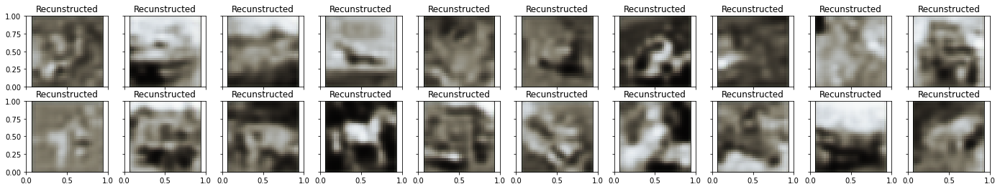


 EPOCH 19/50 	 train loss 0.5760533213615417 	 val loss 0.5802544355392456


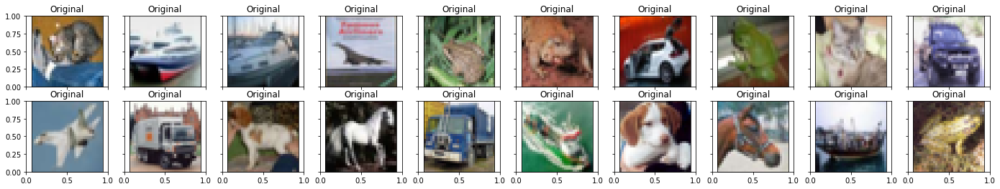

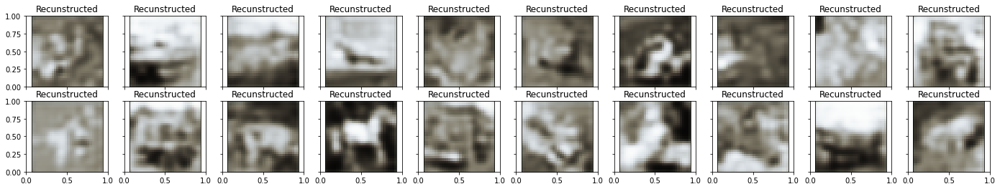


 EPOCH 20/50 	 train loss 0.5750269889831543 	 val loss 0.5874913930892944


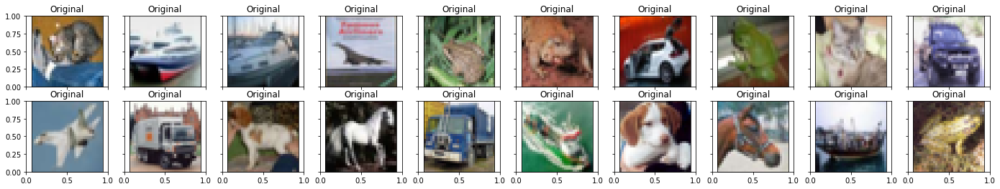

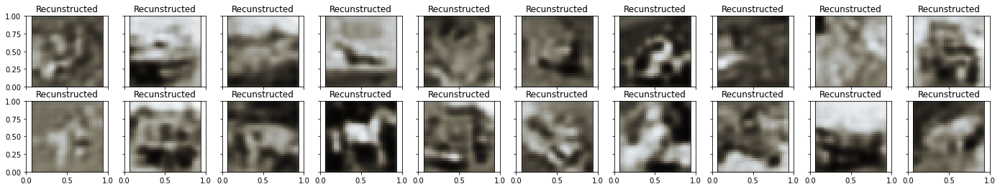


 EPOCH 21/50 	 train loss 0.576616644859314 	 val loss 0.5847273468971252


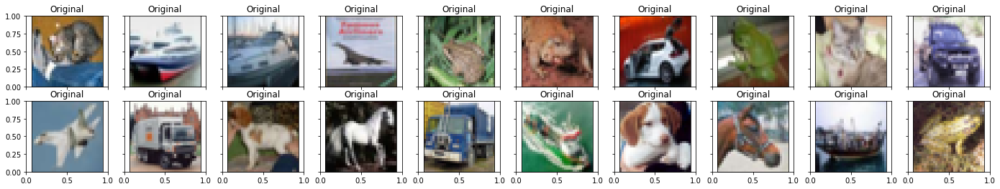

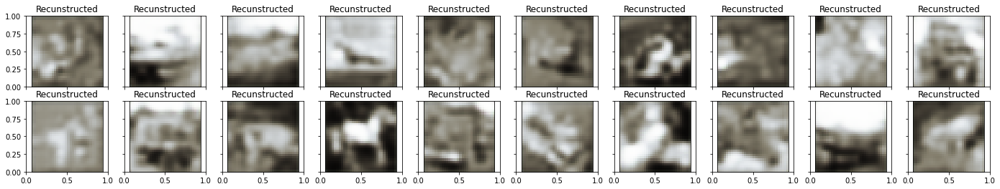


 EPOCH 22/50 	 train loss 0.5777574777603149 	 val loss 0.5760555267333984


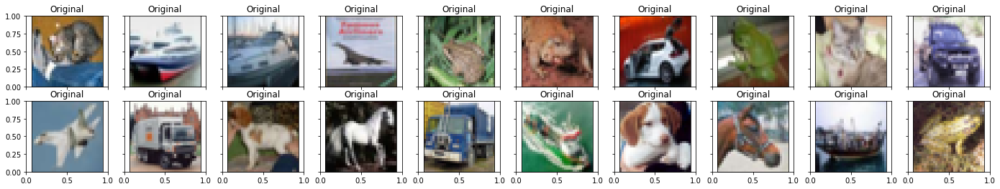

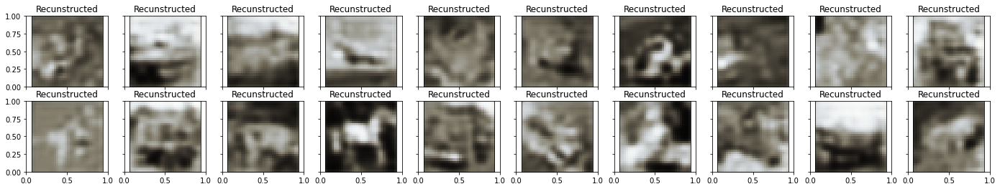


 EPOCH 23/50 	 train loss 0.5751153230667114 	 val loss 0.5738269090652466


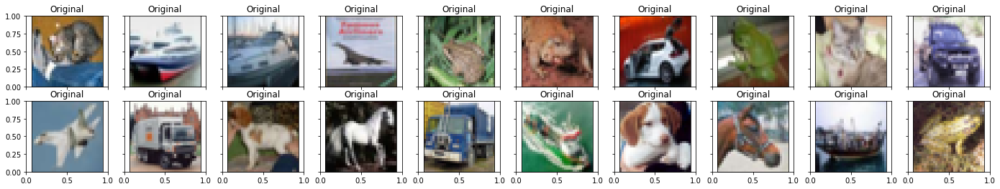

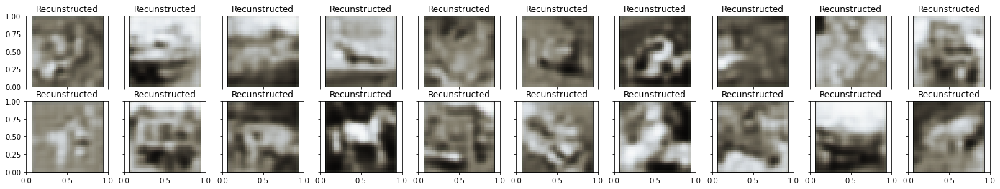


 EPOCH 24/50 	 train loss 0.574891209602356 	 val loss 0.5745710730552673


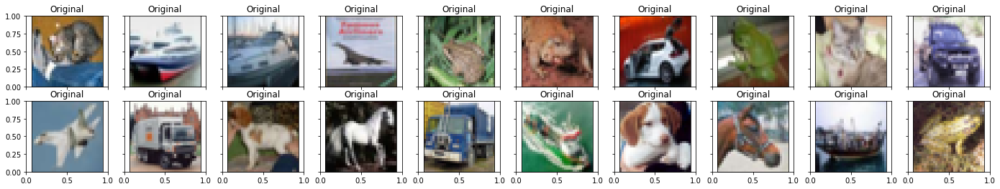

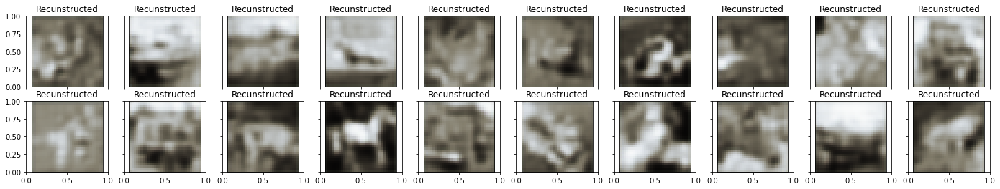


 EPOCH 25/50 	 train loss 0.5743191242218018 	 val loss 0.5749721527099609


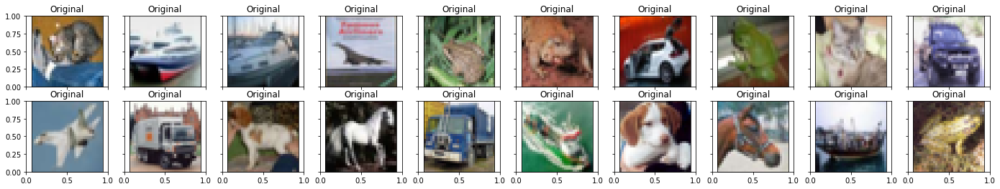

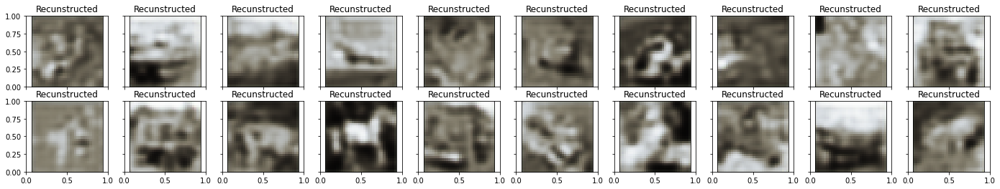


 EPOCH 26/50 	 train loss 0.5741044282913208 	 val loss 0.5737860798835754


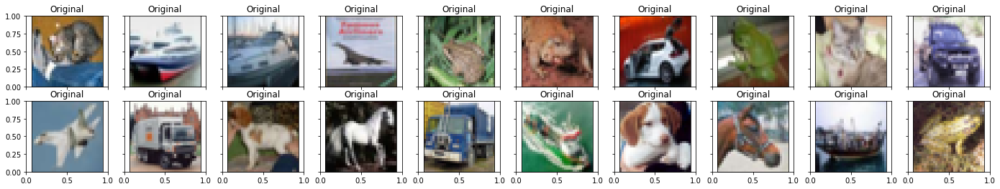

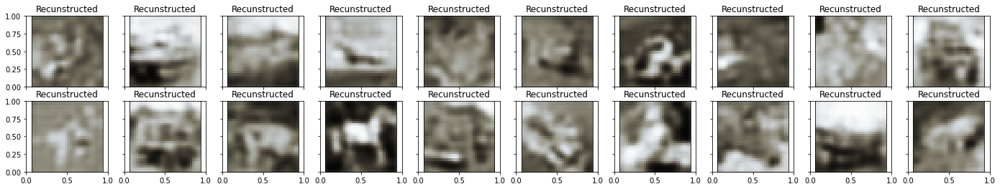


 EPOCH 27/50 	 train loss 0.5743544101715088 	 val loss 0.5730239152908325


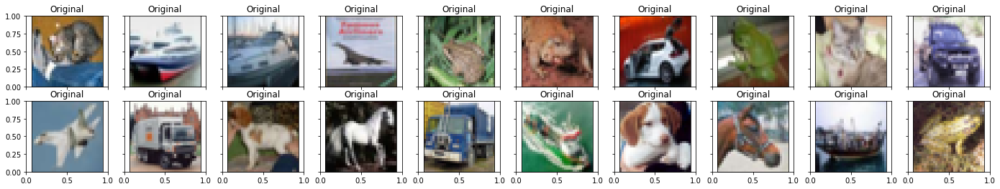

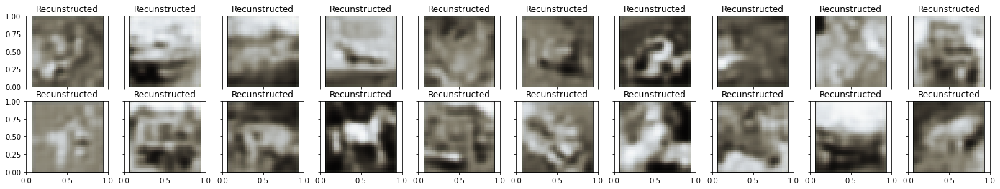


 EPOCH 28/50 	 train loss 0.5731713771820068 	 val loss 0.5729472637176514


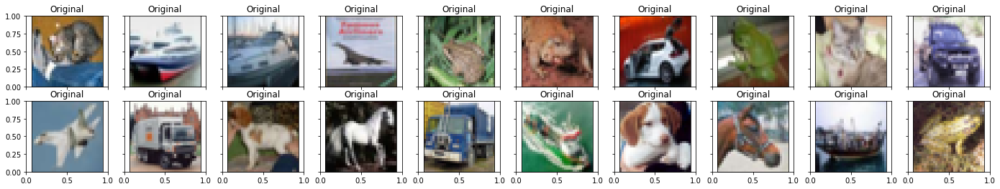

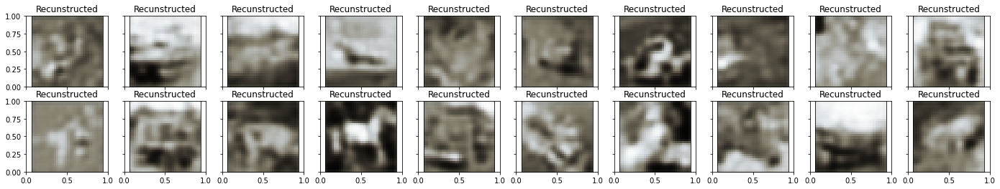


 EPOCH 29/50 	 train loss 0.5735049247741699 	 val loss 0.5731989741325378


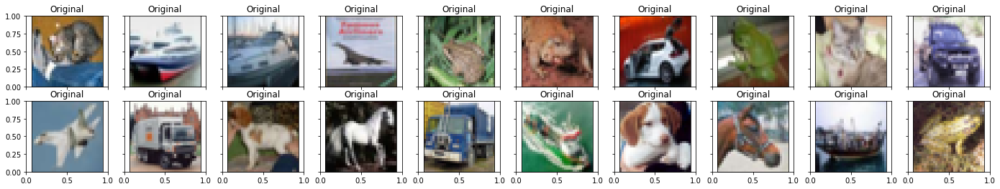

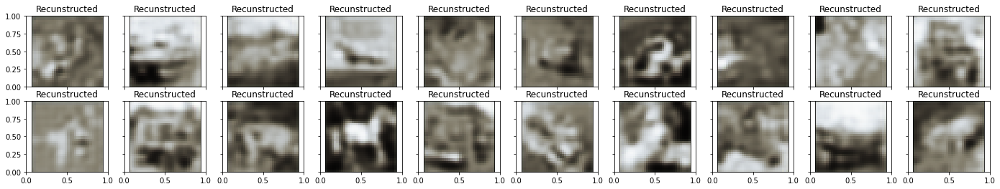


 EPOCH 30/50 	 train loss 0.5732345581054688 	 val loss 0.573101818561554


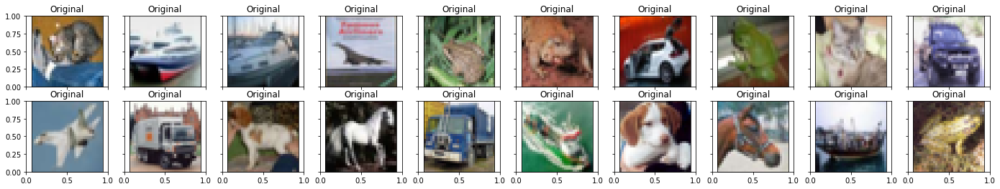

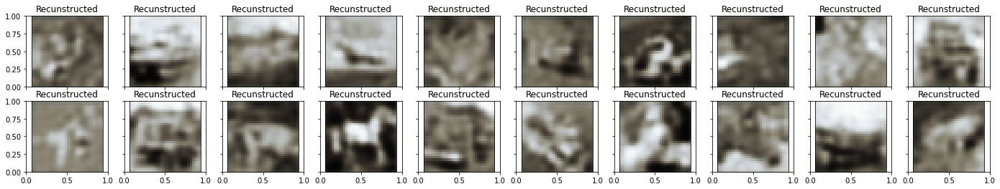


 EPOCH 31/50 	 train loss 0.5730144381523132 	 val loss 0.5740531086921692


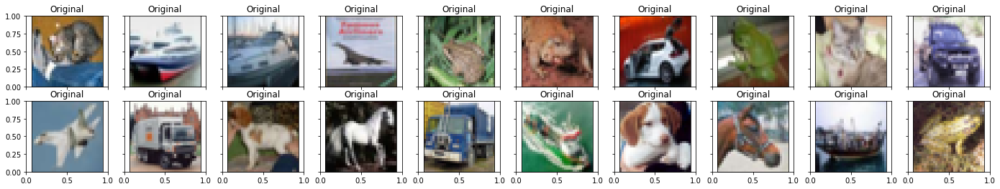

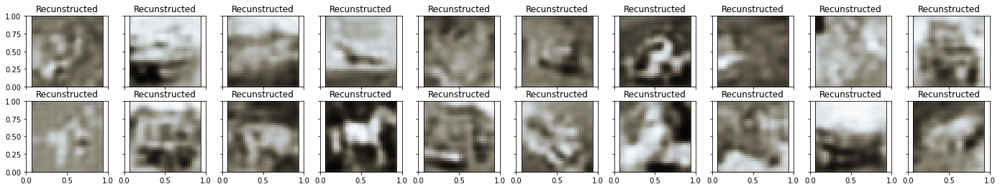


 EPOCH 32/50 	 train loss 0.5734109878540039 	 val loss 0.5734918713569641


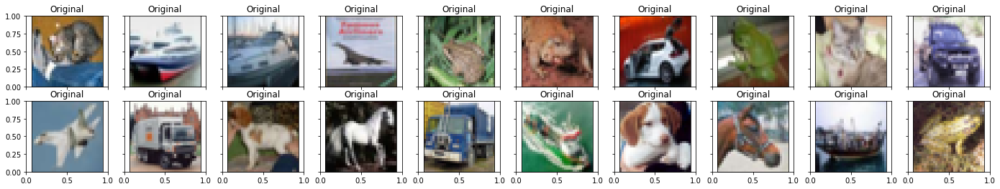

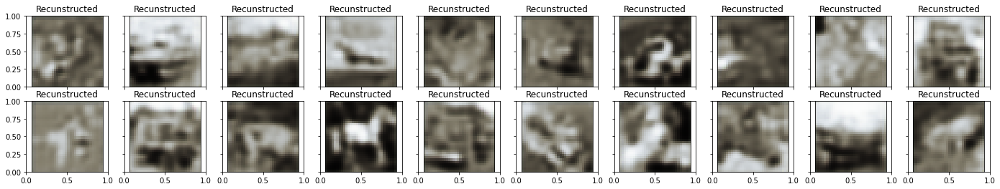


 EPOCH 33/50 	 train loss 0.5730366706848145 	 val loss 0.5732977390289307


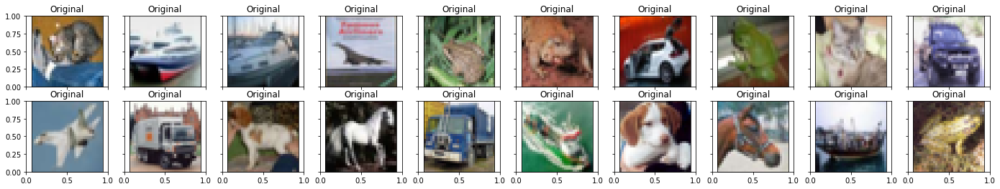

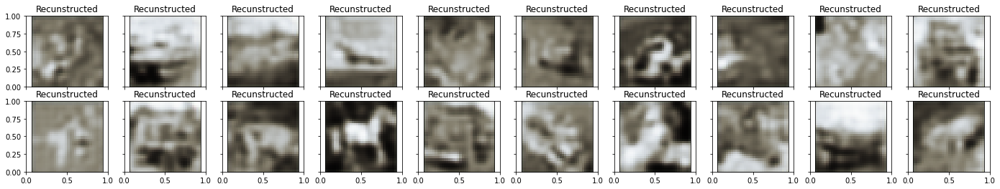


 EPOCH 34/50 	 train loss 0.5731604695320129 	 val loss 0.5725319385528564


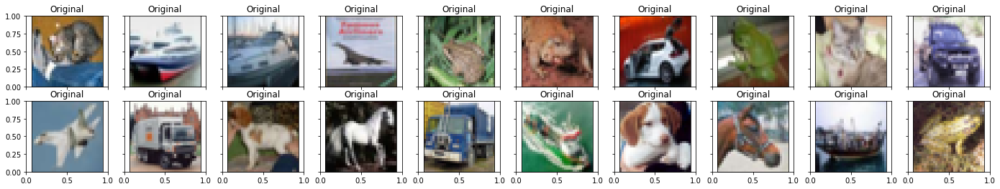

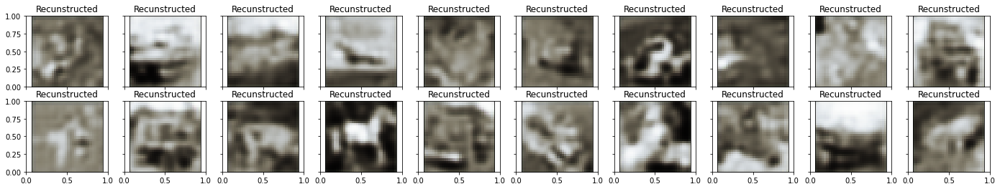


 EPOCH 35/50 	 train loss 0.5725306868553162 	 val loss 0.5730617642402649


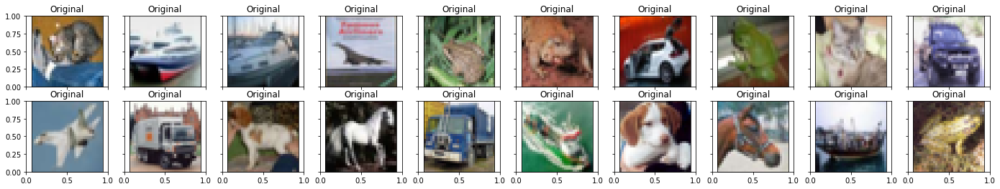

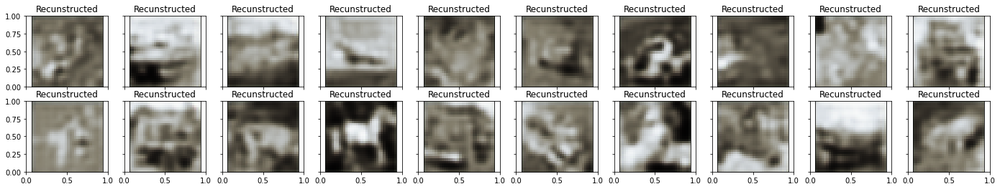


 EPOCH 36/50 	 train loss 0.5727173089981079 	 val loss 0.5731188654899597


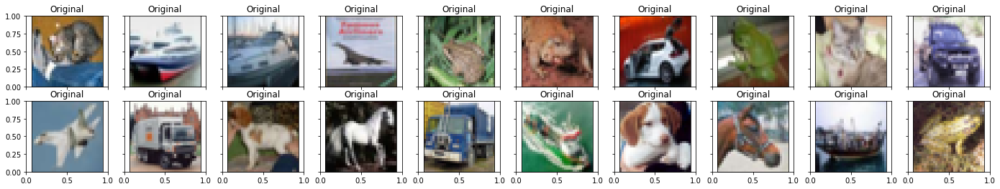

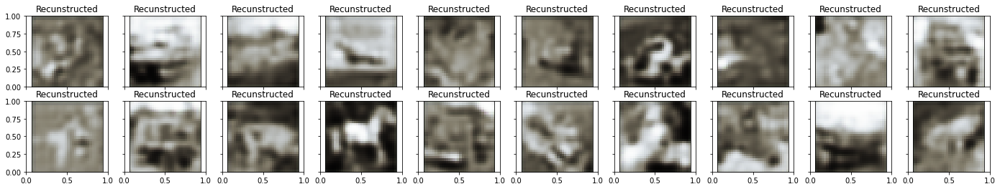


 EPOCH 37/50 	 train loss 0.5743746161460876 	 val loss 0.5726463794708252


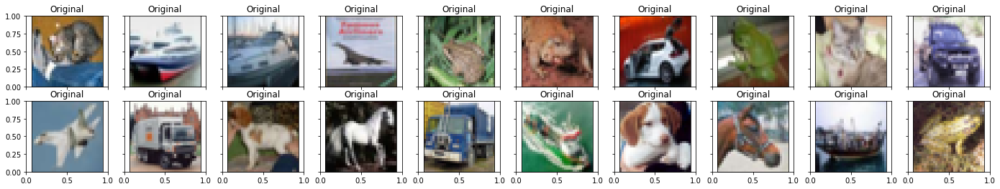

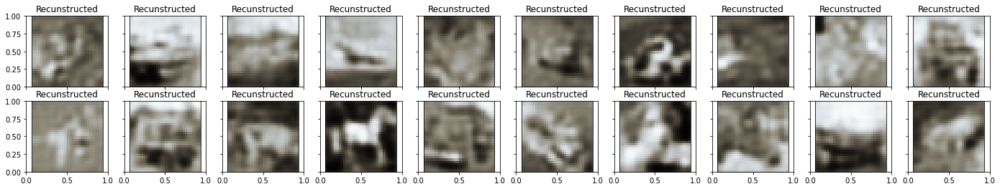


 EPOCH 38/50 	 train loss 0.5730517506599426 	 val loss 0.5808325409889221


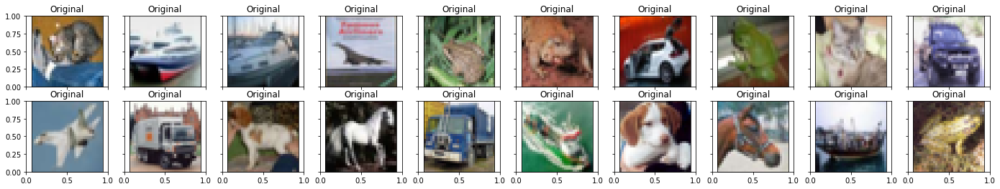

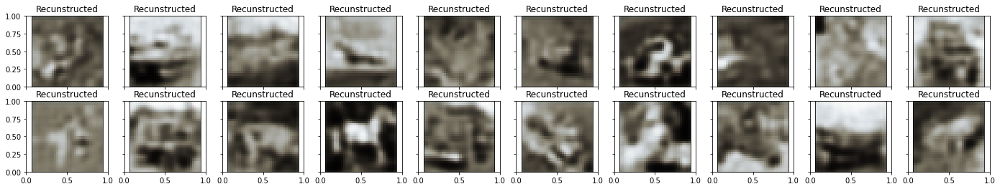


 EPOCH 39/50 	 train loss 0.574072539806366 	 val loss 0.583509624004364


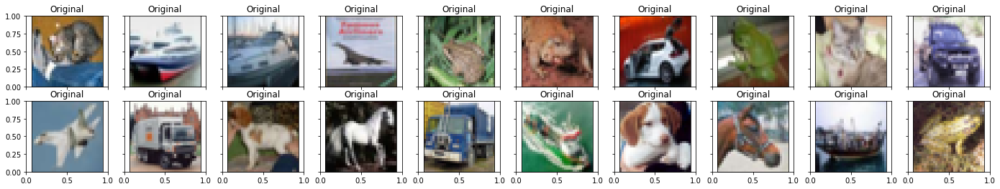

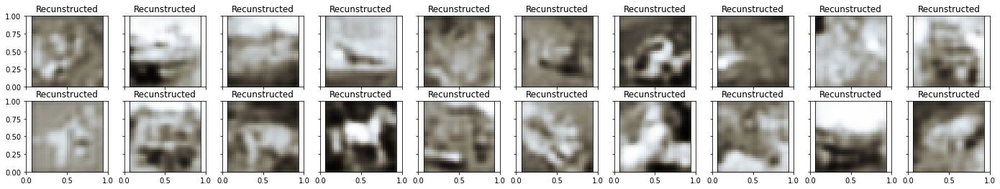


 EPOCH 40/50 	 train loss 0.5755484700202942 	 val loss 0.5728589296340942


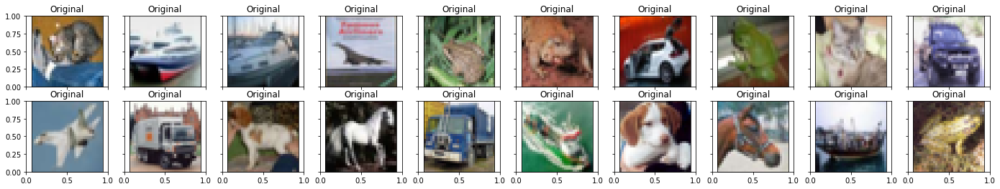

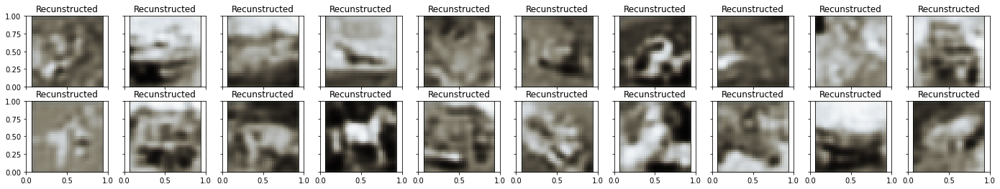


 EPOCH 41/50 	 train loss 0.5739384889602661 	 val loss 0.5730707049369812


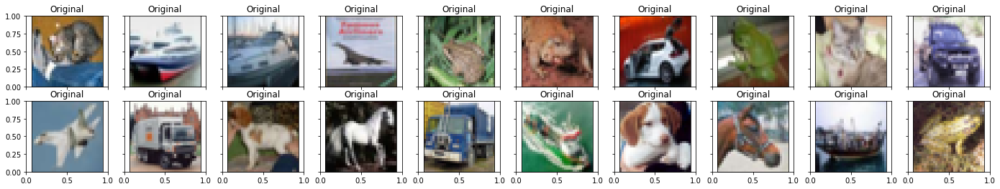

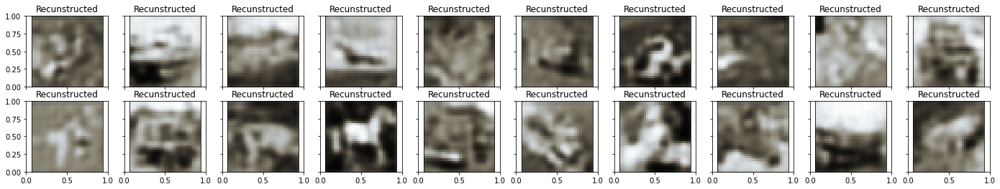


 EPOCH 42/50 	 train loss 0.5742245316505432 	 val loss 0.5729917883872986


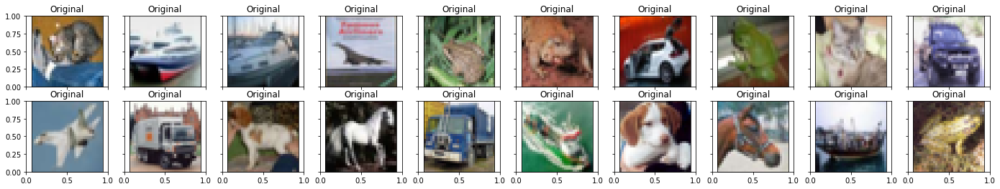

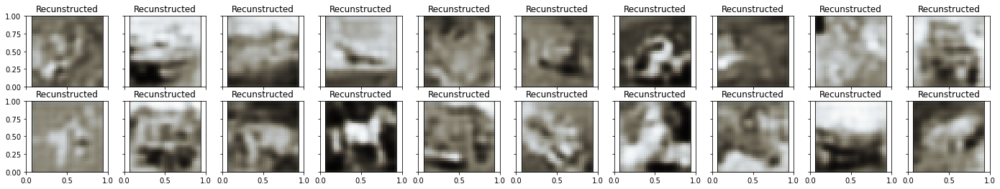


 EPOCH 43/50 	 train loss 0.5727481842041016 	 val loss 0.5823621153831482


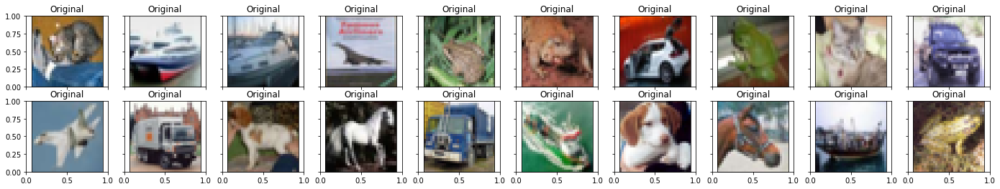

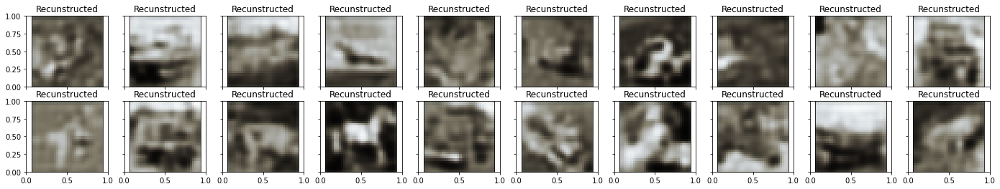


 EPOCH 44/50 	 train loss 0.5739333629608154 	 val loss 0.5916889905929565


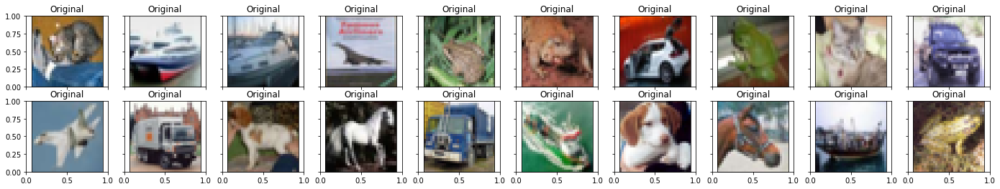

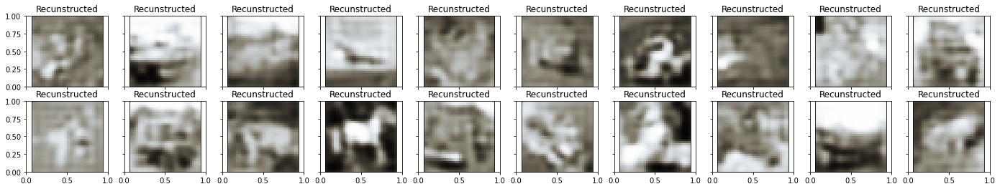


 EPOCH 45/50 	 train loss 0.5750685930252075 	 val loss 0.5978211164474487


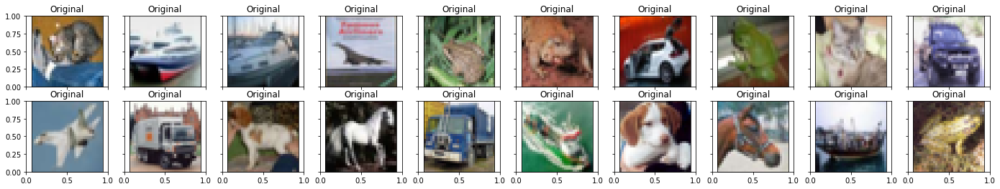

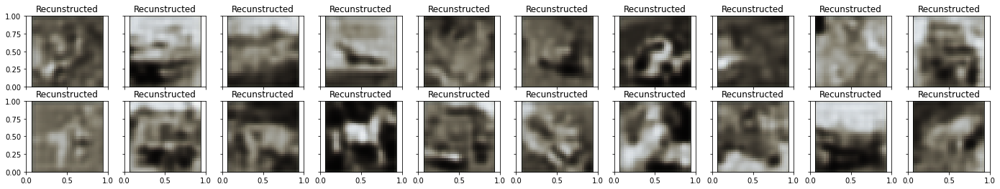


 EPOCH 46/50 	 train loss 0.5739439725875854 	 val loss 0.6017498970031738


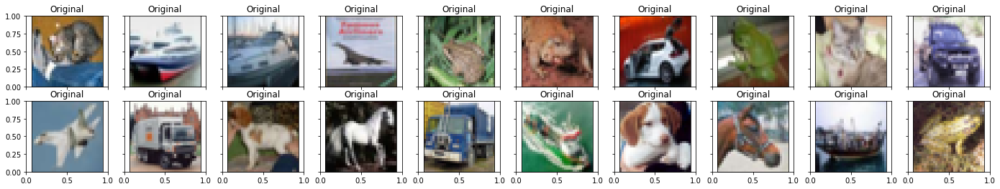

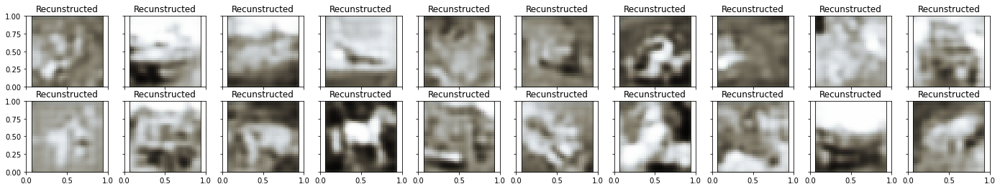


 EPOCH 47/50 	 train loss 0.5754126906394958 	 val loss 0.614956259727478


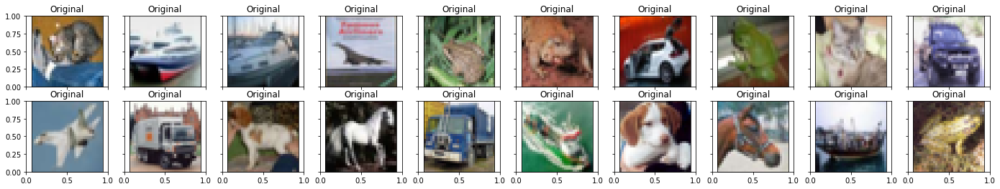

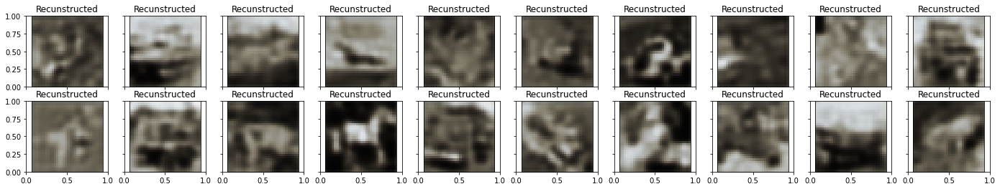


 EPOCH 48/50 	 train loss 0.5770300626754761 	 val loss 0.6041001081466675


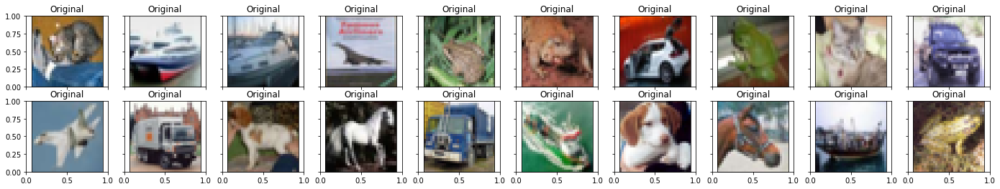

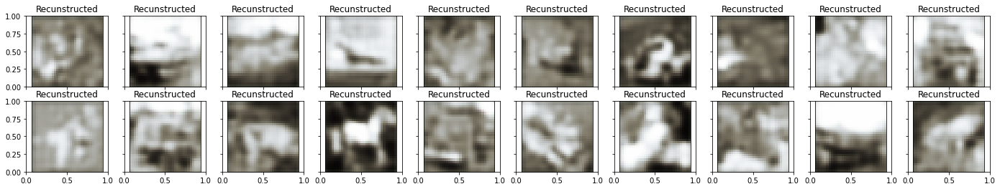


 EPOCH 49/50 	 train loss 0.5774869322776794 	 val loss 0.5739286541938782


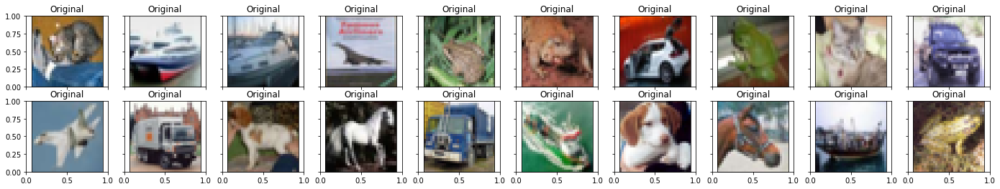

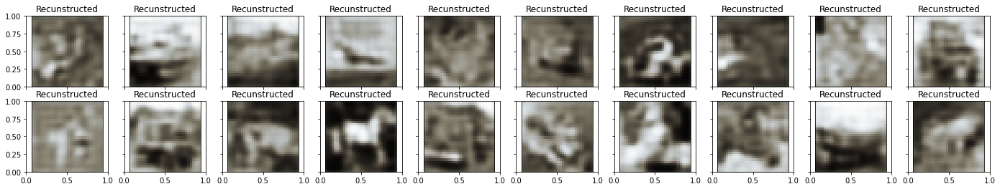


 EPOCH 50/50 	 train loss 0.5746942758560181 	 val loss 0.5820091962814331


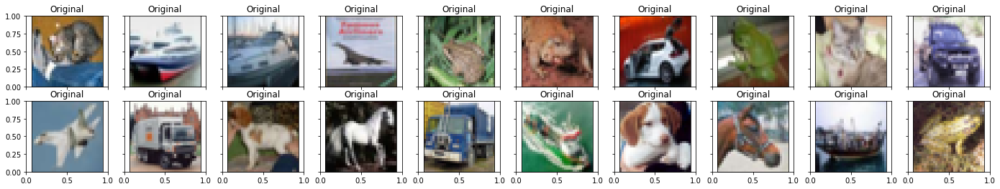

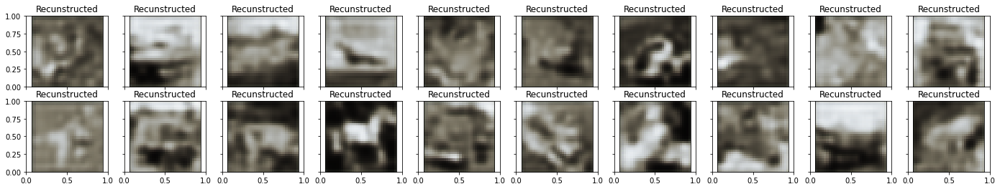

In [ ]:
num_epochs = 50
diz_loss = {'train_loss':[],'val_loss':[]}
for epoch in range(num_epochs):
   train_loss =train_epoch(autoencoder_1,device,
   train_loader,loss_fn,optimizer_1)
   val_loss = test_epoch(autoencoder_1,device,test_loader,loss_fn)
   print('\n EPOCH {}/{} \t train loss {} \t val loss {}'.format(epoch + 1, num_epochs,train_loss,val_loss))
   diz_loss['train_loss'].append(train_loss)
   diz_loss['val_loss'].append(val_loss)
   plot_ae_outputs(autoencoder_1, n=20)

In [ ]:
test_epoch(autoencoder_1,device,test_loader,loss_fn).item()

0.5589856505393982

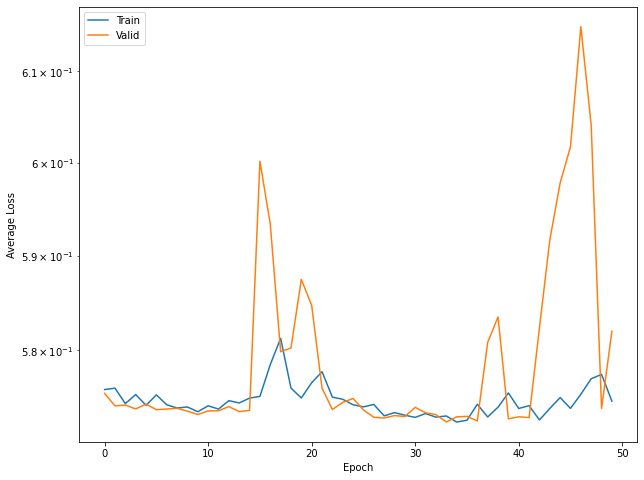

In [ ]:
# Plot losses
plt.figure(figsize=(10,8))
plt.semilogy(diz_loss['train_loss'], label='Train')
plt.semilogy(diz_loss['val_loss'], label='Valid')
plt.xlabel('Epoch')
plt.ylabel('Average Loss')
#plt.grid()
plt.legend()
#plt.title('loss')
plt.show()